## Final Project: Applied Unsupervised Learning
#### Project name: Market Segmentation in Insurance
#### Author: Qichun Yu

## Table of Contents
1. [Introduction](#Abstract)  
    1.1. [Abstract](#Abstract)  
    1.2. [Use Case](#Use-Case)  
    1.3. [Load and Read Data](#Load-and-Read-Data)  
    1.4. [Data Cleaning](#Data-Cleaning)
2. [Analysis and Visualization](#Analysis-and-Visualization)
3. [Preprocessing](#Preprocessing)
4. [Models](#Models)  
    4.1. [K-means Clustering](#K-means-Clustering)  
    4.2. [Hierarchical Clustering](#Hierarchical-Clustering)  
    4.3. [Density-Based Spatial Clustering of Applications with Noise (DBSCAN)](#Density-Based-Spatial-Clustering-of-Applications-with-Noise-(DBSCAN))  
5. [Dimensionality Reduction (PCA)](#Dimensionality-Reduction)  
    5.1. [PCA K-means](#PCA-K-means)    
    5.2. [PCA Hierarchical Clustering](#PCA-Hierarchical-Clustering)  
    5.3. [PCA DBSCAN](#PCA-DBSCAN)  
6. [Dimensionality Reduction (TSNE)](#T-Distributed-Stochastic-Neighbor-Embedding-(TSNE))  
    6.1. [TSNE K-means](#TSNE-K-means)    
    6.2. [TSNE Hierarchical Clustering](#TSNE-Hierarchical-Clustering)  
    6.3. [TSNE DBSCAN](#TSNE-DBSCAN)  
7. [Discussion](#Discussion)
8. [Conclusion](#Conclusion)

### Abstract

The project is developing **unsupervised machine-learning models** to group customers into segments for the purpose to give insurance product recommendations. Customers are divided into subgroups based on some types of similar characteristics. The dataset includes summary information on 18 behavioural variables from the 8,950 active credit cardholders. Behaviours include how a customer spends and pays over time. The notebook explores different unsupervised algorithms such as **k-means, hierarchical clustering, and DBSCAN** for an insurance company to divide customers into groups to optimize marketing campaigns for insurance products. Standardization is used to rescale data to have a mean of 0 and a standard deviation of 1.  **PCA and TSNE** methods are used for dimensionality reduction and visualization.  After comparing with the silhouette score and visualized plots, the optimal model is the k-means method with a k value of three that is trained with PCA scaled data. There are small groups of people who have similar behaviours on purchasing, cash advances, credit limits and so on. The K-means clustering method helps identify the group that has similar features. After the segmentation, an insurance company will provide insurance product recommendations based on their characteristics. 

### Use Case
The insurance industry is competitive. Building strong relationships with customers and maintaining customer engagement outside a claim or a renewal is important. An insurance company is developing a machine learning model to classify customers to provide recommendations on insurance products. Customer segmentation is dividing customers into different groups that have similar characteristics, needs, or goals. The insurance company can offer various products such as saving plans, loans, wealth management and so on to different segments. A successful machine learning model can help the company optimize marketing campaigns, identify new opportunities, and increase customer retention rates. 

### Dataset

The sample Dataset summarizes the usage behavior of about 8,950 active credit cardholders during the last 6 months. The file is at a customer level with 18 behavioral features:
<ol>
    <li>CustID</li>
<li>Balance</li>
<li>Balance Frequency</li>
<li>Purchases</li>
<li>One-off Purchases</li>
<li>Installment Purchases</li>
<li>Cash Advance</li>
<li>Purchases Frequency</li>
<li>One-off Purchases Frequency</li>
<li>Purchases Installments Frequency</li>
<li>Cash Advance Frequency</li>
<li>Cash Advance TRX</li>
<li>Purchases TRX</li>
<li>Credit Limit</li>
<li>Payments</li>
<li>Minimum Payments</li>
<li>PRC Full payment</li>
<li>Tenure</li>
</ol>

### Citation

Jillani Soft Tech.(September, 2022). Market Segmentation in Insurance Unsupervised. Retrieved from https://www.kaggle.com/datasets/jillanisofttech/market-segmentation-in-insurance-unsupervised.

### Import Modules

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
# visualized Dendrogram
import scipy.cluster.hierarchy as sch 
%matplotlib inline
import seaborn as sns
# standardize Data
from sklearn.preprocessing import StandardScaler
# import libraries for unsupervised method
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

### Load and Read Data

In [2]:
df = pd.read_csv("Customer Data.csv")

In [3]:
df.head()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,C10001,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,C10002,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,C10003,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.000000,12
4,C10005,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


In [4]:
df.shape

(8950, 18)

There are 8,950 rows with 18 columns. 

In [5]:
df.tail()

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
8945,C19186,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.50,6
8946,C19187,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,NaN,0.00,6
8947,C19188,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.25,6
8948,C19189,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.25,6
8949,C19190,372.708075,0.666667,1093.25,1093.25,0.00,127.040008,0.666667,0.666667,0.000000,0.333333,2,23,1200.0,63.165404,88.288956,0.00,6


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
 #   Column                            Non-Null Count  Dtype  
---  ------                            --------------  -----  
 0   CUST_ID                           8950 non-null   object 
 1   BALANCE                           8950 non-null   float64
 2   BALANCE_FREQUENCY                 8950 non-null   float64
 3   PURCHASES                         8950 non-null   float64
 4   ONEOFF_PURCHASES                  8950 non-null   float64
 5   INSTALLMENTS_PURCHASES            8950 non-null   float64
 6   CASH_ADVANCE                      8950 non-null   float64
 7   PURCHASES_FREQUENCY               8950 non-null   float64
 8   ONEOFF_PURCHASES_FREQUENCY        8950 non-null   float64
 9   PURCHASES_INSTALLMENTS_FREQUENCY  8950 non-null   float64
 10  CASH_ADVANCE_FREQUENCY            8950 non-null   float64
 11  CASH_ADVANCE_TRX                  8950 non-null   int64  
 12  PURCHA

There are 18 columns in this dataset. The CUST_ID is an object and it is the customer ID that is used to identify the customer. We may drop it since it is not one of the behavior features.  CASH_ADVANCE_TRX, PURCHASES_TRX, and TENURE are integers. Any other columns are float data types. 
<ol>
    <li>CUST_ID: ID of Credit Card holder</li>
    <li>BALANCE: Amount left in their account to make purchases</li>
    <li>BALANCE_FREQUENCY: The frequency of the balance is updated, the score is between 0 and 1 (1 = frequently updated, 0 = not frequently updated)</li>
    <li>PURCHASES: Amount of purchases made from the account</li>
    <li>ONEOFF_PURCHASES: Maximum purchase amount done in one attempt</li>
    <li>INSTALLMENTS_PURCHASES: Amount of purchase done in installment</li>
    <li>CASH_ADVANCE: Cash in advance given by the user. A cash advance is a service provided by credit card issuers that allows cardholders to immediately withdraw a sum of cash, often at a high interest rate.</li>
    <li>PURCHASES_FREQUENCY: The frequency of the purchases are being made, score between 0 and 1 (1 = frequently purchased, 0 = not frequently purchased) </li>
    <li>ONEOFF_PURCHASES_FREQUENCY: The frequency of the purchases done in one attempt (1 = frequently purchased, 0 = not frequently purchased)</li>
    <li>PURCHASES_INSTALLMENTS_FREQUENCY: the frequency of the purchases in installments are being done (1 = frequently done, 0 = not frequently done)</li>
    <li>CASH_ADVANCE_FREQUENCY: The frequency of the cash in advance given by the user</li>
    <li>CASH_ADVANCE_TRX: Number of cash advance transactions being made</li>
    <li>PURCHASES_TRX: Number of purchase transactions being made</li>
    <li>CREDIT_LIMIT: The limit of credit card for user</li>
    <li>PAYMENTS: Amount of payment done by user</li>
    <li>MINIMUM_PAYMENTS: Minimum amount of payments made by the user</li>
    <li>PRC_FULL_PAYMENT: Percent of full payment paid by the user, score between 0 and 1</li>
    <li>TENURE: Tenure of credit card service for user</li>
</ol>

### Data Cleaning


In [7]:
df.isnull().values.any()

True

In [8]:
df.isnull().sum()

CUST_ID                               0
BALANCE                               0
BALANCE_FREQUENCY                     0
PURCHASES                             0
ONEOFF_PURCHASES                      0
INSTALLMENTS_PURCHASES                0
CASH_ADVANCE                          0
PURCHASES_FREQUENCY                   0
ONEOFF_PURCHASES_FREQUENCY            0
PURCHASES_INSTALLMENTS_FREQUENCY      0
CASH_ADVANCE_FREQUENCY                0
CASH_ADVANCE_TRX                      0
PURCHASES_TRX                         0
CREDIT_LIMIT                          1
PAYMENTS                              0
MINIMUM_PAYMENTS                    313
PRC_FULL_PAYMENT                      0
TENURE                                0
dtype: int64

There are 313 of MINIMUM_PAYMENTS and 1 CREDIT_LIMIT have null value. 

In [9]:
df[['CREDIT_LIMIT', 'MINIMUM_PAYMENTS']].describe()

,CREDIT_LIMIT,MINIMUM_PAYMENTS
count,8949.000000,8637.000000
mean,4494.449450,864.206542
std,3638.815725,2372.446607
min,50.000000,0.019163
25%,1600.000000,169.123707
50%,3000.000000,312.343947
75%,6500.000000,825.485459
max,30000.000000,76406.207520


In [10]:
df[df['CREDIT_LIMIT'].isna()]

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
5203,C15349,18.400472,0.166667,0.0,0.0,0.0,186.853063,0.0,0.0,0.0,0.166667,1,0,NaN,9.040017,14.418723,0.0,6


Because there is only one customer with an empty CREDIT_LIMIT, we can drop this row. 

In [11]:
df.drop(index=[df[df['CREDIT_LIMIT'].isna()].index[0]], inplace=True)

In [12]:
df.shape

(8949, 18)

In [13]:
df[df['MINIMUM_PAYMENTS'].isna()].head(10)

,CUST_ID,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
3,C10004,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,NaN,0.0,12
45,C10047,2242.311686,1.000000,437.00,97.00,340.0,184.648692,0.333333,0.083333,0.333333,0.166667,2,5,2400.0,0.000000,NaN,0.0,12
47,C10049,3910.111237,1.000000,0.00,0.00,0.0,1980.873201,0.000000,0.000000,0.000000,0.500000,7,0,4200.0,0.000000,NaN,0.0,12
54,C10056,6.660517,0.636364,310.00,0.00,310.0,0.000000,0.666667,0.000000,0.666667,0.000000,0,8,1000.0,417.016763,NaN,0.0,12
55,C10057,1311.995984,1.000000,1283.90,1283.90,0.0,0.000000,0.250000,0.250000,0.000000,0.000000,0,6,6000.0,0.000000,NaN,0.0,12
56,C10058,3625.218146,1.000000,313.27,313.27,0.0,668.468743,0.250000,0.250000,0.000000,0.416667,5,4,4000.0,0.000000,NaN,0.0,12
63,C10065,7.152356,0.090909,840.00,840.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1600.0,0.000000,NaN,0.0,12
93,C10098,1307.717841,1.000000,405.60,405.60,0.0,0.000000,0.166667,0.166667,0.000000,0.000000,0,2,2400.0,0.000000,NaN,0.0,12
94,C10099,2329.485768,1.000000,213.34,213.34,0.0,0.000000,0.250000,0.250000,0.000000,0.000000,0,3,2400.0,0.000000,NaN,0.0,12
97,C10102,3505.671311,1.000000,0.00,0.00,0.0,1713.984305,0.000000,0.000000,0.000000,0.500000,6,0,4000.0,0.000000,NaN,0.0,12


In [14]:
df["MINIMUM_PAYMENTS"] = df["MINIMUM_PAYMENTS"].fillna(df["MINIMUM_PAYMENTS"].mean())

In [15]:
df.isnull().sum()

CUST_ID                             0
BALANCE                             0
BALANCE_FREQUENCY                   0
PURCHASES                           0
ONEOFF_PURCHASES                    0
INSTALLMENTS_PURCHASES              0
CASH_ADVANCE                        0
PURCHASES_FREQUENCY                 0
ONEOFF_PURCHASES_FREQUENCY          0
PURCHASES_INSTALLMENTS_FREQUENCY    0
CASH_ADVANCE_FREQUENCY              0
CASH_ADVANCE_TRX                    0
PURCHASES_TRX                       0
CREDIT_LIMIT                        0
PAYMENTS                            0
MINIMUM_PAYMENTS                    0
PRC_FULL_PAYMENT                    0
TENURE                              0
dtype: int64

There are no null values in the dataset. <br>We can check if there are any duplicate rows in the dataset. 

In [16]:
df.duplicated().sum()

0

There are no duplicated rows in the dataset. 

The CUST_ID is an object and it is the customer ID that is used to identify the customer. We may drop it since it is not one of the behavior features.

In [17]:
df.drop(columns=["CUST_ID"],axis=1,inplace=True)
df.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,40.900749,0.818182,95.40,0.00,95.4,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12
1,3202.467416,0.909091,0.00,0.00,0.0,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12
2,2495.148862,1.000000,773.17,773.17,0.0,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12
3,1666.670542,0.636364,1499.00,1499.00,0.0,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.304943,0.000000,12
4,817.714335,1.000000,16.00,16.00,0.0,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12


### Analysis and Visualization

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

The describe function can help finding the min, mean, max, and standard deviation of each feature. 

In [18]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
BALANCE,8949.0,1564.647593,2081.584016,0.000000,128.365782,873.680279,2054.372848,19043.13856
BALANCE_FREQUENCY,8949.0,0.877350,0.236798,0.000000,0.888889,1.000000,1.000000,1.00000
PURCHASES,8949.0,1003.316936,2136.727848,0.000000,39.800000,361.490000,1110.170000,49039.57000
ONEOFF_PURCHASES,8949.0,592.503572,1659.968851,0.000000,0.000000,38.000000,577.830000,40761.25000
INSTALLMENTS_PURCHASES,8949.0,411.113579,904.378205,0.000000,0.000000,89.000000,468.650000,22500.00000
CASH_ADVANCE,8949.0,978.959616,2097.264344,0.000000,0.000000,0.000000,1113.868654,47137.21176
PURCHASES_FREQUENCY,8949.0,0.490405,0.401360,0.000000,0.083333,0.500000,0.916667,1.00000
ONEOFF_PURCHASES_FREQUENCY,8949.0,0.202480,0.298345,0.000000,0.000000,0.083333,0.300000,1.00000
PURCHASES_INSTALLMENTS_FREQUENCY,8949.0,0.364478,0.397451,0.000000,0.000000,0.166667,0.750000,1.00000
CASH_ADVANCE_FREQUENCY,8949.0,0.135141,0.200132,0.000000,0.000000,0.000000,0.222222,1.50000


From the table above, there are some outliers when looking at the max value. Because they could contain important information about that customer so the outliers can be treated as extreme values in this case. 

The corr function can help discover the correlation coefficient between each pair of features. 

In [19]:
df.corr()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
BALANCE,1.000000,0.322335,0.181230,0.164326,0.126437,0.496679,-0.078054,0.073114,-0.063267,0.449246,0.385139,0.154297,0.531283,0.322769,0.394266,-0.319018,0.072421
BALANCE_FREQUENCY,0.322335,1.000000,0.133586,0.104257,0.124204,0.099312,0.229440,0.202295,0.175869,0.192022,0.141516,0.189527,0.095843,0.064842,0.114182,-0.095308,0.118566
PURCHASES,0.181230,0.133586,1.000000,0.916844,0.679889,-0.051495,0.392991,0.498413,0.315537,-0.120137,-0.067194,0.689552,0.356963,0.603252,0.093497,0.180356,0.086155
ONEOFF_PURCHASES,0.164326,0.104257,0.916844,1.000000,0.330610,-0.031341,0.264913,0.524881,0.127699,-0.082622,-0.046226,0.545514,0.319724,0.567283,0.048583,0.132745,0.064047
INSTALLMENTS_PURCHASES,0.126437,0.124204,0.679889,0.330610,1.000000,-0.064264,0.442398,0.214016,0.511334,-0.132312,-0.074017,0.628097,0.256499,0.384066,0.131671,0.182548,0.086016
CASH_ADVANCE,0.496679,0.099312,-0.051495,-0.031341,-0.064264,1.000000,-0.215579,-0.086786,-0.177118,0.628535,0.656493,-0.075877,0.303985,0.453226,0.139209,-0.152961,-0.068552
PURCHASES_FREQUENCY,-0.078054,0.229440,0.392991,0.264913,0.442398,-0.215579,1.000000,0.501305,0.862921,-0.308483,-0.203541,0.568408,0.119788,0.103393,0.002926,0.305761,0.061006
ONEOFF_PURCHASES_FREQUENCY,0.073114,0.202295,0.498413,0.524881,0.214016,-0.086786,0.501305,1.000000,0.142270,-0.111707,-0.069116,0.544849,0.295038,0.243503,-0.029992,0.157497,0.082234
PURCHASES_INSTALLMENTS_FREQUENCY,-0.063267,0.175869,0.315537,0.127699,0.511334,-0.177118,0.862921,0.142270,1.000000,-0.262955,-0.169250,0.529949,0.060755,0.085496,0.029554,0.250049,0.072926
CASH_ADVANCE_FREQUENCY,0.449246,0.192022,-0.120137,-0.082622,-0.132312,0.628535,-0.308483,-0.111707,-0.262955,1.000000,0.799573,-0.131161,0.132616,0.183206,0.097905,-0.249768,-0.133427


From the table above, PURCHASES and ONEOFF_PURCHASES have a strong correlation because the magnitude is 0.916844, which is high. PURCHASES_INSTALLMENTS_FREQUENCY and PURCHASES_FREQUENCY also have a high correlation with a 0.862921. We can use the heatmap from the Seaborn library to have a better view of the correlation coefficient. 

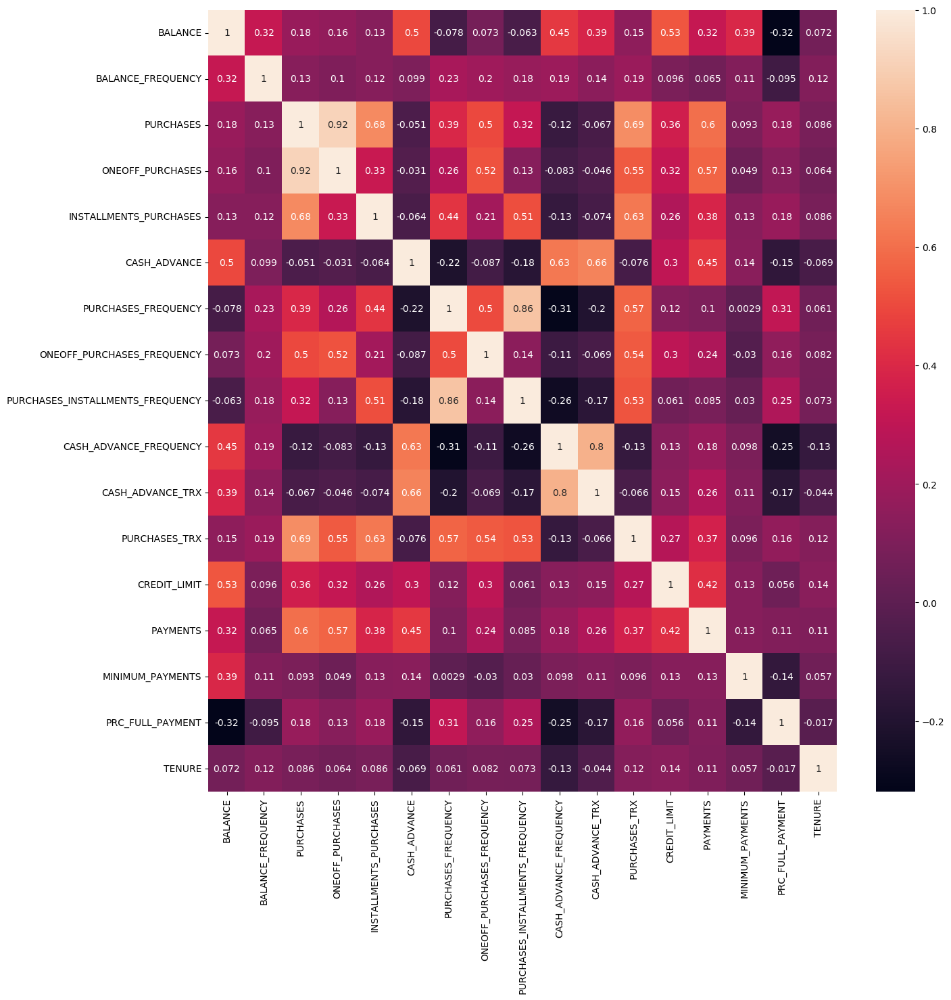

In [20]:
plt.figure(figsize=(15,15))
sns.heatmap(df.corr(), annot=True)
plt.show()

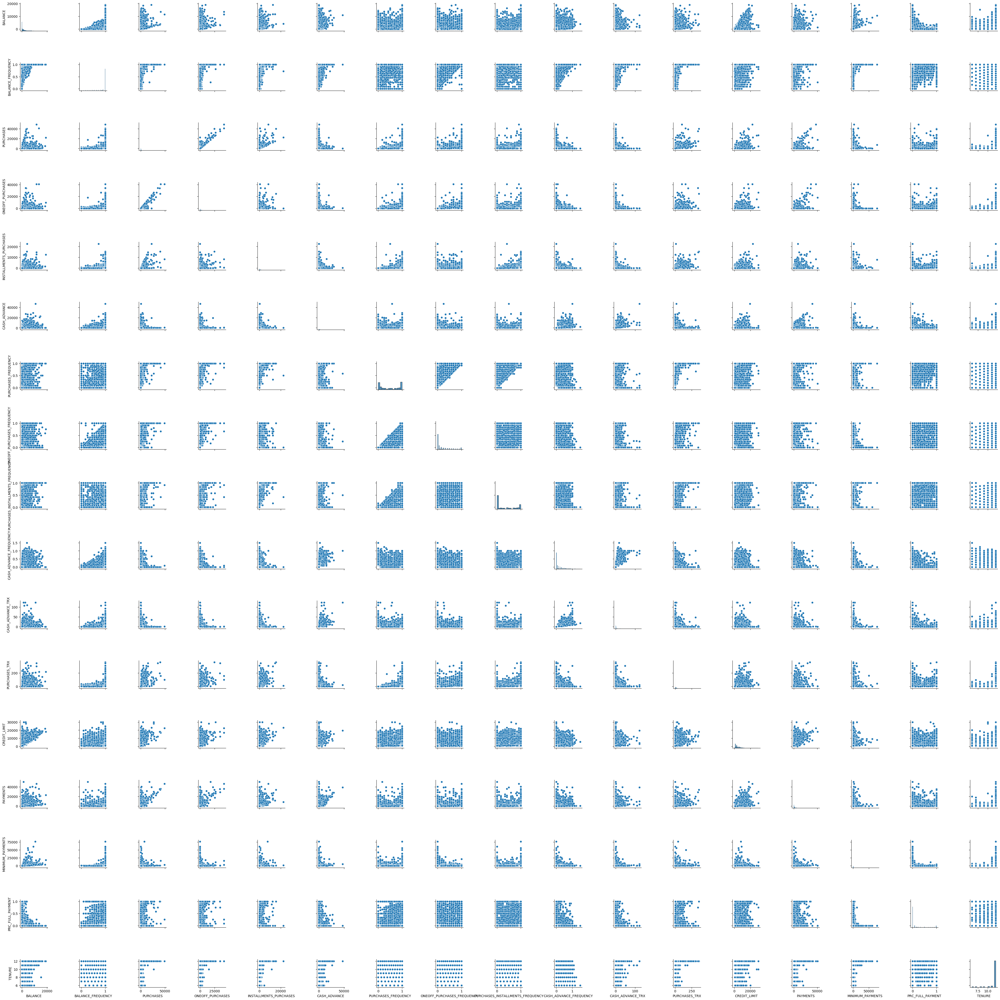

In [21]:
sns.pairplot(df)

Notice that some areas from the plot above are high-density. It looks like we can apply an algorithm to separate high density with a cluster of low density. 

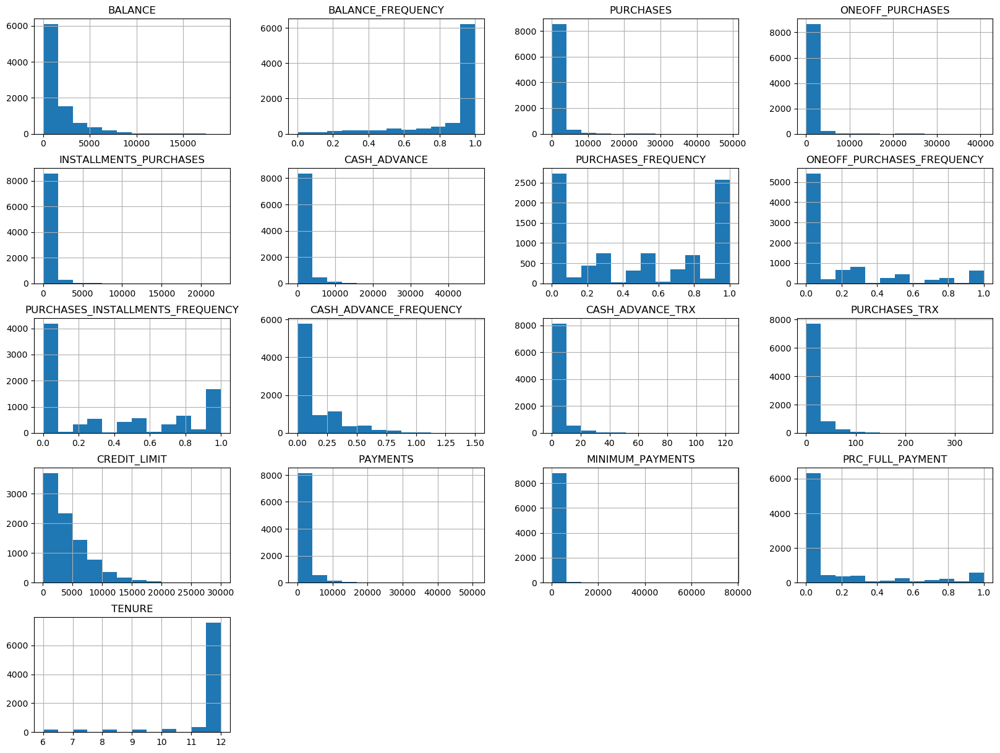

In [22]:
df.hist(bins=12, figsize=(20, 15), layout=(5,4));

From the above plots, notices that most of the graphs are skewed. The reason could be most customers have some common in one feature. 

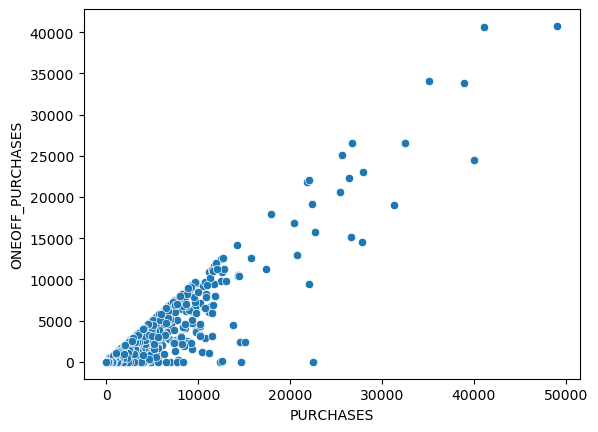

In [23]:
sns.scatterplot(x='PURCHASES', y='ONEOFF_PURCHASES', data=df);

In [24]:
df_purchases = df[['PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES']]
df_purchases.head()

,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES
0,95.40,0.00,95.4
1,0.00,0.00,0.0
2,773.17,773.17,0.0
3,1499.00,1499.00,0.0
4,16.00,16.00,0.0


In [25]:
df['PURCHASES'] == df['ONEOFF_PURCHASES'] + df['INSTALLMENTS_PURCHASES']

0       True
1       True
2       True
3       True
4       True
        ... 
8945    True
8946    True
8947    True
8948    True
8949    True
Length: 8949, dtype: bool

In [26]:
df_purchases['SUM_OF_ONEOFF_INSTALLMENTS'] = df_purchases['ONEOFF_PURCHASES'] + df_purchases['INSTALLMENTS_PURCHASES']
df_purchases.loc[df['PURCHASES'] != df_purchases['ONEOFF_PURCHASES'] + df_purchases['INSTALLMENTS_PURCHASES']]

C:\Users\jacks\anaconda3\envs\UL\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,SUM_OF_ONEOFF_INSTALLMENTS
50,901.42,646.07,255.35,901.42
71,4523.27,1664.09,2859.18,4523.27
82,133.05,28.20,104.85,133.05
86,1603.78,1445.14,158.64,1603.78
110,1354.86,585.63,769.23,1354.86
...,...,...,...,...
8769,1045.14,227.14,818.00,1045.14
8825,654.84,460.89,193.95,654.84
8832,63.40,35.09,28.31,63.40
8834,510.00,0.00,780.00,780.00


From the above analysis, we can see that most of the purchase is equal to the sum of the one-off purchase and installment purchase. Only a few customers such as the one on row 8834 who has a high installment purchase. 

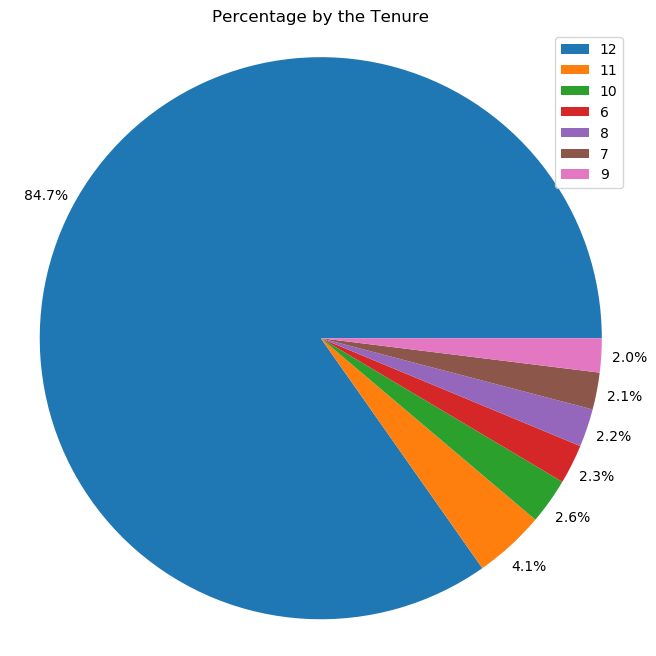

In [27]:
fig1, ax1 = plt.subplots(figsize=(8, 8))
ax1.pie(df['TENURE'].value_counts(), autopct='%1.1f%%', pctdistance=1.1)
ax1.legend(df['TENURE'].value_counts().index)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.title("Percentage by the Tenure")
plt.show()

From the pie chart above, we can see about 84.7% of users have a 12 months tenure. 

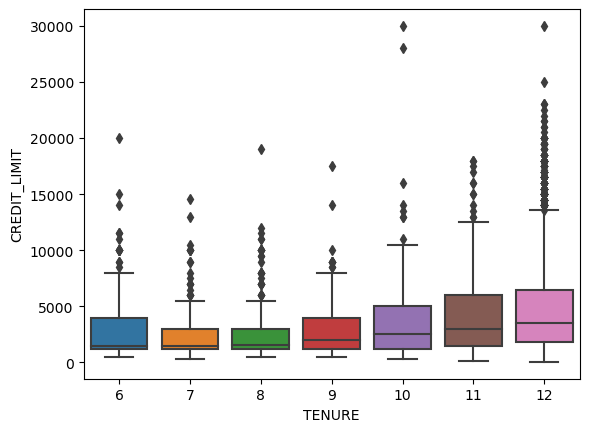

In [28]:
sns.boxplot(x = 'TENURE', y = 'CREDIT_LIMIT', data = df)

From the boxplots above, we can see that user who have longer tenure also tends to have a higher credit limit. 

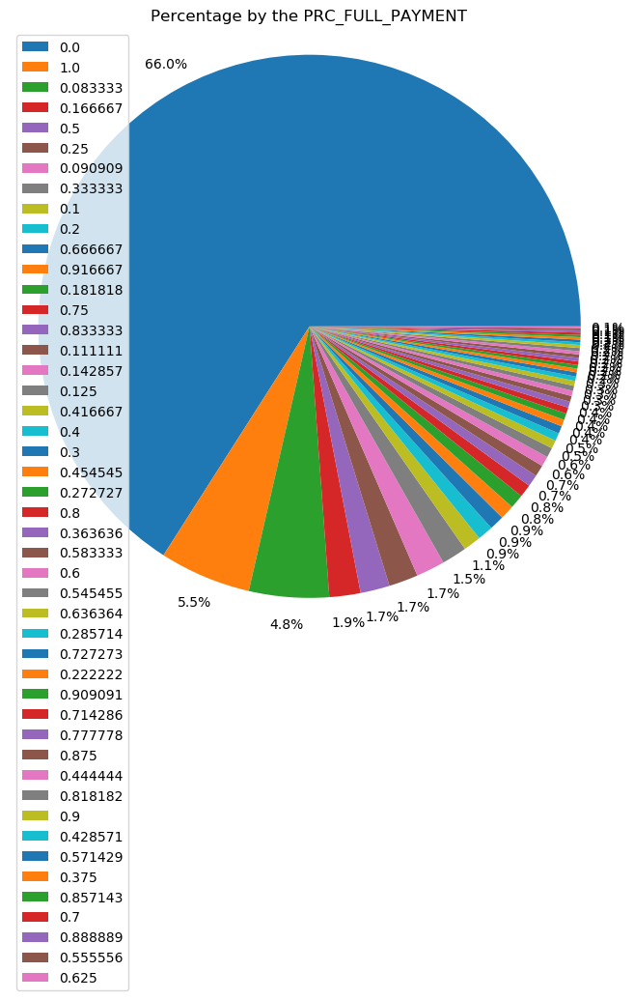

In [29]:

fig1, ax1 = plt.subplots(figsize=(8, 8))
ax1.pie(df['PRC_FULL_PAYMENT'].value_counts(), autopct='%1.1f%%', pctdistance=1.1)
ax1.legend(df['PRC_FULL_PAYMENT'].value_counts().index)
ax1.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

plt.title("Percentage by the PRC_FULL_PAYMENT")
plt.show()

From the pie chart above, only 5.5% of users made a full payment. Surprisingly, about 66% of users with 0% of full payment paid. Users who made a full payment could have enough money in their savings, company may offer a wealth management plan or saving plan to those users. 

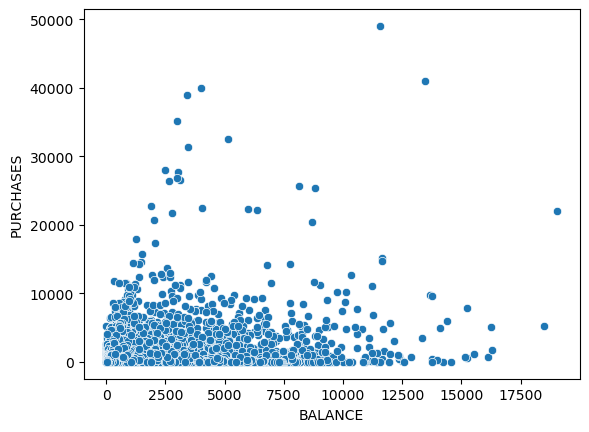

In [30]:
sns.scatterplot(x='BALANCE', y='PURCHASES', data=df);

It makes sense when the amount of purchases made is below the balance amount left in their account. There are some outliers such as the user who only has a balance of about \\$11,000 but has \\$50,000 purchases. Those users could be business owners who may need a large amount of money so they may need a loan to purchase more. 

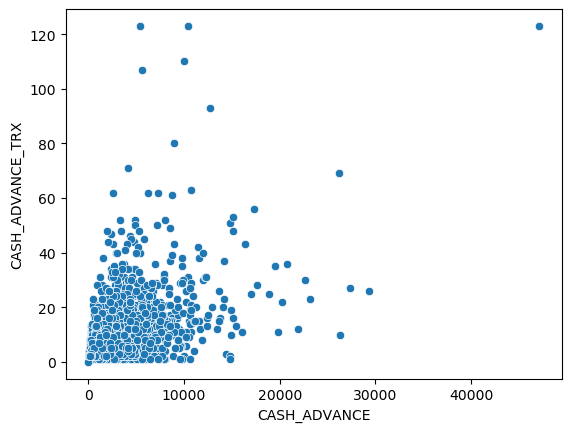

In [31]:
sns.scatterplot(x='CASH_ADVANCE', y='CASH_ADVANCE_TRX', data=df);

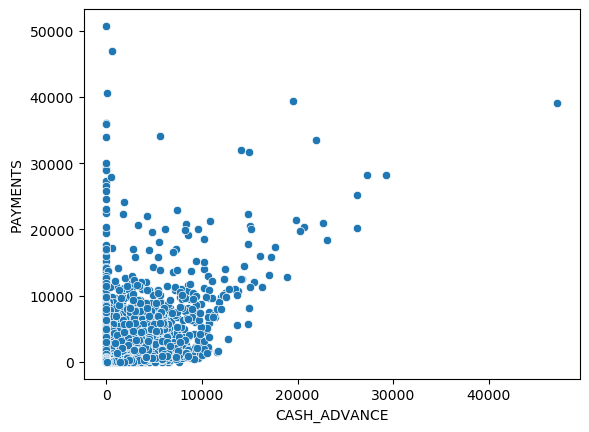

In [32]:
sns.scatterplot(x='CASH_ADVANCE', y='PAYMENTS',data = df)

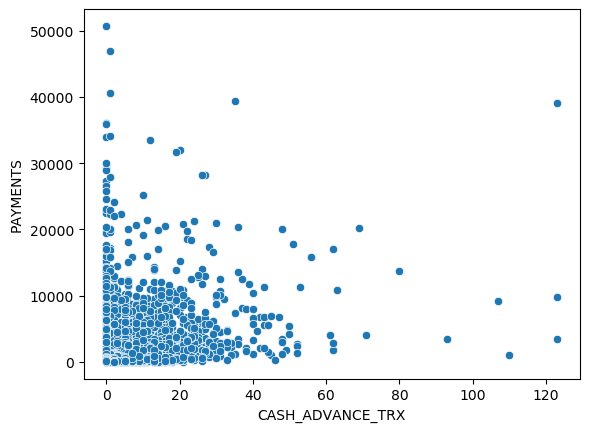

In [33]:
sns.scatterplot(x='CASH_ADVANCE_TRX', y='PAYMENTS',data = df)

Cash Advance is like a short-term loan offered by credit card issuers. People who use cash advance a lot is more likely to need a loan. The user who likes taking cash advances but only makes a small amount of payments could be a customer who likes to borrow a loan but may have issues paying off the loan in the future. 

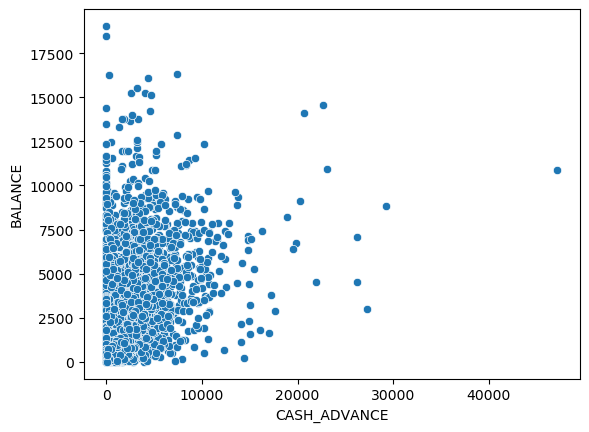

In [34]:
sns.scatterplot(x='CASH_ADVANCE', y='BALANCE',data = df)

People who have a high balance and high cash advance have a high probability to apply for a loan. 

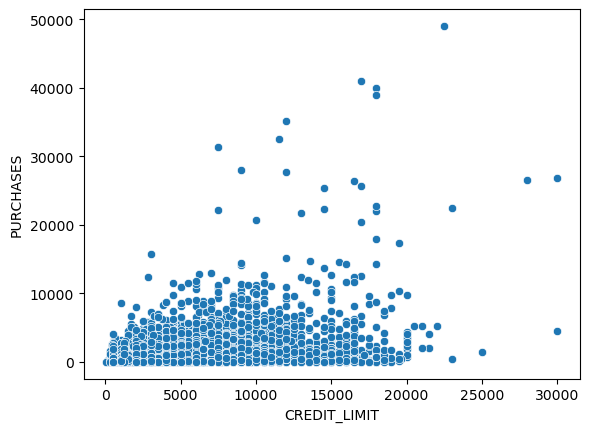

In [35]:
sns.scatterplot(x='CREDIT_LIMIT', y='PURCHASES',data = df)

There is a small group of users who make purchases higher than the credit limit, they could be the customer who needs a loan but users with a low credit limit could have a bad credit history. 

### Preprocessing

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

Before applying the data to the unsupervised model, we need to **standardize** the data. Data standardization transform features to a **similar scale**. It rescales data to have a mean of 0 and a standard deviation of 1. From the analysis above, we can see that some features are from 0 to 1 but some features have a wide range of scope. The dataset has extremely high or low values. Standardization can transform the dataset to a common scale so the training won't affect by the large different ranges of values.

In [36]:
scaler = StandardScaler()
data=scaler.fit_transform(df)
data = pd.DataFrame(data, columns=df.columns)

Let's see what the data looks like after standarization:

In [37]:
data.head()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
0,-0.732054,-0.249881,-0.424934,-0.356957,-0.349114,-0.466805,-0.806649,-0.678716,-0.707409,-0.675294,-0.476083,-0.511381,-0.960380,-0.529026,-3.109947e-01,-0.525588,0.360541
1,0.786858,0.134049,-0.469584,-0.356957,-0.454607,2.605438,-1.221928,-0.678716,-0.917090,0.573949,0.110032,-0.591841,0.688601,0.818546,8.926366e-02,0.234159,0.360541
2,0.447041,0.517980,-0.107716,0.108843,-0.454607,-0.466805,1.269742,2.673295,-0.917090,-0.675294,-0.476083,-0.109082,0.826016,-0.383857,-1.017005e-01,-0.525588,0.360541
3,0.049015,-1.017743,0.231995,0.546123,-0.454607,-0.368678,-1.014290,-0.399383,-0.917090,-0.258882,-0.329554,-0.551611,0.826016,-0.598733,4.878069e-17,-0.525588,0.360541
4,-0.358849,0.517980,-0.462095,-0.347317,-0.454607,-0.466805,-1.014290,-0.399383,-0.917090,-0.675294,-0.476083,-0.551611,-0.905414,-0.364421,-2.658206e-01,-0.525588,0.360541


In [38]:
data.describe()

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE
count,8949.000000,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03,8.949000e+03
mean,0.000000,-3.144205e-16,-8.257509e-17,-4.128754e-17,1.746781e-17,-1.587982e-17,7.701715e-17,-6.351930e-18,4.605149e-17,-1.270386e-17,1.587982e-17,1.905579e-17,2.159656e-16,6.351930e-17,1.270386e-17,-3.175965e-18,-2.794849e-16
std,1.000056,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00,1.000056e+00
min,-0.751704,-3.705263e+00,-4.695839e-01,-3.569565e-01,-4.546069e-01,-4.668054e-01,-1.221928e+00,-6.787162e-01,-9.170895e-01,-6.752945e-01,-4.760829e-01,-5.918405e-01,-1.221468e+00,-5.987332e-01,-3.708473e-01,-5.255884e-01,-4.126919e+00
25%,-0.690033,4.873144e-02,-4.509562e-01,-3.569565e-01,-4.546069e-01,-4.668054e-01,-1.014290e+00,-6.787162e-01,-9.170895e-01,-6.752945e-01,-4.760829e-01,-5.516107e-01,-7.954817e-01,-4.663388e-01,-2.975363e-01,-5.255884e-01,3.605413e-01
50%,-0.331962,5.179802e-01,-3.003952e-01,-3.340632e-01,-3.561912e-01,-4.668054e-01,2.390672e-02,-3.993831e-01,-4.977267e-01,-6.752945e-01,-4.760829e-01,-3.102316e-01,-4.107196e-01,-3.026846e-01,-2.268317e-01,-5.255884e-01,3.605413e-01
75%,0.235279,5.179802e-01,5.001060e-02,-8.840161e-03,6.362342e-02,6.432979e-02,1.062103e+00,3.268871e-01,9.700395e-01,4.351431e-01,1.100315e-01,9.206698e-02,5.511855e-01,5.801121e-02,4.878069e-17,-3.717957e-02,3.605413e-01
max,8.397195,5.179802e-01,2.248248e+01,2.419985e+01,2.442576e+01,2.201002e+01,1.269742e+00,2.673295e+00,1.599083e+00,6.820167e+00,1.754694e+01,1.381045e+01,7.009692e+00,1.692160e+01,3.241348e+01,2.893277e+00,3.605413e-01


### Models

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

#### K-means Clustering

**K-means clustering** is one of the most popular techniques in unsupervised machine learning, which searches k clusters in your data. <br>

Main steps:<br>
<ol>
    <li>pick k (number of clusters)</li>
    <li>place k centroids randomly among the training data</li>
    <li>calculate distance from each centroid to all the points in the training data</li>
    <li>group all the data points with their nearest centroid</li>
    <li>calculate the mean data point in a single cluster and move the previous centroid to the mean location</li>
    <li>repeat for each cluster</li>
    <li>repeat the step 2 to step 6 until centroids don't move and colors don't change or maximum number of iterations has been achieved</li>
</ol> 

Let's start with a 3 clusters model.

In [39]:
km_3 = KMeans(3)
km_3_clusters = km_3.fit_predict(data)

**Silhouette score** can help evaluate the performance of unsupervised learning methods.The silhouette score is a metric that evaluates how well the data points fit in their clusters. Simplified Silhouette Index = (bi-ai)/(max(ai, bi)), where ai is the distance from data point i to its own cluster centroid and bi is the distance from point i to the nearest cluster centroid. The score ranges from -1 to 1, where 1 indicates the model achieved perfect clusters. 

In [40]:
silhouette_score(data, km_3_clusters)

0.2511201158410639

Let's see what it looks like with some plots.

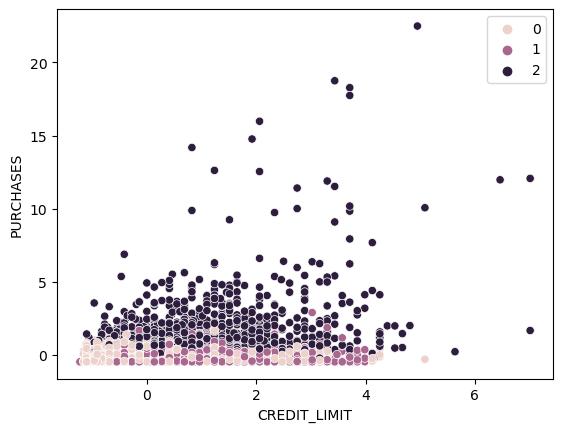

In [41]:
sns.scatterplot(x='CREDIT_LIMIT', y='PURCHASES',data = data,hue = km_3_clusters)

From the plot above, we can see cluster one are customer with a higher purchase. Cluster zero and cluster two are mixing together at the bottom. 

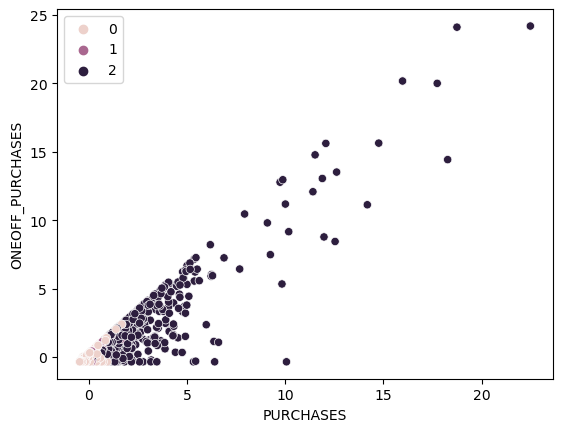

In [42]:
sns.scatterplot(x='PURCHASES', y='ONEOFF_PURCHASES', data=data,hue = km_3_clusters)

It is a little bit hard to see the clusters with these features. 

Let's build a for loop for different k values. 

k=2 K-Means Clustering: 0.20948941929133194


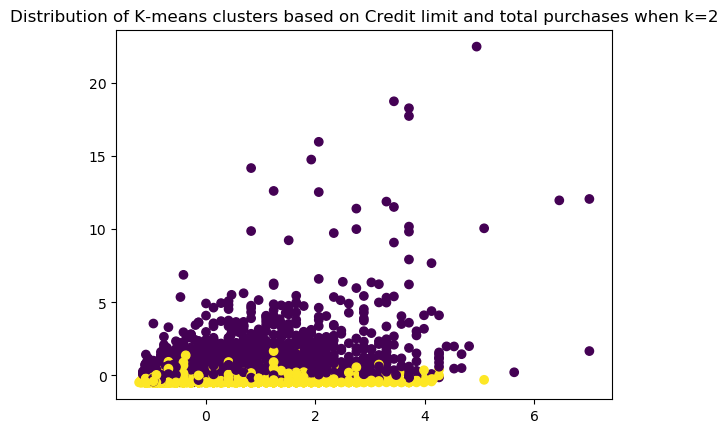

k=3 K-Means Clustering: 0.2502389638054194


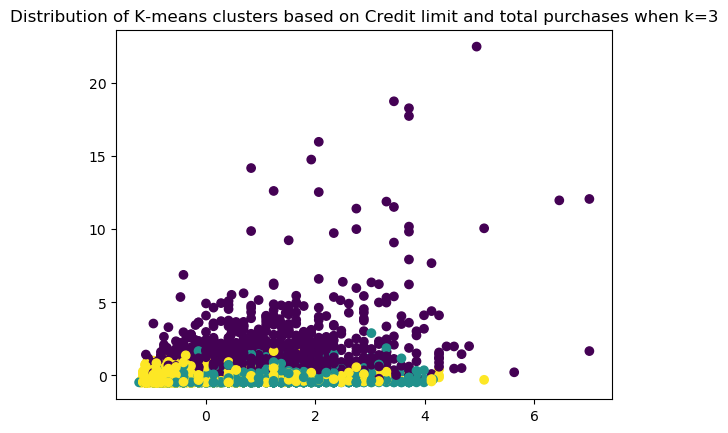

k=4 K-Means Clustering: 0.19759862081695156


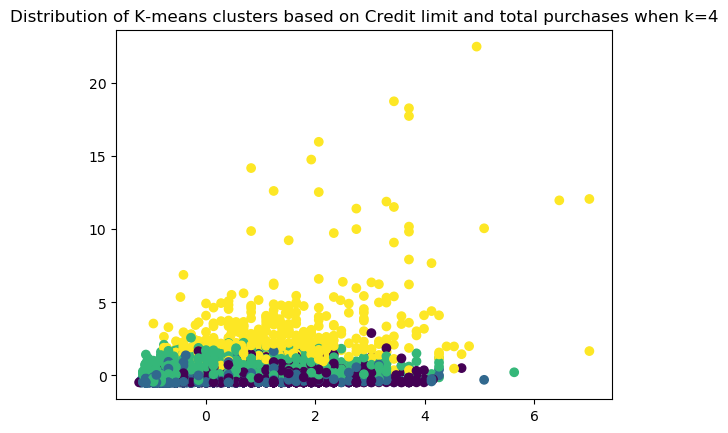

k=5 K-Means Clustering: 0.19316716374436665


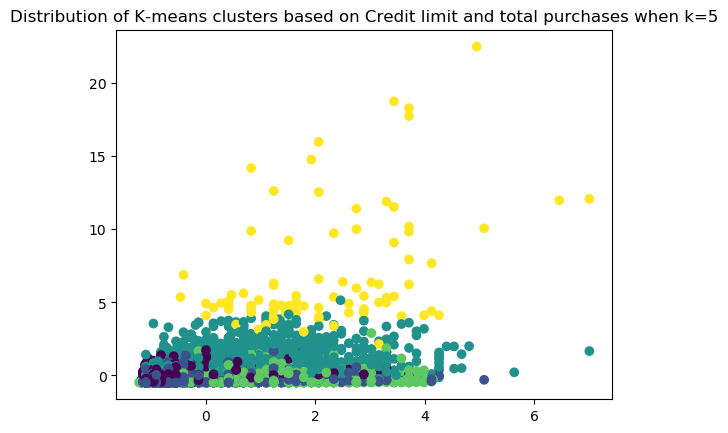

k=6 K-Means Clustering: 0.2025496307659155


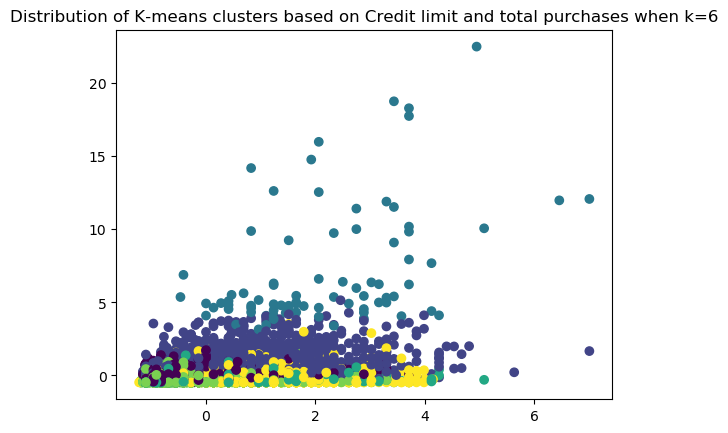

k=7 K-Means Clustering: 0.21418199158286824


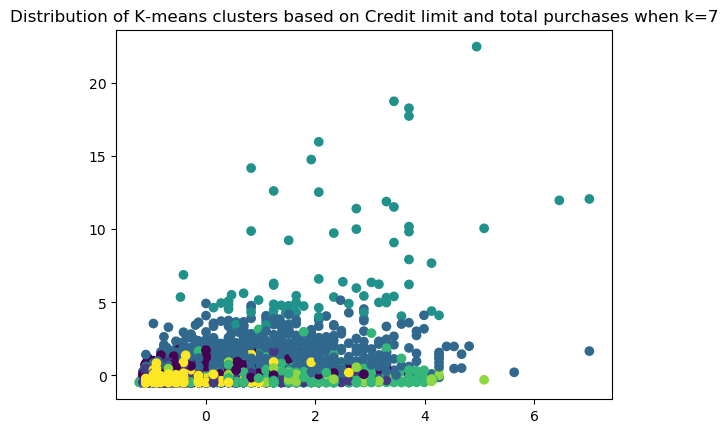

k=8 K-Means Clustering: 0.2222800137075136


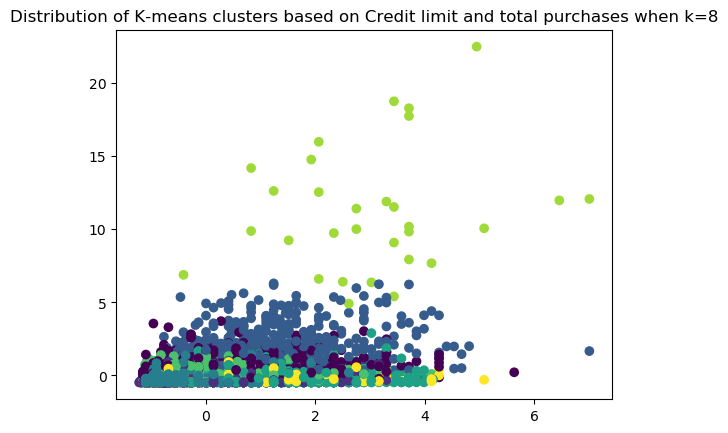

k=9 K-Means Clustering: 0.2127706530371557


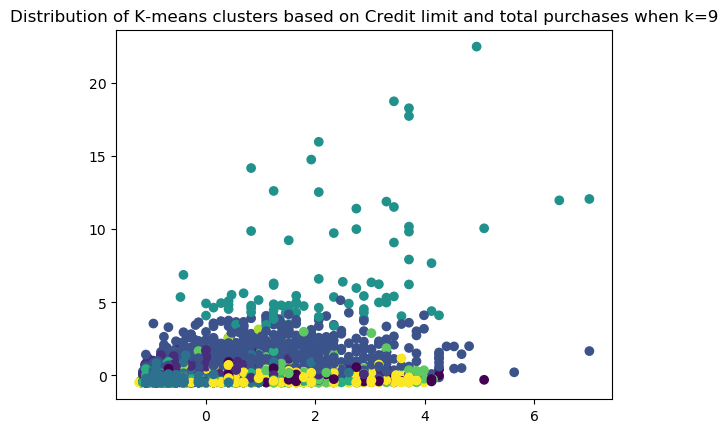

k=10 K-Means Clustering: 0.22131963987733896


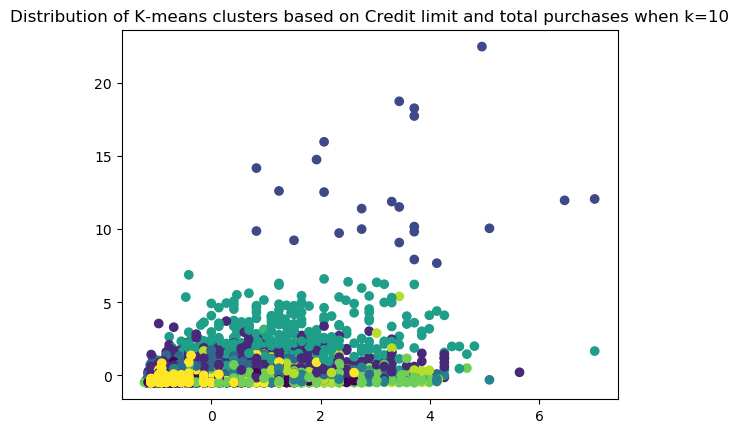

In [43]:
km_list = []
for i in range (2,11):
    km = KMeans(i)
    km_clusters = km.fit_predict(data)
    sil_score = silhouette_score(data, km_clusters)
    print(f"k={i} K-Means Clustering: {sil_score}")
    
    km_list.append((i, sil_score))
    
    plt.scatter(x='CREDIT_LIMIT', y='PURCHASES',data = data,c = km_clusters)
    plt.title(f"Distribution of K-means clusters based on Credit limit and total purchases when k={i}")
    plt.show()

df_km = pd.DataFrame(km_list, columns=['k', 'silhouette_score'])

In [44]:
df_km.sort_values('silhouette_score', ascending=False)

,k,silhouette_score
1,3,0.250239
6,8,0.222280
8,10,0.221320
5,7,0.214182
7,9,0.212771
0,2,0.209489
4,6,0.202550
2,4,0.197599
3,5,0.193167


From the table above, k = 3 has the highest silhouette score. 

#### Hierarchical Clustering

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

**Agglomerative hierarchical clustering** treats each data point as its own cluster and then merges similar points together. **Linkage** defines the calculation of the distances between clusters. 

Main steps:<br>
<ol>
    <li>given n data points, treat each point as an individual cluster</li>
    <li>calculate distance between the centroids of all the clusters in the data</li>
    <li>group the closest clusters or points</li>
    <li>repeat step 2 and step 3 until there is only one single cluster</li>
    <li>plot a dendrogram(tree plots)</li>
</ol>

In [45]:
ac = AgglomerativeClustering(linkage='average')
ac_clusters = ac.fit_predict(data)
silhouette_score(data, ac_clusters)

0.8496907145224083

The silhouette_score of 0.8497 is higher. 

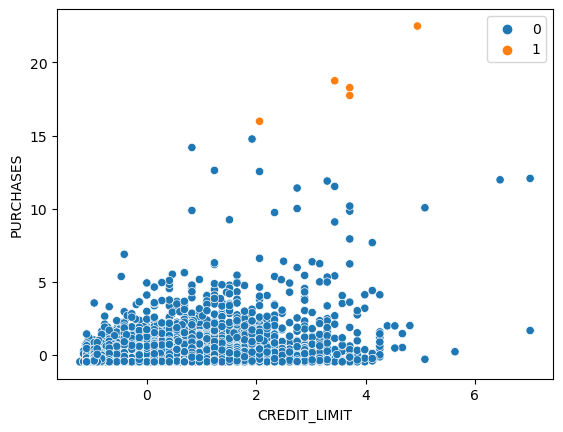

In [46]:
sns.scatterplot(x='CREDIT_LIMIT', y='PURCHASES',data = data,hue = ac_clusters)

It looks like it group customer based on the purchase amount but only a few points label as cluster 1. 

In [47]:
ac = AgglomerativeClustering(linkage='ward')
ac_clusters = ac.fit_predict(data)
silhouette_score(data, ac_clusters)

0.18946426808640232

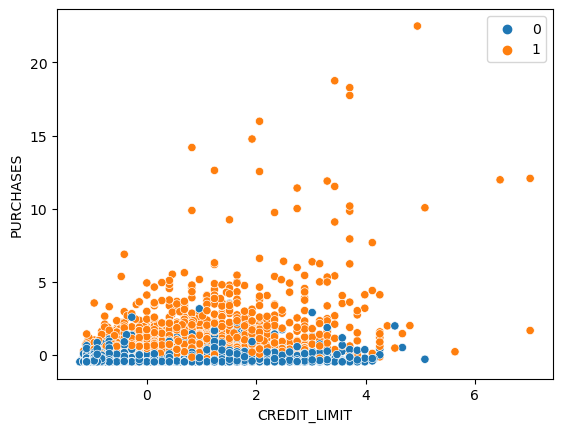

In [48]:
sns.scatterplot(x='CREDIT_LIMIT', y='PURCHASES',data = data,hue = ac_clusters)

The silhouette score of ward method is low; however, it creates a different clusters with more number of point with a lable of cluster 1. 

Let's build a for loop trying with different number of clusters and different linkage methods.

n_clusters=2, linkage=single   Agglomerative Clustering: 0.8408048261410714


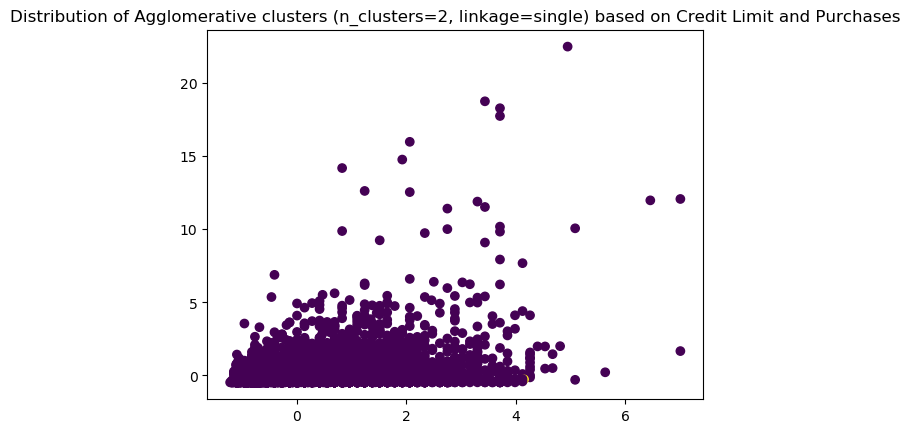

n_clusters=2, linkage=ward   Agglomerative Clustering: 0.18946426808640232


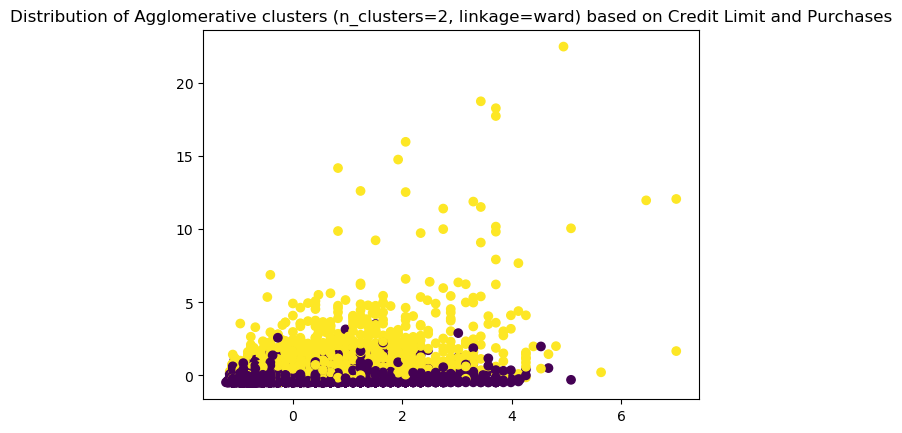

n_clusters=2, linkage=average   Agglomerative Clustering: 0.8496907145224083


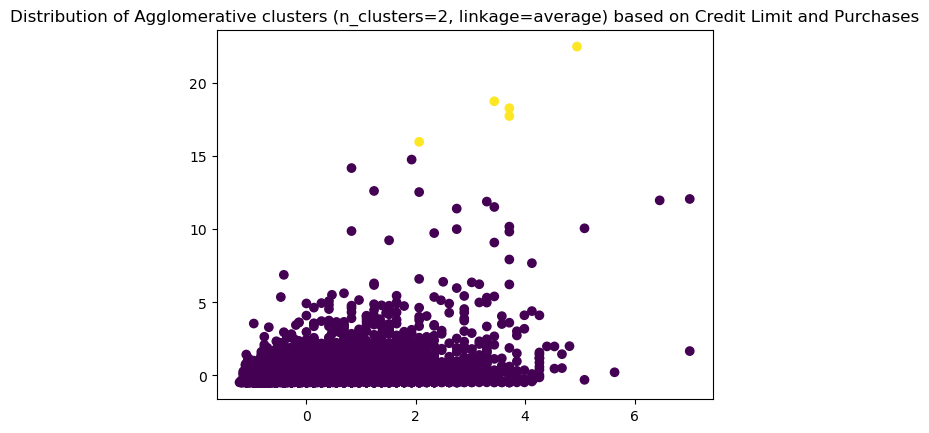

n_clusters=2, linkage=complete   Agglomerative Clustering: 0.7865446362943753


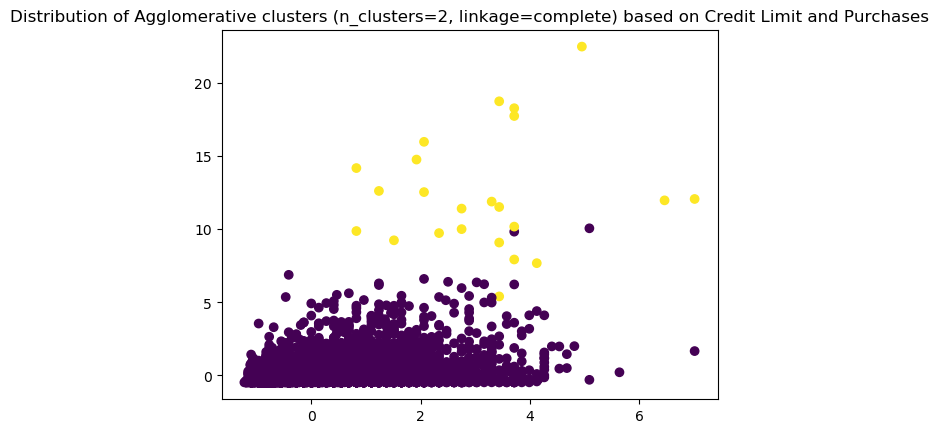

n_clusters=3, linkage=single   Agglomerative Clustering: 0.8379826851553768


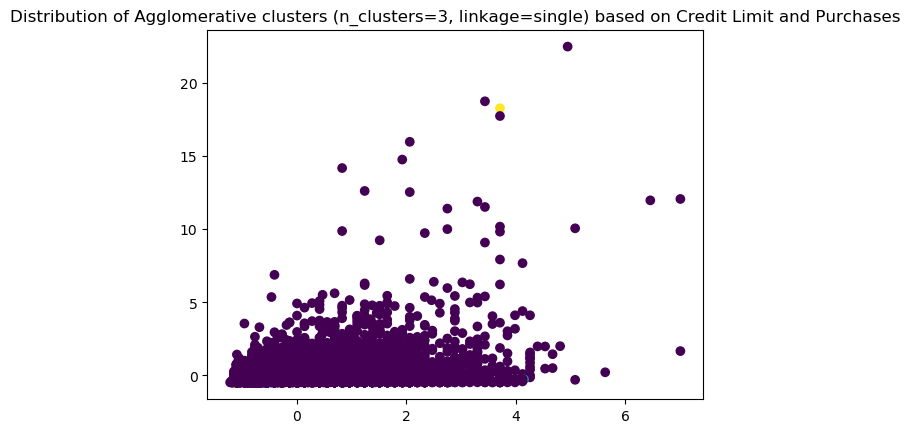

n_clusters=3, linkage=ward   Agglomerative Clustering: 0.1816063879990238


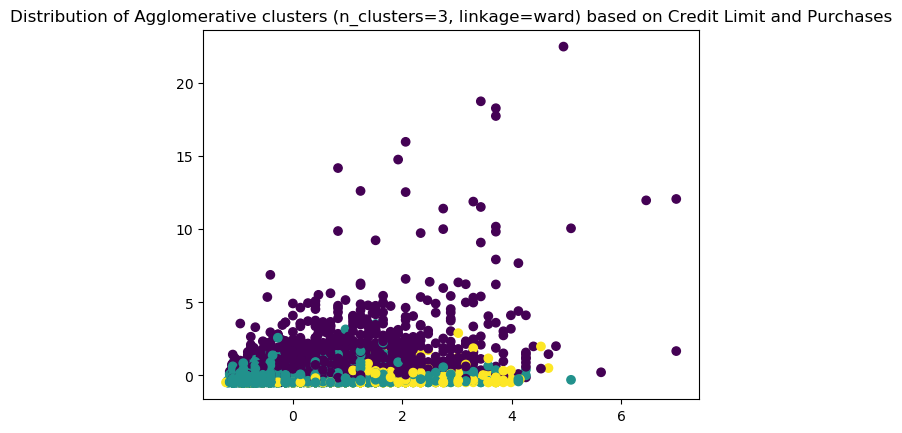

n_clusters=3, linkage=average   Agglomerative Clustering: 0.8391200448529502


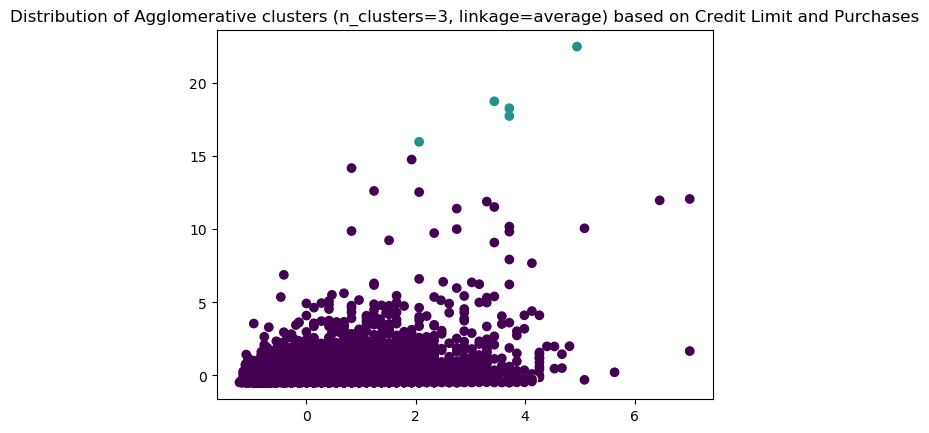

n_clusters=3, linkage=complete   Agglomerative Clustering: 0.7862981537029926


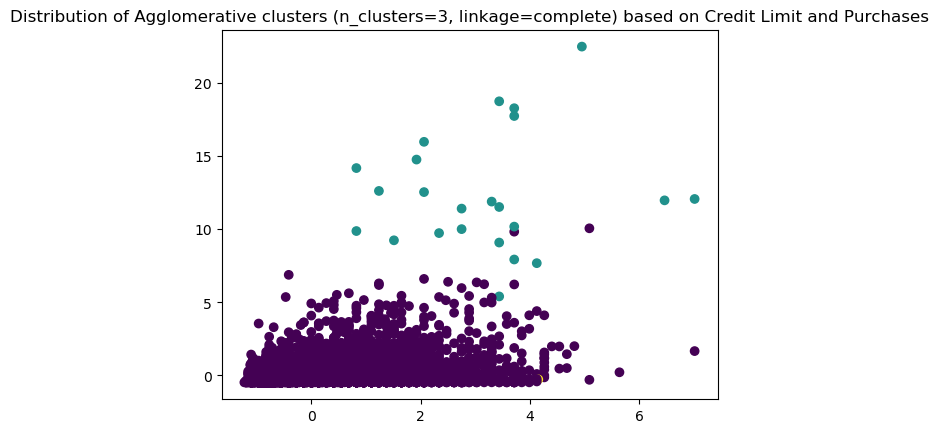

n_clusters=4, linkage=single   Agglomerative Clustering: 0.8121063486405521


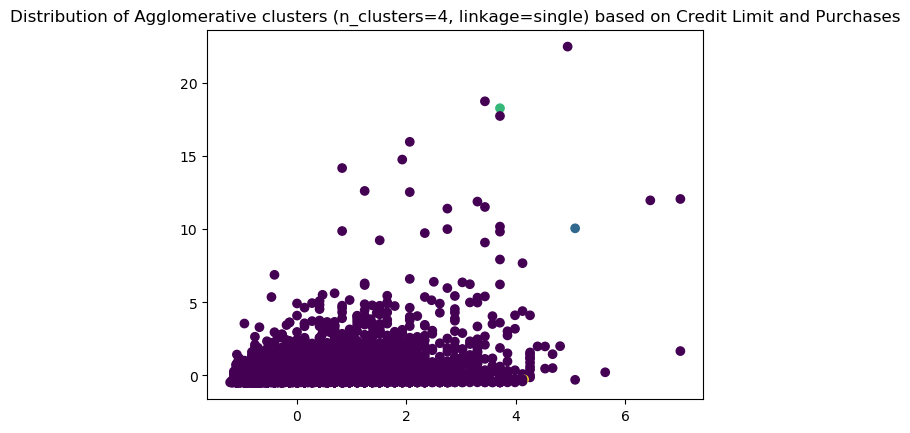

n_clusters=4, linkage=ward   Agglomerative Clustering: 0.18238090388475459


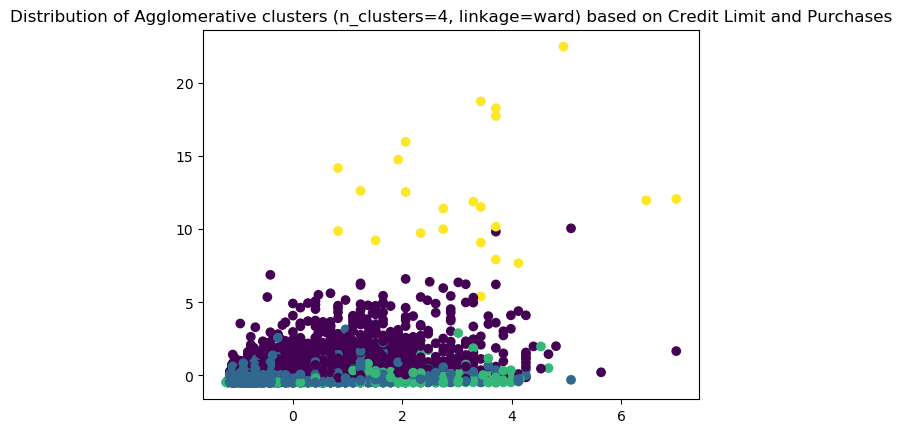

n_clusters=4, linkage=average   Agglomerative Clustering: 0.8129521420619767


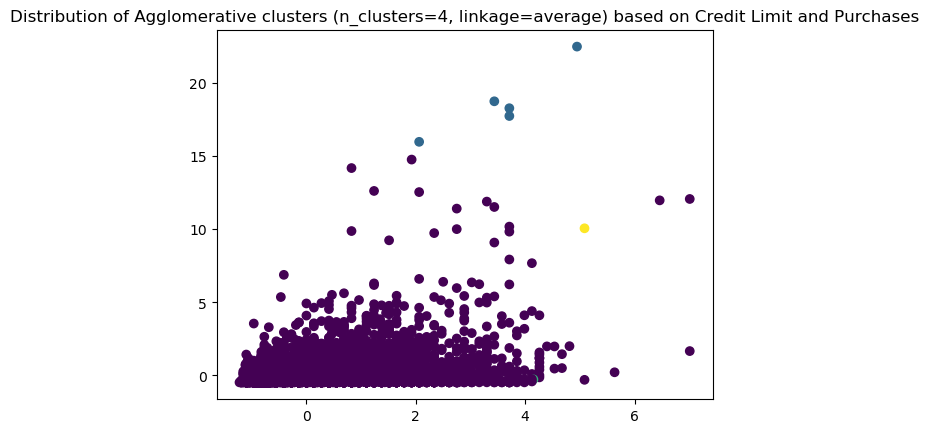

n_clusters=4, linkage=complete   Agglomerative Clustering: 0.7792493597154928


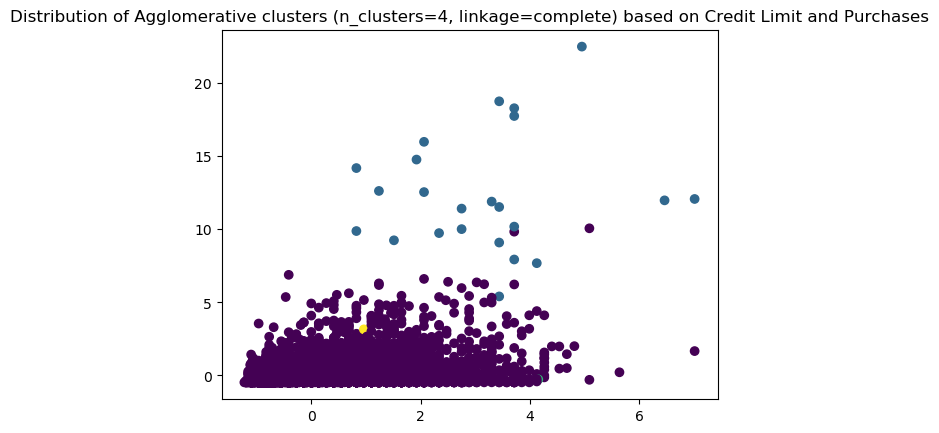

n_clusters=5, linkage=single   Agglomerative Clustering: 0.8116260348700032


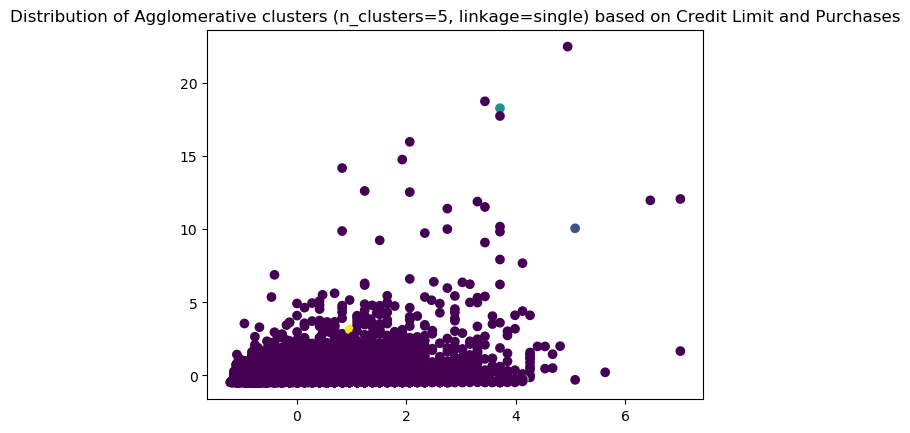

n_clusters=5, linkage=ward   Agglomerative Clustering: 0.1570623296106423


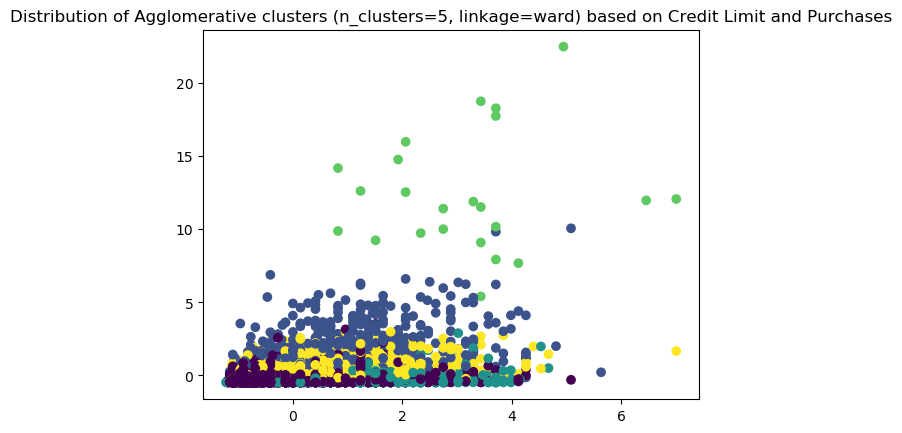

n_clusters=5, linkage=average   Agglomerative Clustering: 0.8084580367296601


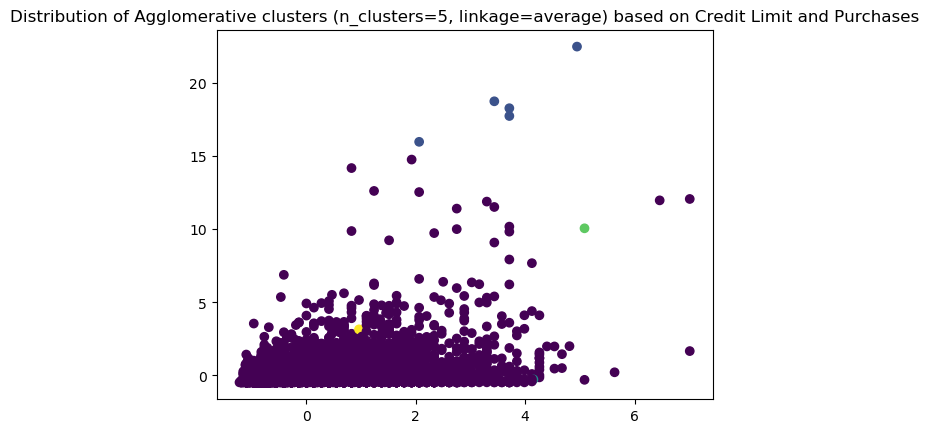

n_clusters=5, linkage=complete   Agglomerative Clustering: 0.6599101523037232


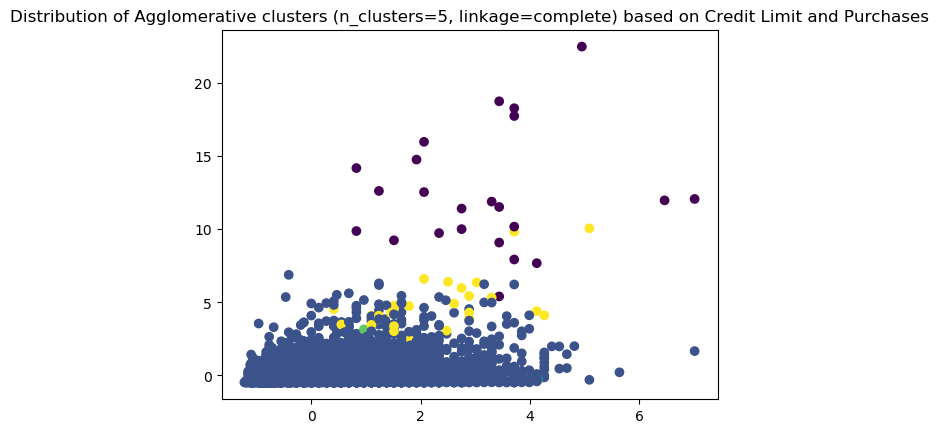

n_clusters=6, linkage=single   Agglomerative Clustering: 0.7703226236486114


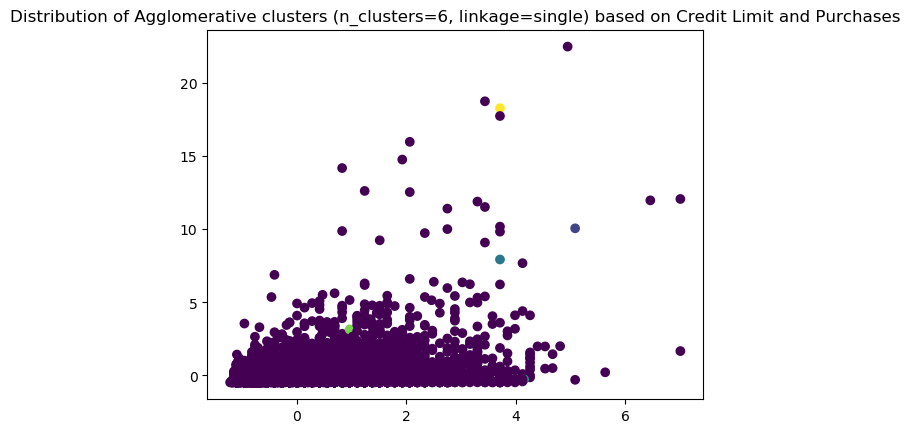

n_clusters=6, linkage=ward   Agglomerative Clustering: 0.14181282927536704


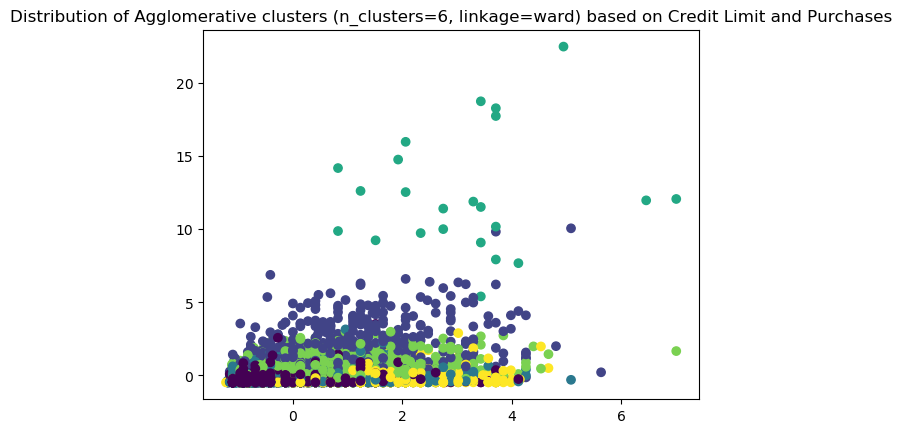

n_clusters=6, linkage=average   Agglomerative Clustering: 0.7438494152086946


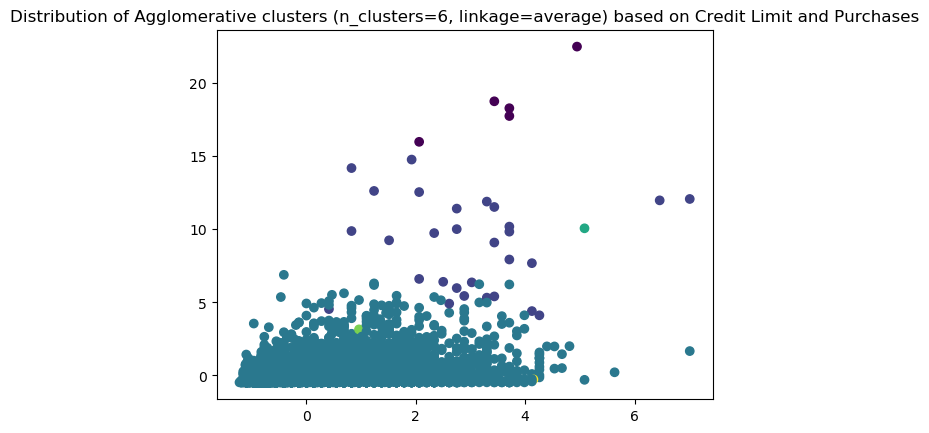

n_clusters=6, linkage=complete   Agglomerative Clustering: 0.6597986147910581


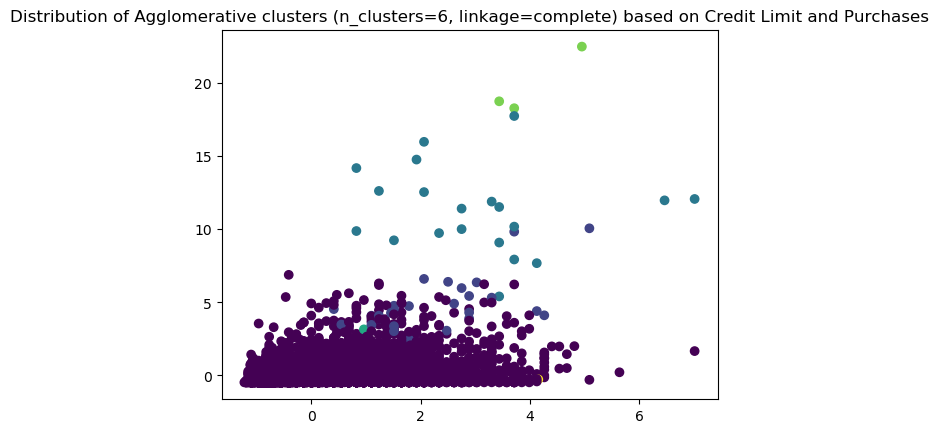

n_clusters=7, linkage=single   Agglomerative Clustering: 0.770464269594815


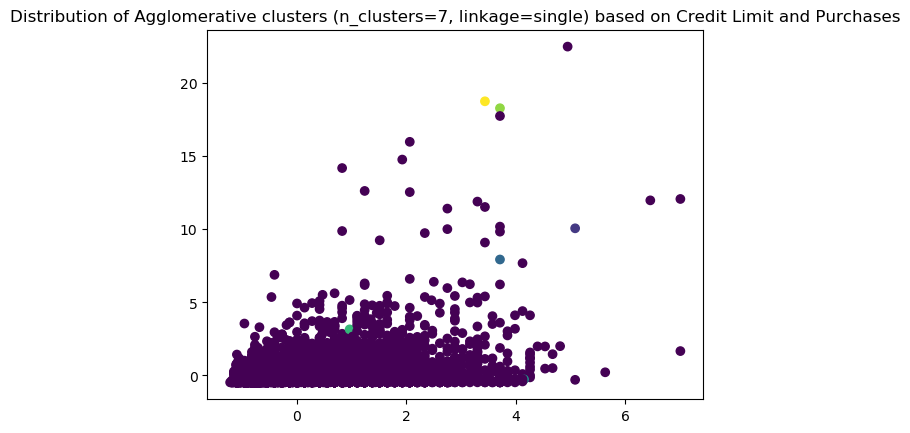

n_clusters=7, linkage=ward   Agglomerative Clustering: 0.16042534653321708


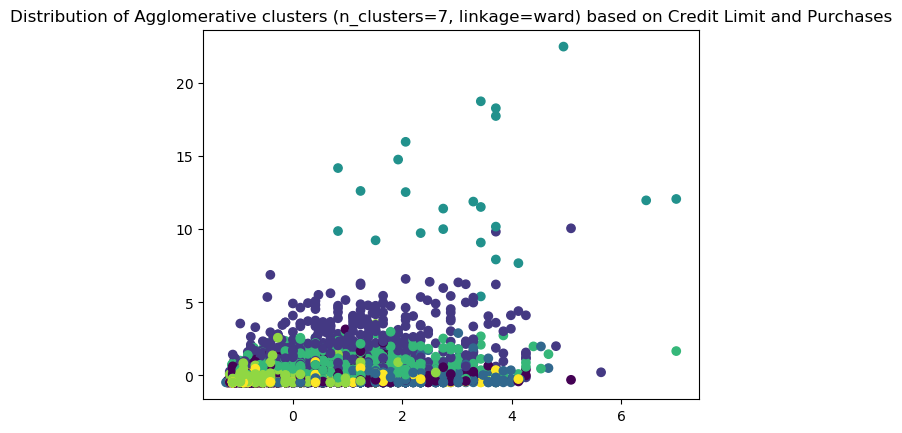

n_clusters=7, linkage=average   Agglomerative Clustering: 0.743695445530731


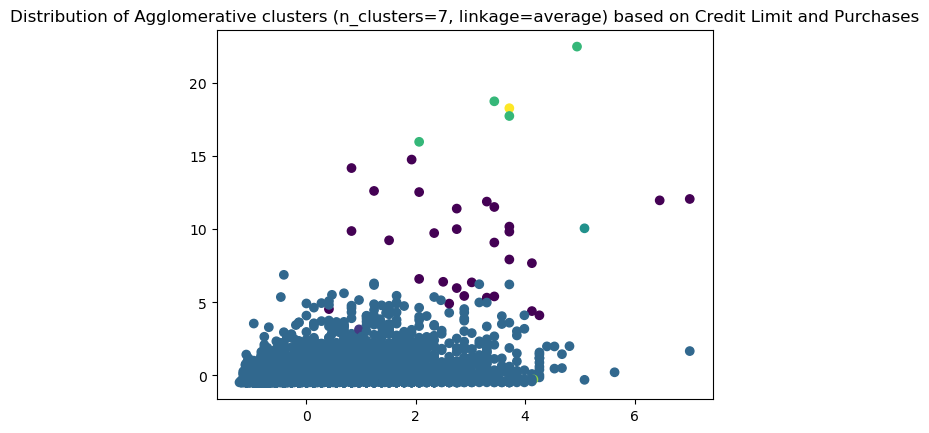

n_clusters=7, linkage=complete   Agglomerative Clustering: 0.6569799824431399


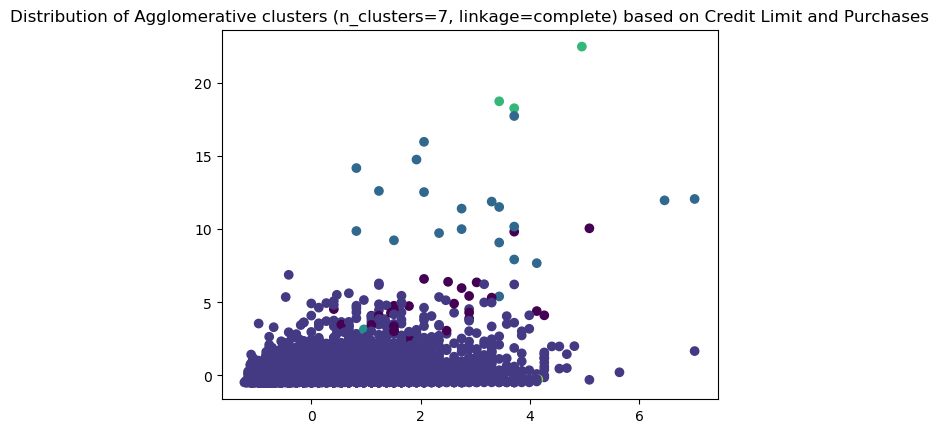

n_clusters=8, linkage=single   Agglomerative Clustering: 0.7701091144948128


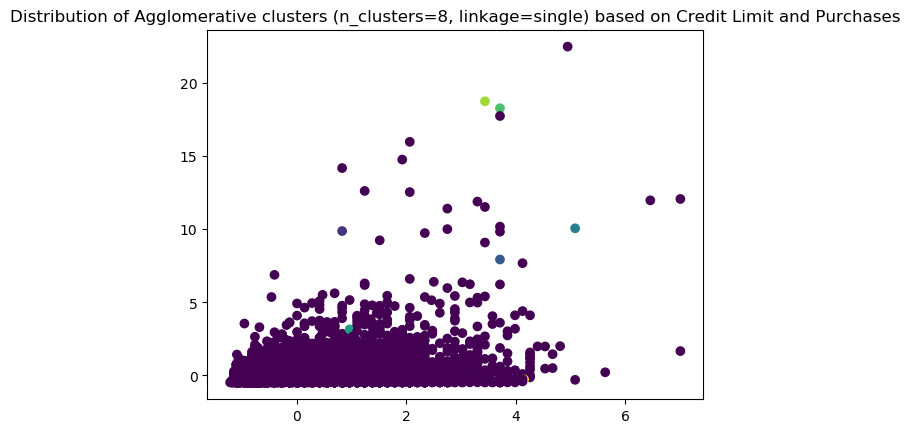

n_clusters=8, linkage=ward   Agglomerative Clustering: 0.16170524524009727


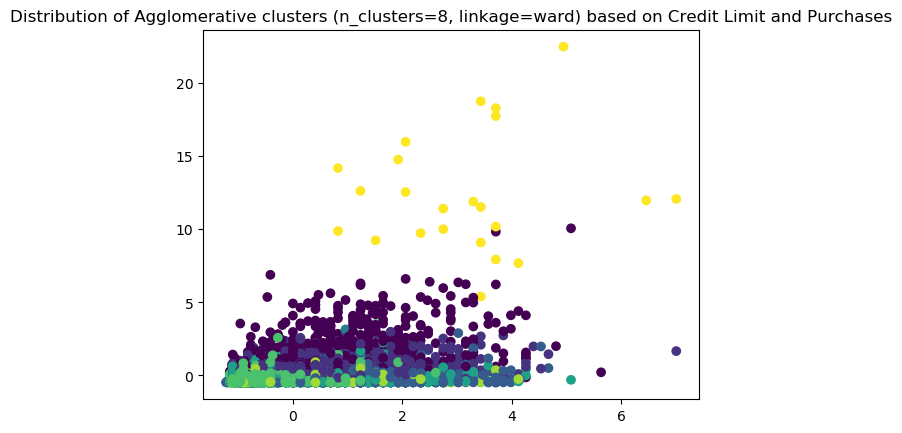

n_clusters=8, linkage=average   Agglomerative Clustering: 0.7180046252630964


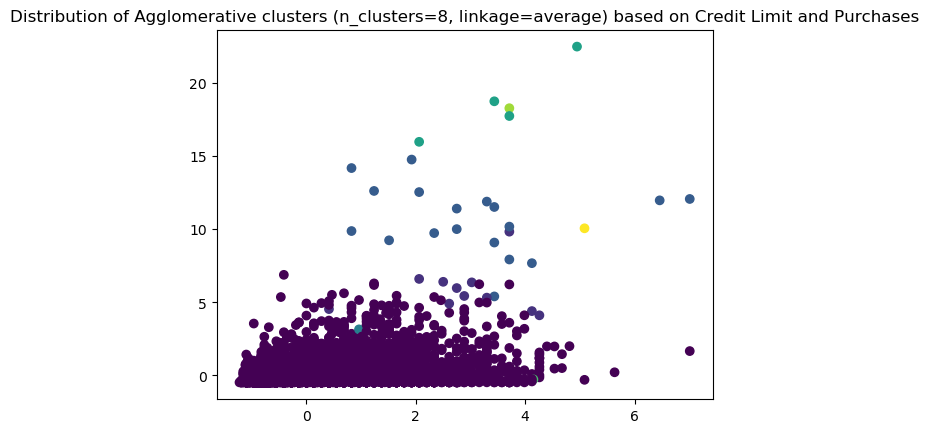

n_clusters=8, linkage=complete   Agglomerative Clustering: 0.6458092042734301


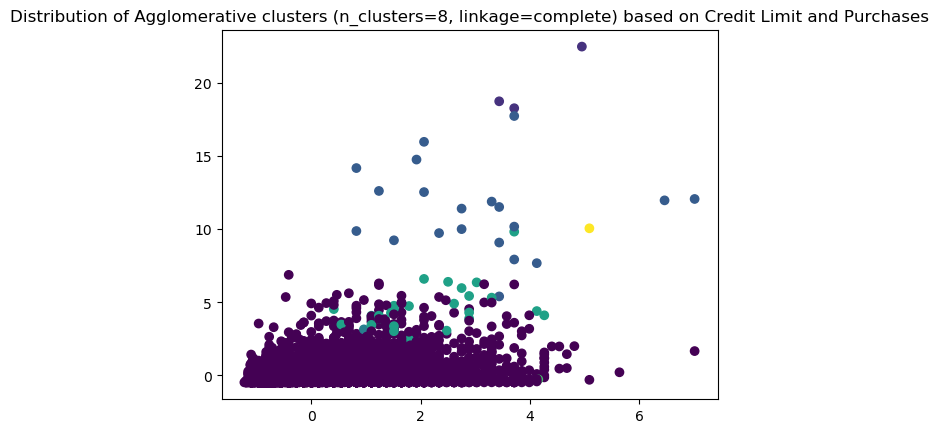

n_clusters=9, linkage=single   Agglomerative Clustering: 0.7703512894586495


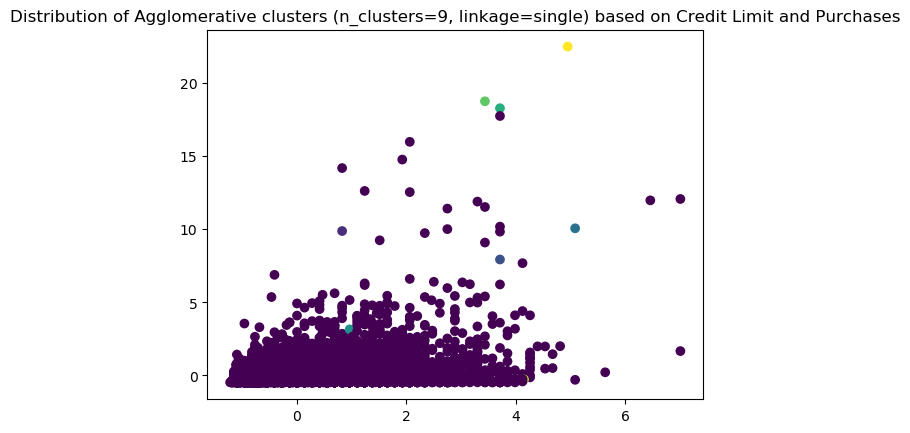

n_clusters=9, linkage=ward   Agglomerative Clustering: 0.1648934453693508


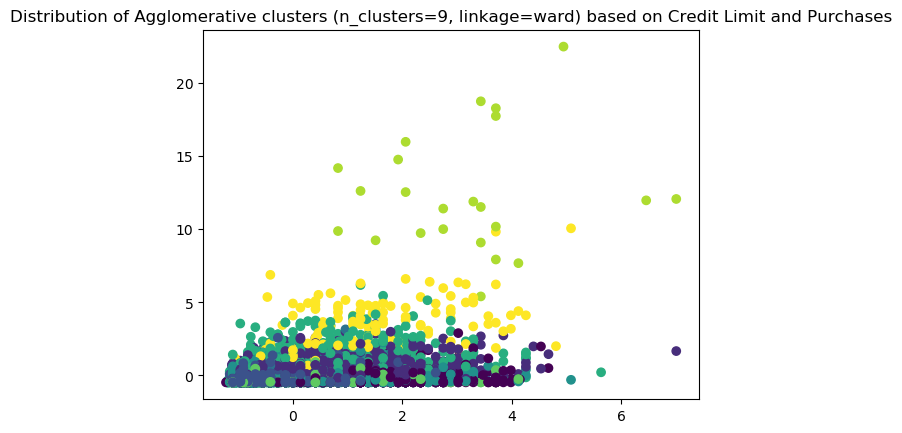

n_clusters=9, linkage=average   Agglomerative Clustering: 0.7023015649732002


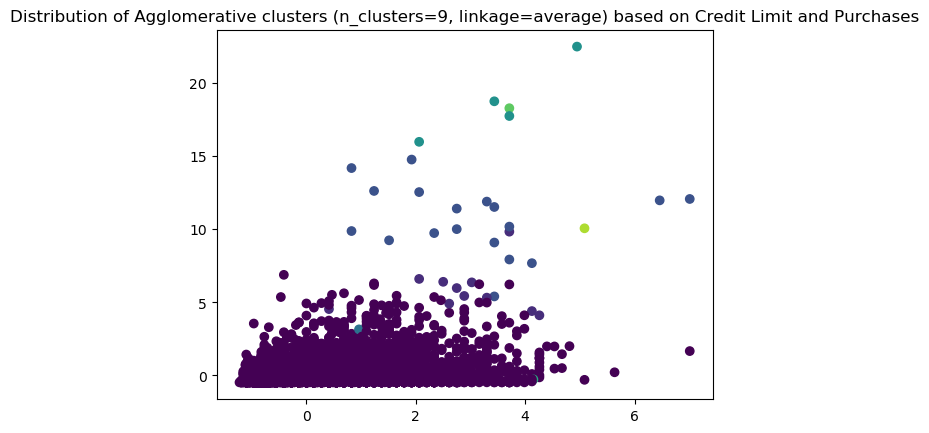

n_clusters=9, linkage=complete   Agglomerative Clustering: 0.5030745085813269


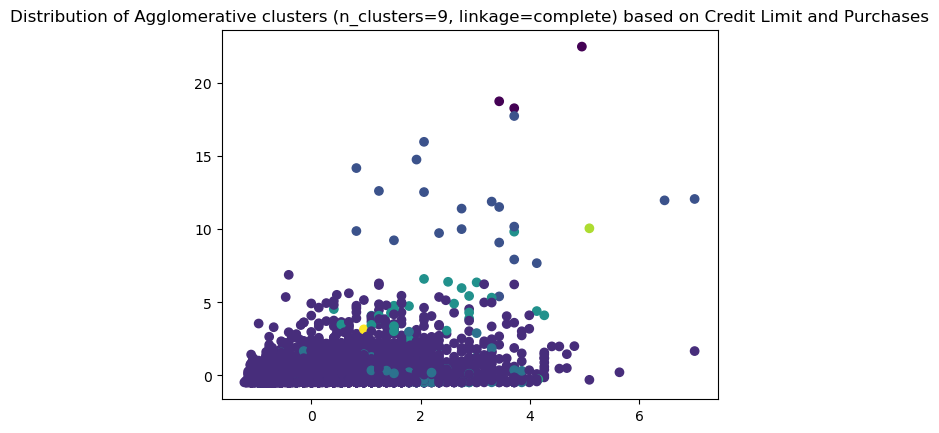

n_clusters=10, linkage=single   Agglomerative Clustering: 0.7514474288644329


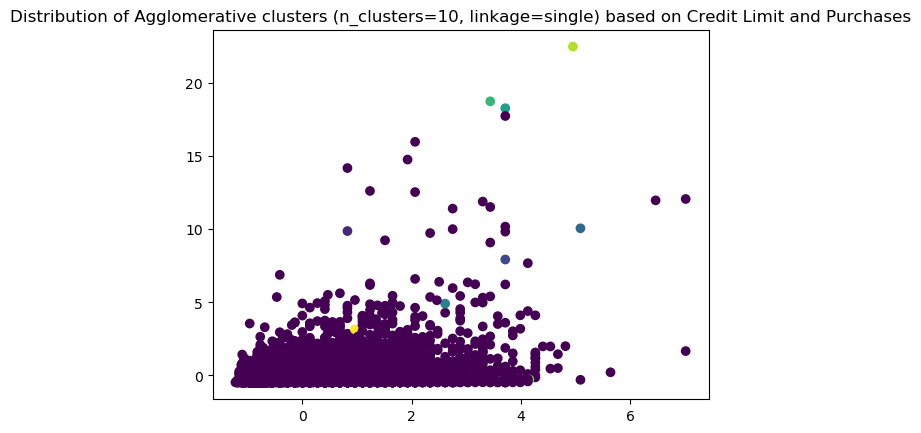

n_clusters=10, linkage=ward   Agglomerative Clustering: 0.16692428136909315


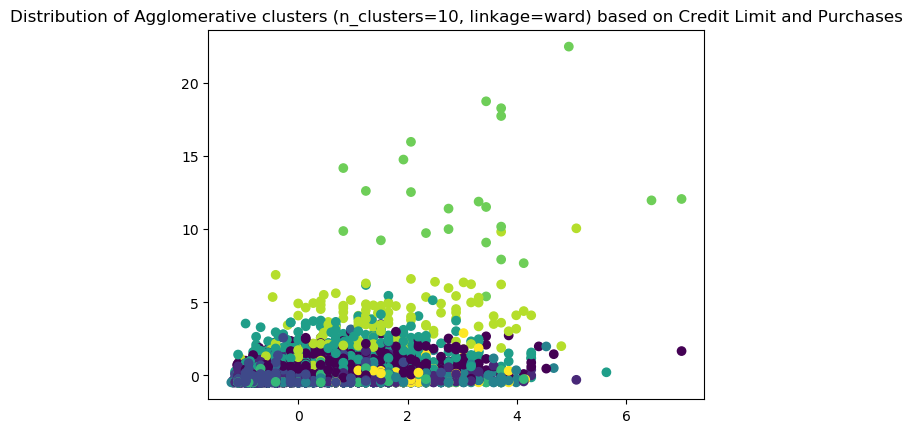

n_clusters=10, linkage=average   Agglomerative Clustering: 0.6673091161492336


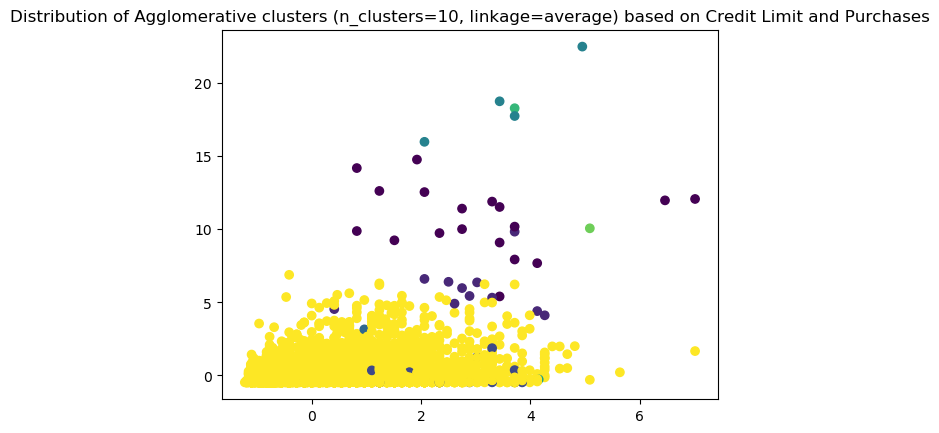

n_clusters=10, linkage=complete   Agglomerative Clustering: 0.5030500163654514


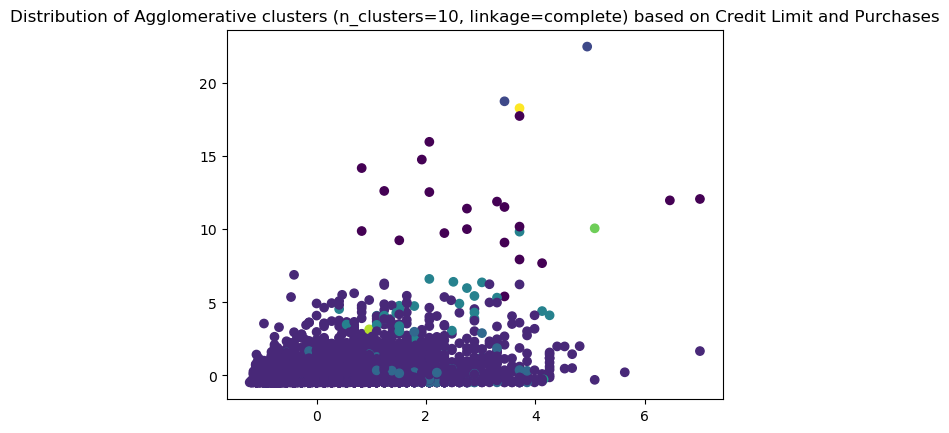

In [49]:
ac_list = []

for i in range (2,11):
    for linkage_method in ['single', 'ward', 'average', 'complete']:
        ac = AgglomerativeClustering(n_clusters=i, linkage=linkage_method)
        ac_clusters = ac.fit_predict(data)
        sil_score = silhouette_score(data, ac_clusters)
        print(f"n_clusters={i}, linkage={linkage_method}   Agglomerative Clustering: {sil_score}")
        
        ac_list.append((i, linkage_method, sil_score))

        plt.scatter(x='CREDIT_LIMIT', y='PURCHASES',data = data,c = ac_clusters)
        plt.title(f"Distribution of Agglomerative clusters (n_clusters={i}, linkage={linkage_method}) based on Credit Limit and Purchases")
        plt.show()

In [50]:
df_ac = pd.DataFrame(ac_list, columns=['number_of_clusters', 'linkage_method', 'silhouette_score'])

In [51]:
df_ac.sort_values('silhouette_score', ascending=False)

,number_of_clusters,linkage_method,silhouette_score
2,2,average,0.849691
0,2,single,0.840805
6,3,average,0.839120
4,3,single,0.837983
10,4,average,0.812952
8,4,single,0.812106
12,5,single,0.811626
14,5,average,0.808458
3,2,complete,0.786545
7,3,complete,0.786298


From the above table, the single method have generated high silhouette score; however, the plots show that it only classify a few points for a single cluster. The top 8 silhouette score both have the issues that only classify a small number of points for a single cluster, which is not good. The **complete method with n_clusters equal to 2** seems to have a well classify plot with a high silhouette score of 0.7865.

Let's see what the Dendrogram looks like for complete method. 

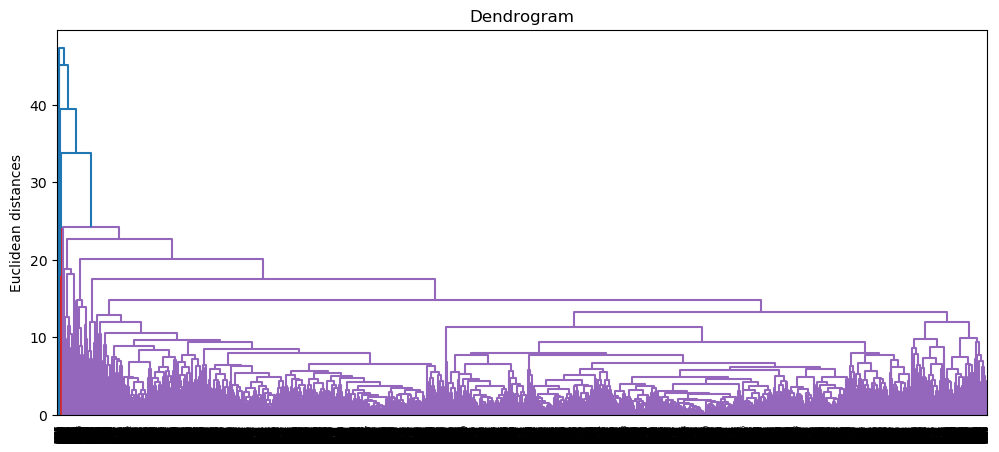

In [52]:
plt.figure(figsize=(12, 5))
dendrogram = sch.dendrogram(sch.linkage(data, method = 'complete'))
plt.title('Dendrogram')
plt.ylabel('Euclidean distances')
plt.show()

#### Density-Based Spatial Clustering of Applications with Noise (DBSCAN)

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

**DBSCAN** groups together data points that are close to each other based on distance measurement and minimum points. The **eps** parameter controls the maximum distance between two points. The **min_samples** parameter sets the number of points in a neighbourhood for a data point to be considered as a core point. 

Set min_samples as the number of features times two. 

In [53]:
min_samples = data.shape[1] * 2
min_samples

34

Using knn to find the eps value.

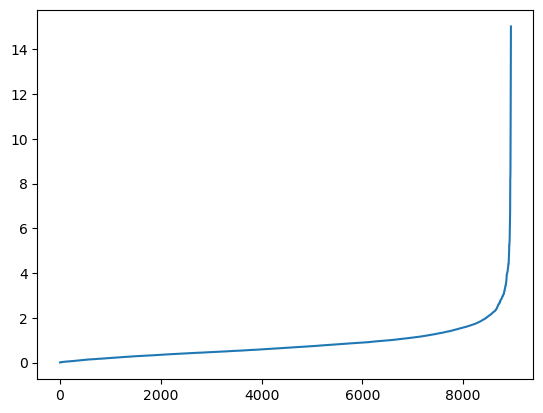

In [54]:
neighbors = NearestNeighbors(n_neighbors=min_samples)
neighbors_fit = neighbors.fit(data)
distances, indices = neighbors_fit.kneighbors(data)

distances = np.sort(distances, axis=0)
distances = distances[:,1]
plt.plot(distances)

From the plot above, the "elbow" optimization point is around 2; therefore, the optimal value for eps could be around 2. 

In [55]:
db = DBSCAN(eps=2, min_samples=min_samples, metric='euclidean')
db_clusters = db.fit_predict(data)
silhouette_score(data, db_clusters)

0.41266254910755135

Evaluate DBSCAN hyperparameters on silhouette score and plots.

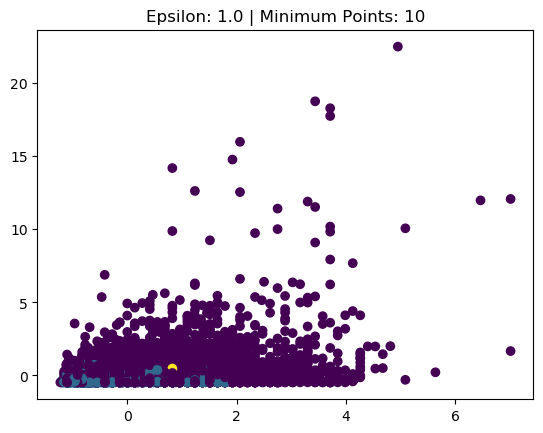

Silhouette Score:  0.08504497694210986


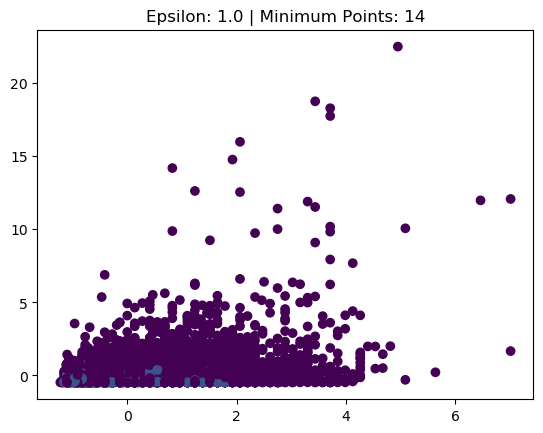

Silhouette Score:  -0.013882014663629535


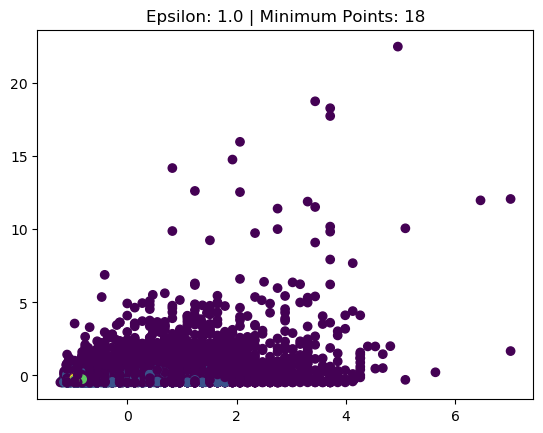

Silhouette Score:  0.042634762078436333


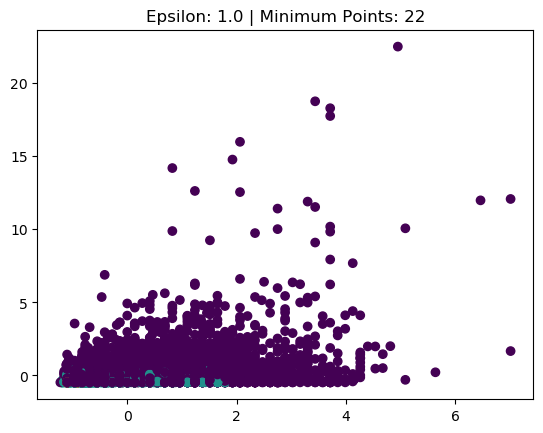

Silhouette Score:  0.012442624140333033


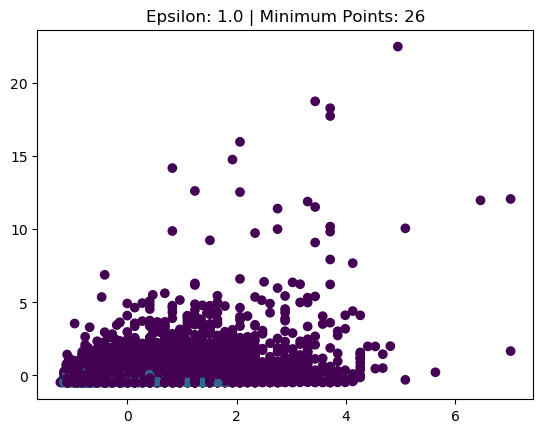

Silhouette Score:  -0.03007406704183043


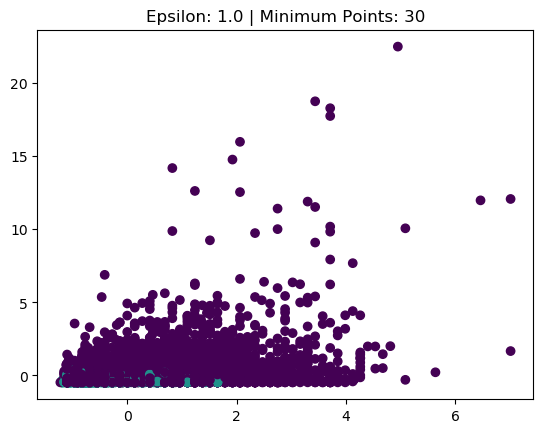

Silhouette Score:  0.054439521839534266


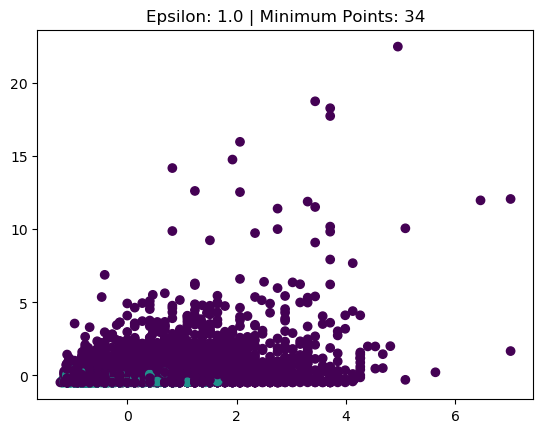

Silhouette Score:  0.05012566025146029


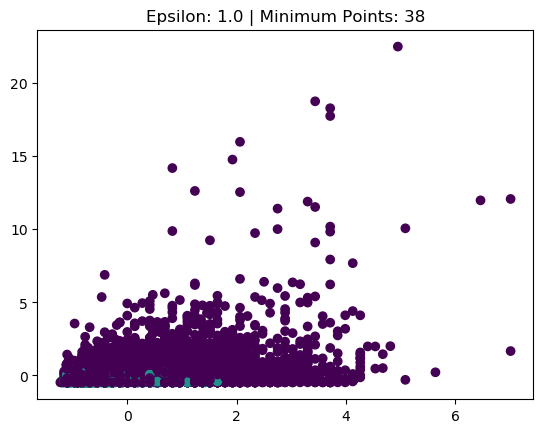

Silhouette Score:  0.0461804893935456


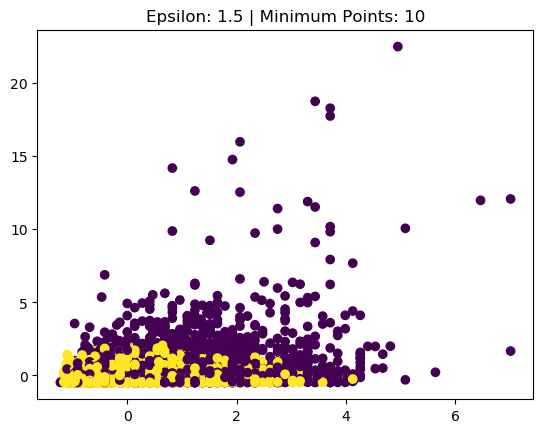

Silhouette Score:  0.33618711608154717


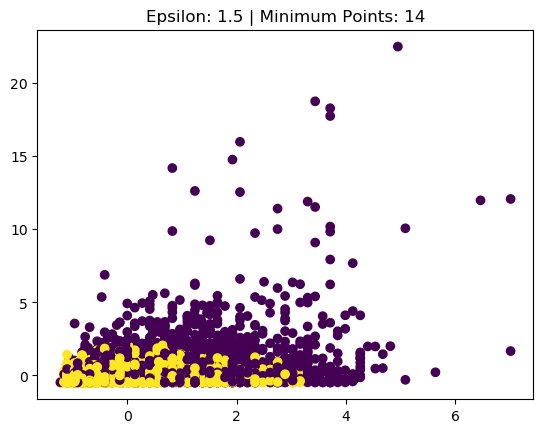

Silhouette Score:  0.3216869587664936


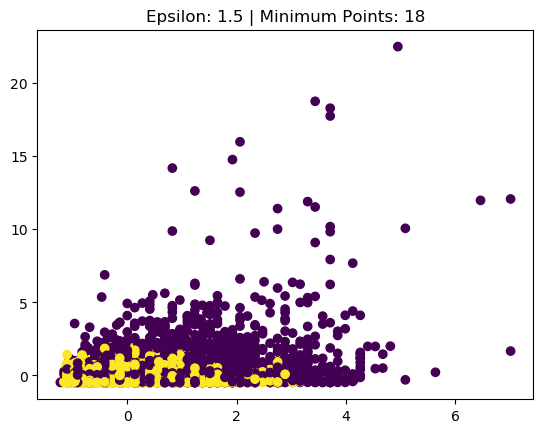

Silhouette Score:  0.3123072446150116


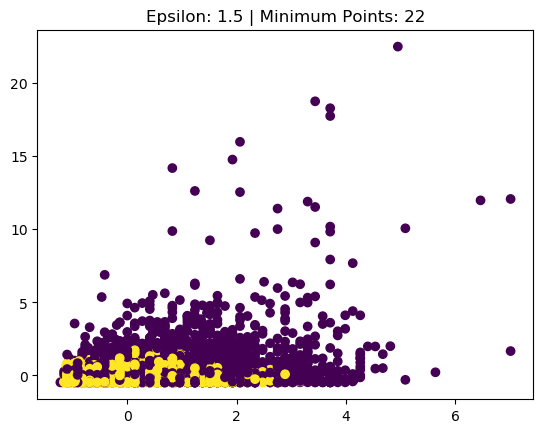

Silhouette Score:  0.3039429275509041


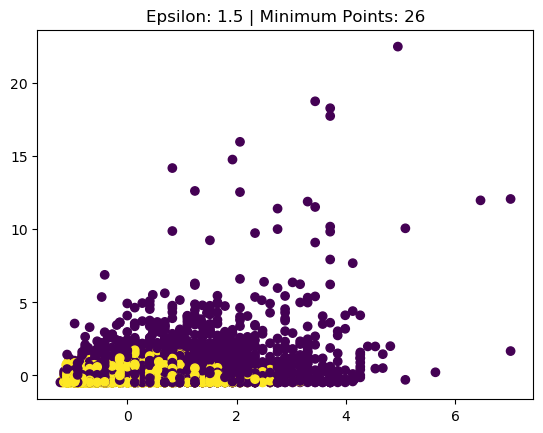

Silhouette Score:  0.2975929036630351


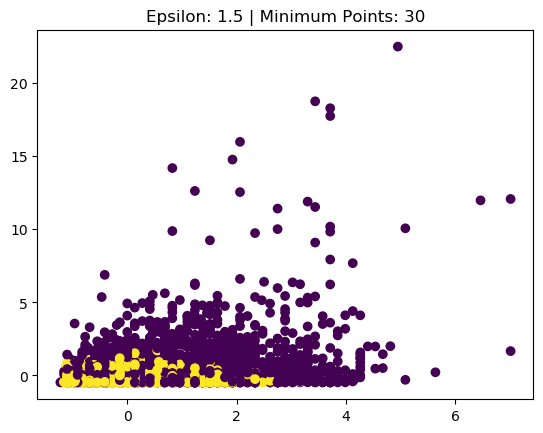

Silhouette Score:  0.29066723851517684


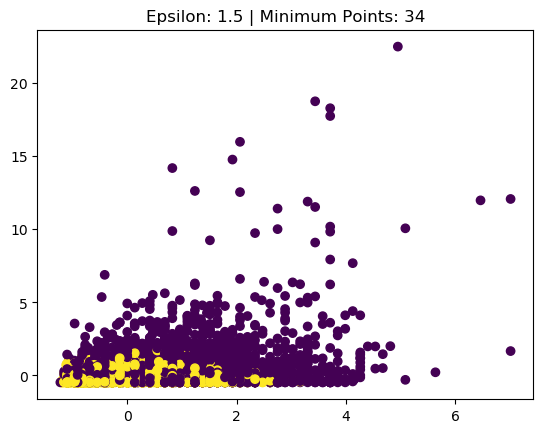

Silhouette Score:  0.28216753530099


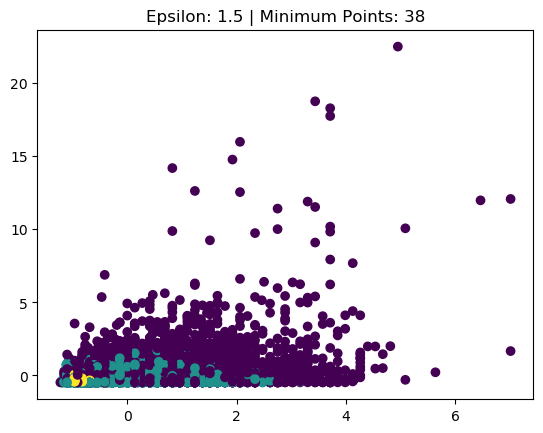

Silhouette Score:  0.16999004397116713


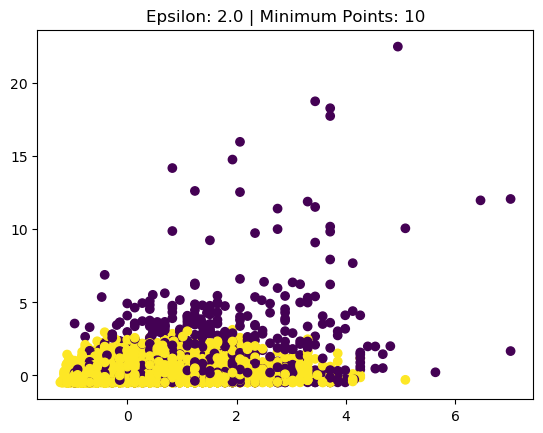

Silhouette Score:  0.46428871096845464


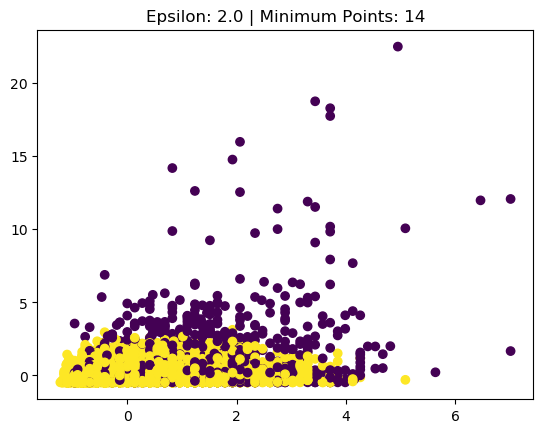

Silhouette Score:  0.4529243567463877


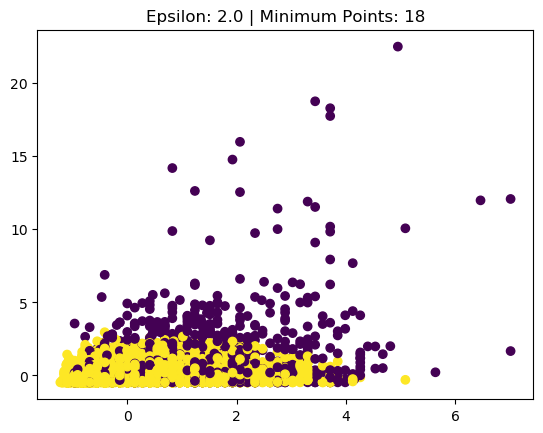

Silhouette Score:  0.4434604403205155


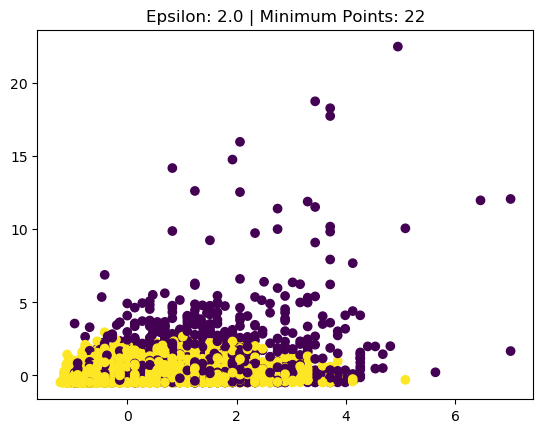

Silhouette Score:  0.4330403686036726


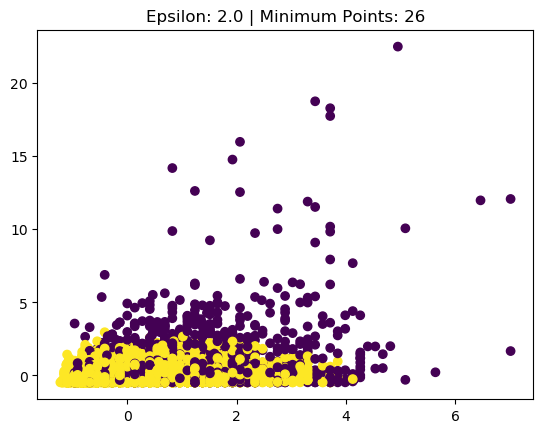

Silhouette Score:  0.42561368025633634


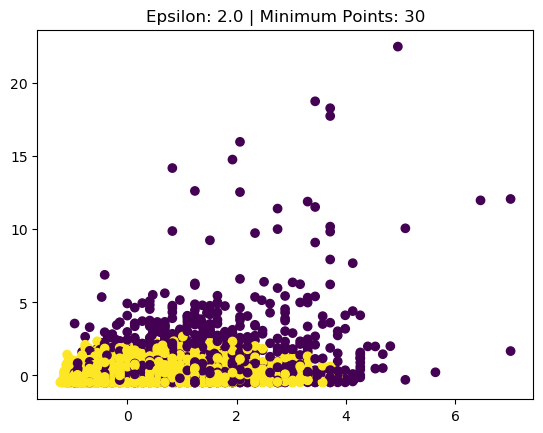

Silhouette Score:  0.41831003058623617


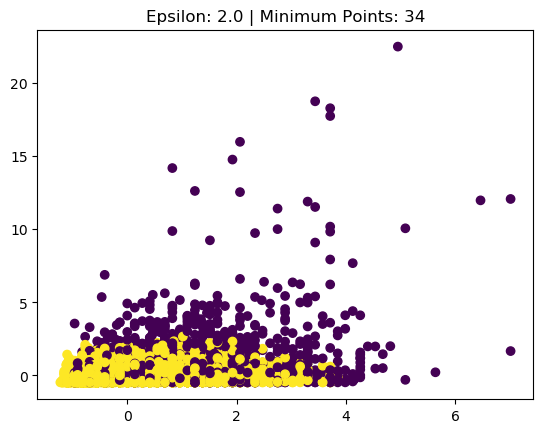

Silhouette Score:  0.41266254910755135


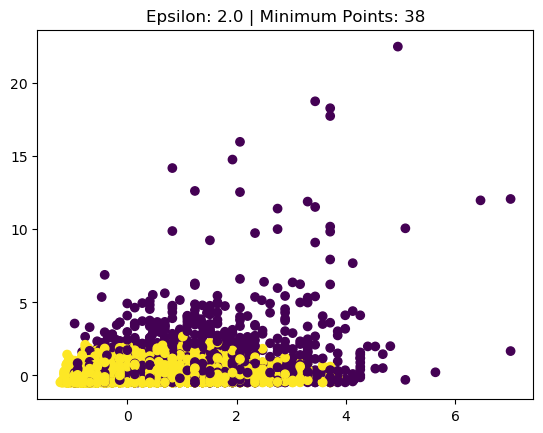

Silhouette Score:  0.40798010436425314


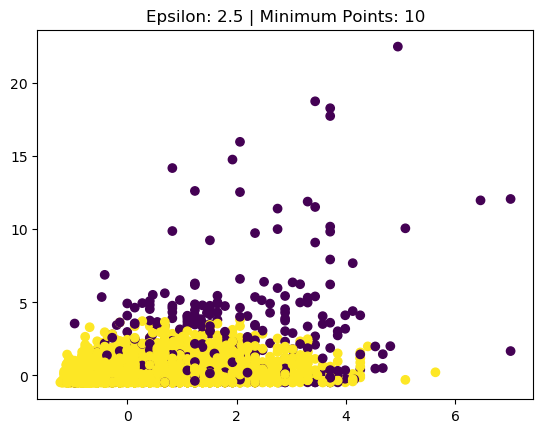

Silhouette Score:  0.5540906162134348


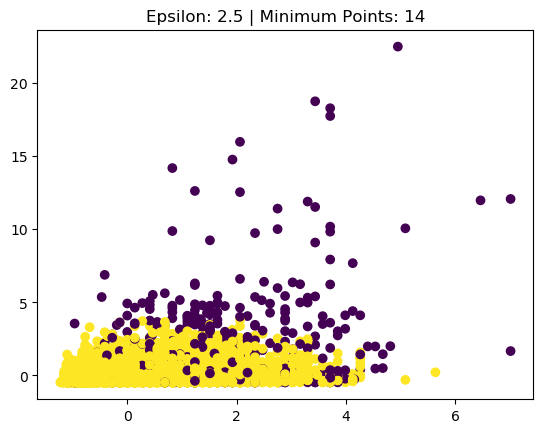

Silhouette Score:  0.5480030549991355


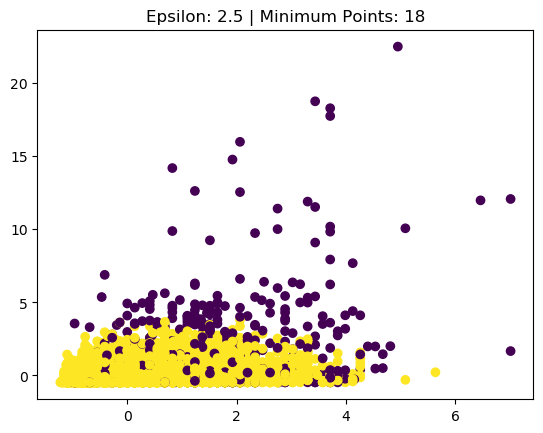

Silhouette Score:  0.5418810282513913


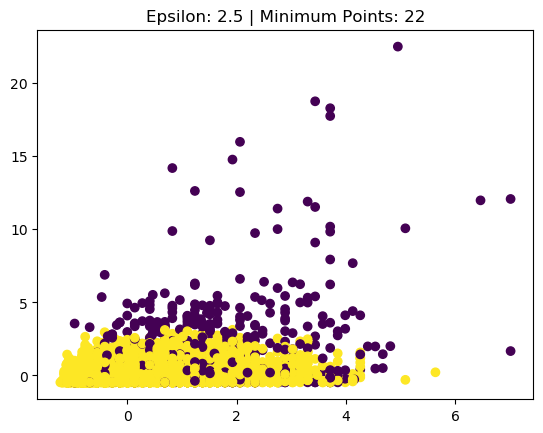

Silhouette Score:  0.5327052825006394


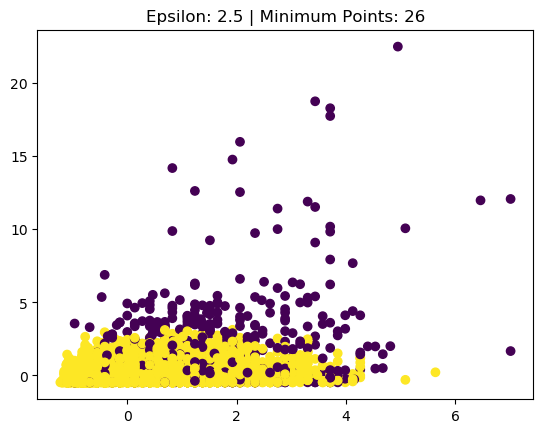

Silhouette Score:  0.5282829262733281


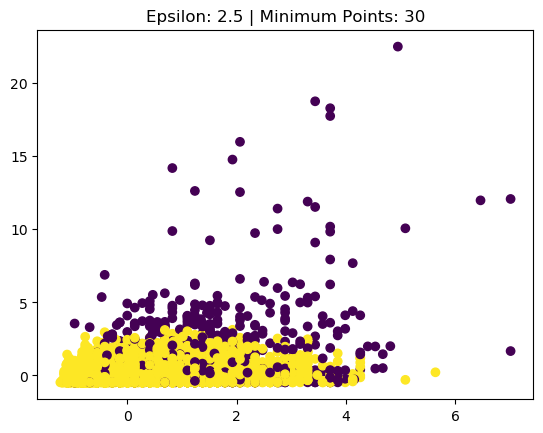

Silhouette Score:  0.5226983815563176


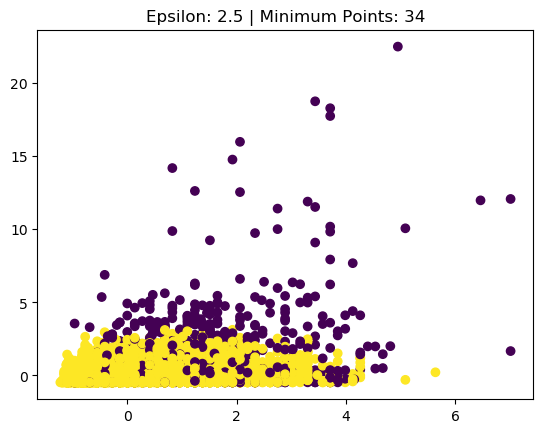

Silhouette Score:  0.5164094952690357


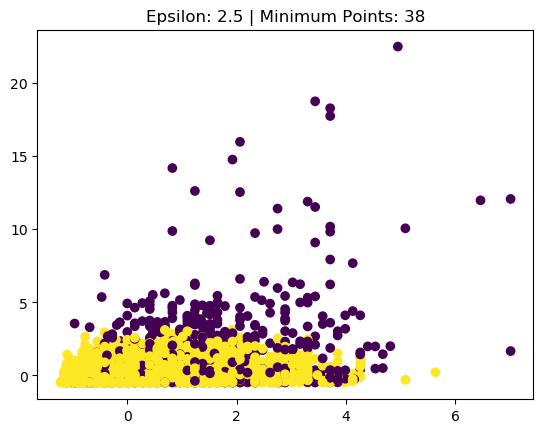

Silhouette Score:  0.5130955696036055


In [56]:
db_list = []

#Evaluate DBSCAN hyperparameters and their effect on the silhouette score
for ep in np.arange(1, 3, 0.5):
    for min_sample in range(10, 40, 4):
        db = DBSCAN(eps=ep, min_samples = min_sample)
        db_clusters = db.fit_predict(data)
        sil_score = silhouette_score(data, db_clusters)
        db_list.append((ep, min_sample, sil_score, len(set(db.labels_))))

        plt.scatter(x='CREDIT_LIMIT', y='PURCHASES',data = data,c = db_clusters)
        plt.title('Epsilon: ' + str(ep) + ' | Minimum Points: ' + str(min_sample))
        plt.show()

        print("Silhouette Score: ", sil_score)

In [57]:
df_db = pd.DataFrame(db_list, columns=['Epsilon', 'Minimum Sample', 'Silhouette Score', 'Number of clusters'])
df_db

,Epsilon,Minimum Sample,Silhouette Score,Number of clusters
0,1.0,10,0.085045,4
1,1.0,14,-0.013882,5
2,1.0,18,0.042635,5
3,1.0,22,0.012443,3
4,1.0,26,-0.030074,4
5,1.0,30,0.054440,3
6,1.0,34,0.050126,3
7,1.0,38,0.046180,3
8,1.5,10,0.336187,2
9,1.5,14,0.321687,2


In [58]:
df_db.sort_values(by=['Silhouette Score'], ascending=False).head()

,Epsilon,Minimum Sample,Silhouette Score,Number of clusters
24,2.5,10,0.554091,2
25,2.5,14,0.548003,2
26,2.5,18,0.541881,2
27,2.5,22,0.532705,2
28,2.5,26,0.528283,2


The best performance is the model with eps=2.5 and min_samples=10. The model classify the data points into two group. 

### Dimensionality Reduction

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

### Principal Component Analysis (PCA)

**PCA** is the most commonly used technique for dimensionality reduction. The first component produced in PCA comprises the majority of information or variance within the data. PCA uses a **covariance matrix** to measure the relationship between features of the dataset. The eigenvectors tell the directions of the spread of the data. The eigenvalues indicate the relative importance of these directions.

Let's see what it looks like with when using PCA in 1 dimension. 

In [59]:
# Transform the data with only the first principal component
pca = PCA(n_components=1)

# Store the transformed data in the data_transformed
data_transformed = pca.fit_transform(data.values) 

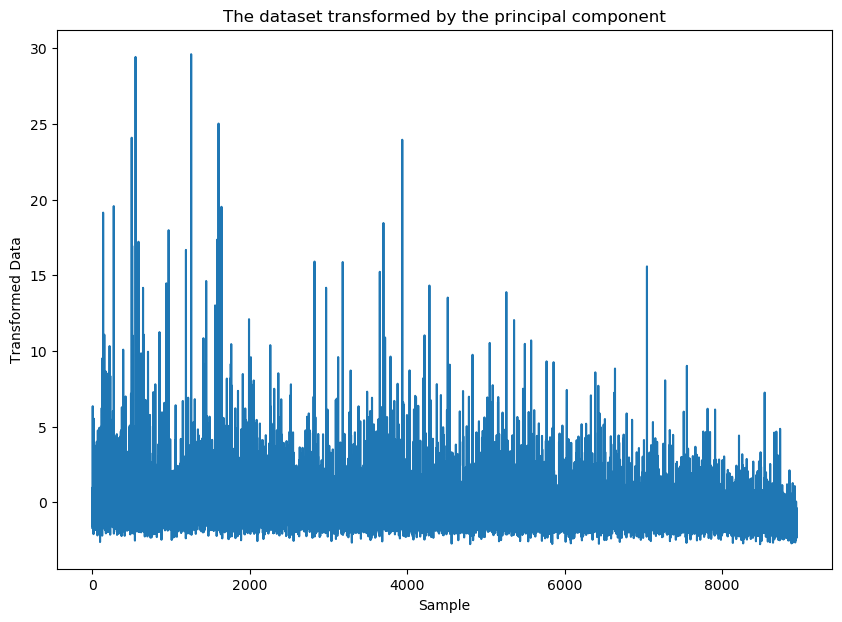

In [60]:
plt.figure(figsize=(10, 7))
plt.plot(data_transformed)
plt.xlabel('Sample')
plt.ylabel('Transformed Data')
plt.title('The dataset transformed by the principal component')
plt.show()

The transformed data are between -3 to 30, the transformed data value are going up and down in the one dimension.

In [61]:
print("Original shape:   ", data.shape)
print("Transformed shape:", data_transformed.shape)

Original shape:    (8949, 17)
Transformed shape: (8949, 1)


**PCA in 2 Dimensions**

In [62]:
# Transform the data with only the first principal component
pca2 = PCA(n_components=2)

# Store the transformed data in the data_transformed
data_pca2 = pca2.fit_transform(data.values) 

In [63]:
print("Original shape:   ", data.shape)
print("Transformed shape:", data_pca2.shape)

Original shape:    (8949, 17)
Transformed shape: (8949, 2)


In [64]:
data_pca2 = pd.DataFrame(data_pca2)

In [65]:
data_pca2.iloc[:,0]

0      -1.682361
1      -1.138968
2       0.969376
3      -0.873814
4      -1.599681
          ...   
8944   -0.359267
8945   -0.564022
8946   -0.925785
8947   -2.336210
8948   -0.556041
Name: 0, Length: 8949, dtype: float64

Let's check what it looks like with a k-means clustering of n_clusters =8. 

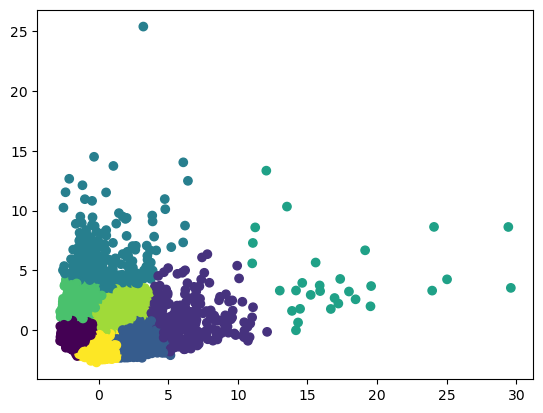

In [66]:
plt.scatter(data_pca2.iloc[:,0],data_pca2.iloc[:,1],
            c = KMeans(n_clusters=8).fit_predict(data_pca2), cmap =None) 
plt.show()

Looks like it has better performance to classify customers into 8 groups with PCA method. 

#### PCA K-means

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

k=2 K-Means Clustering: 0.4648388895825171


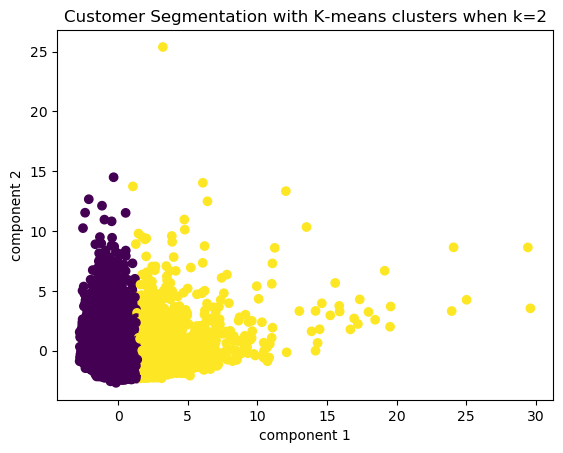

k=3 K-Means Clustering: 0.4522981030357994


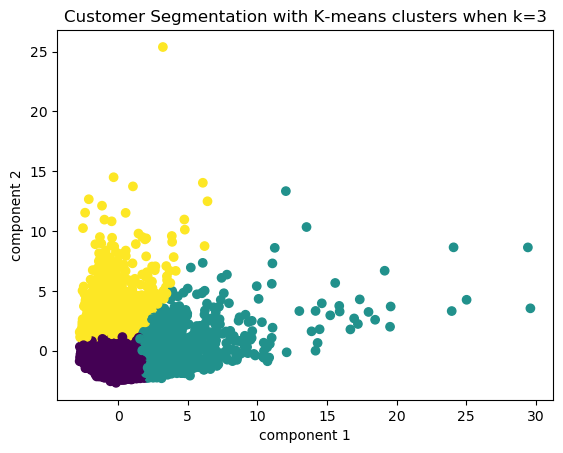

k=4 K-Means Clustering: 0.40763316701596436


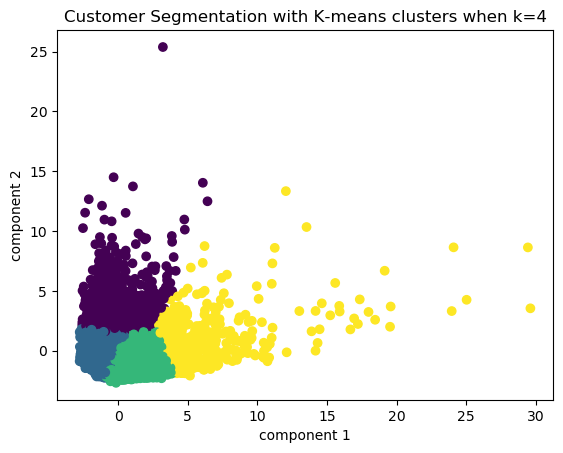

k=5 K-Means Clustering: 0.4010285069965804


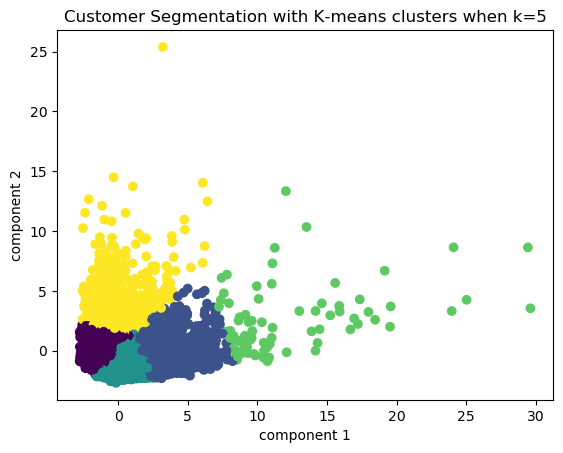

k=6 K-Means Clustering: 0.3832113480741601


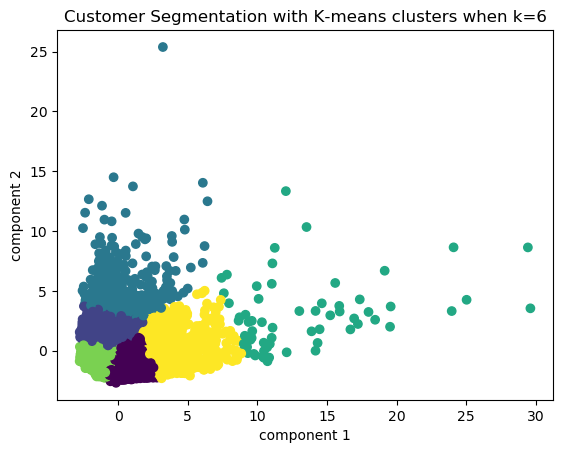

k=7 K-Means Clustering: 0.37864676700187855


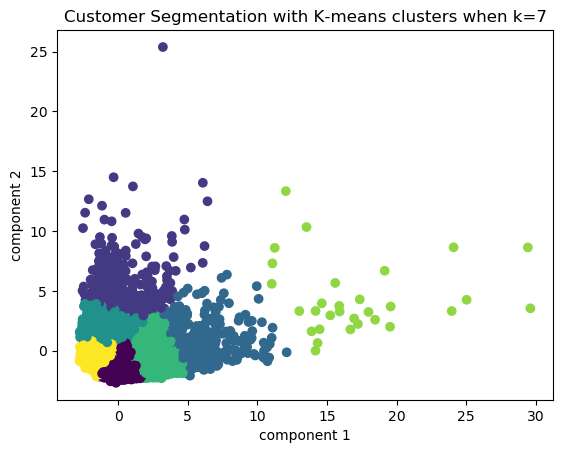

k=8 K-Means Clustering: 0.3938322095862114


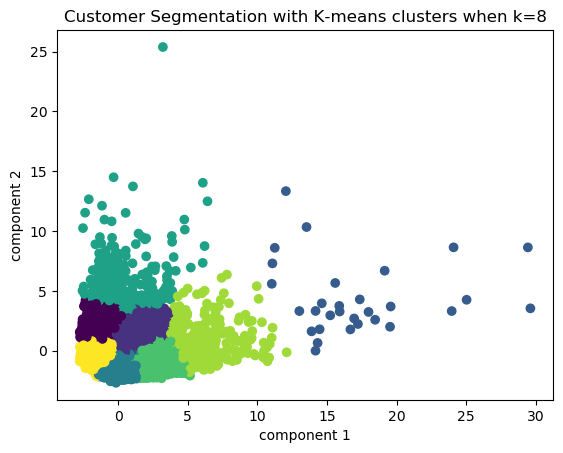

k=9 K-Means Clustering: 0.371752400854586


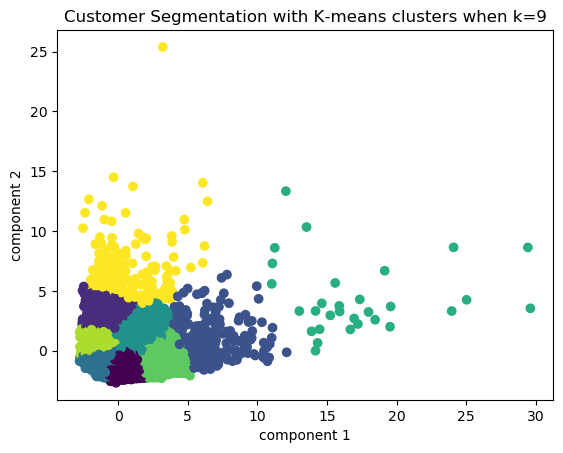

k=10 K-Means Clustering: 0.3644457062541696


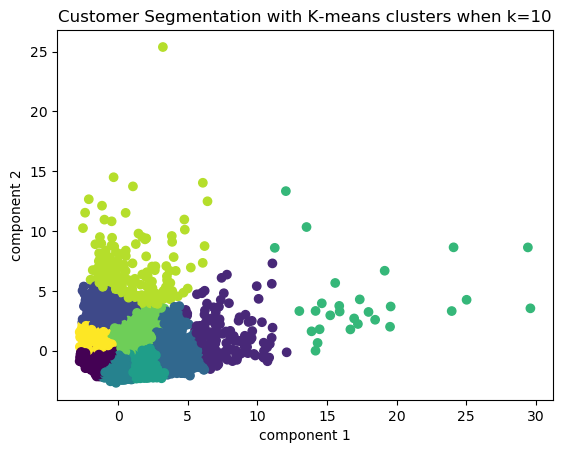

In [67]:
km_list_pca = []
for i in range (2,11):
    km = KMeans(i)
    km_clusters = km.fit_predict(data_pca2)
    sil_score = silhouette_score(data_pca2, km_clusters)
    print(f"k={i} K-Means Clustering: {sil_score}")
    
    km_list_pca.append((i, sil_score))
    
    plt.scatter(data_pca2.iloc[:,0],data_pca2.iloc[:,1], c = km_clusters, cmap =None)
    plt.title(f"Customer Segmentation with K-means clusters when k={i}")
    plt.xlabel('component 1')
    plt.ylabel('component 2')
    plt.show()

df_km_pca = pd.DataFrame(km_list_pca, columns=['k', 'silhouette_score'])

In [68]:
df_km_pca.sort_values('silhouette_score', ascending=False)

,k,silhouette_score
0,2,0.464839
1,3,0.452298
2,4,0.407633
3,5,0.401029
6,8,0.393832
4,6,0.383211
5,7,0.378647
7,9,0.371752
8,10,0.364446


Compare with the k-means without PCA scaled, the silhouette_score of PCA using the k-means method is much **better**. The best one is when k is equal to **2**. 

#### PCA Hierarchical Clustering

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

n_clusters=2, linkage=single   Agglomerative Clustering: 0.8736727809002071


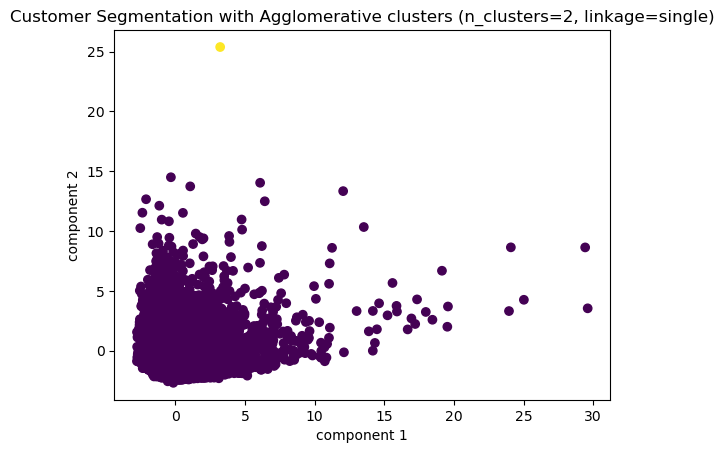

n_clusters=2, linkage=ward   Agglomerative Clustering: 0.3587633210425497


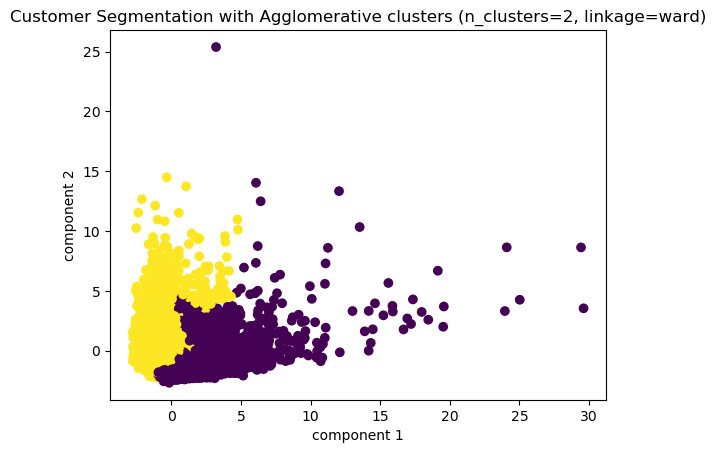

n_clusters=2, linkage=average   Agglomerative Clustering: 0.8736727809002071


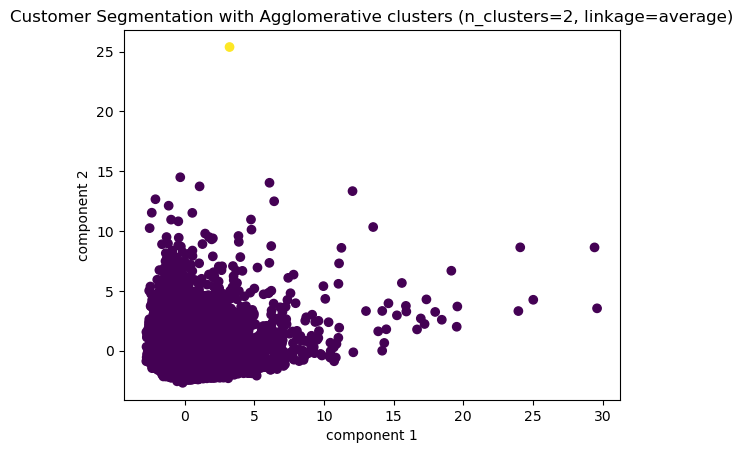

n_clusters=2, linkage=complete   Agglomerative Clustering: 0.8801175146313748


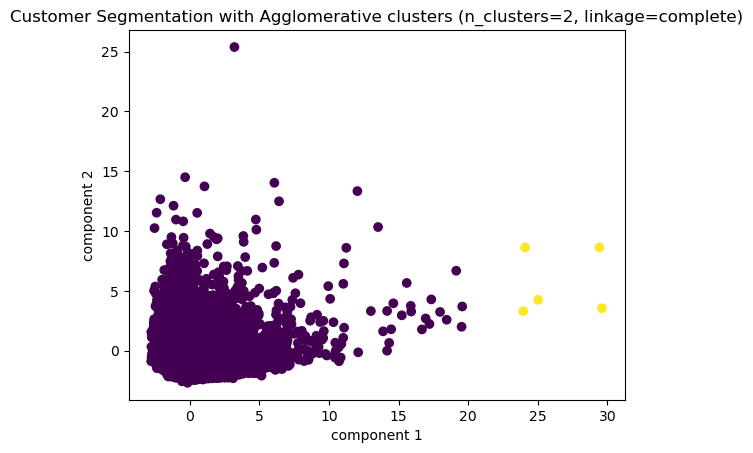

n_clusters=3, linkage=single   Agglomerative Clustering: 0.8717912306703616


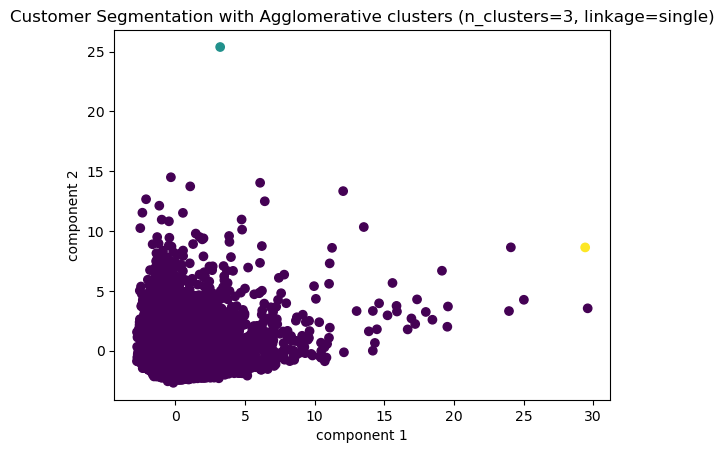

n_clusters=3, linkage=ward   Agglomerative Clustering: 0.35824510887129646


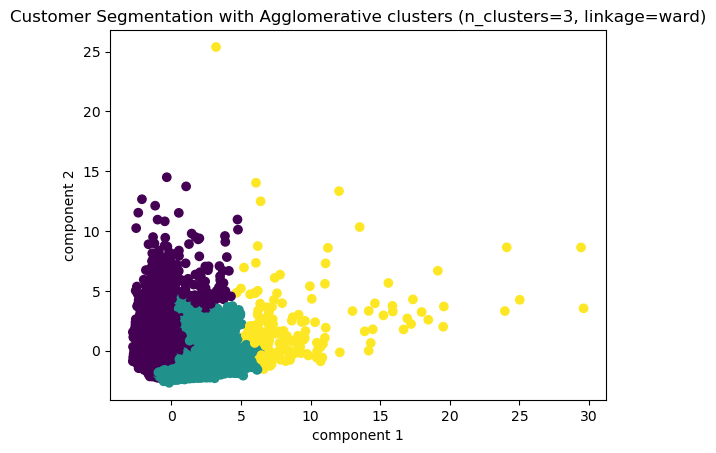

n_clusters=3, linkage=average   Agglomerative Clustering: 0.8277887570388014


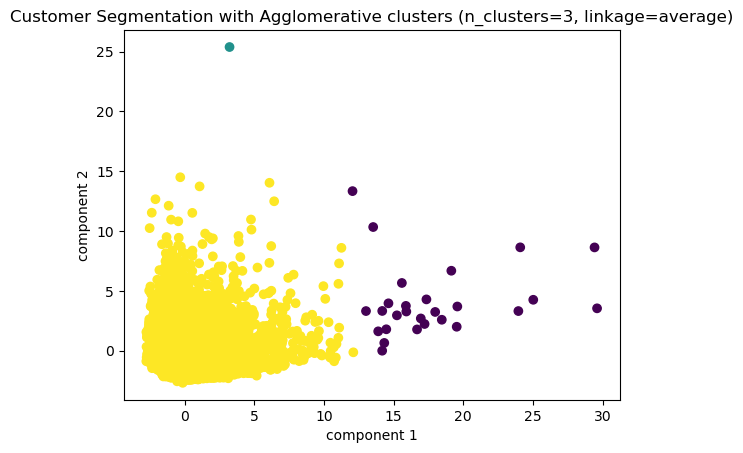

n_clusters=3, linkage=complete   Agglomerative Clustering: 0.8699532963877434


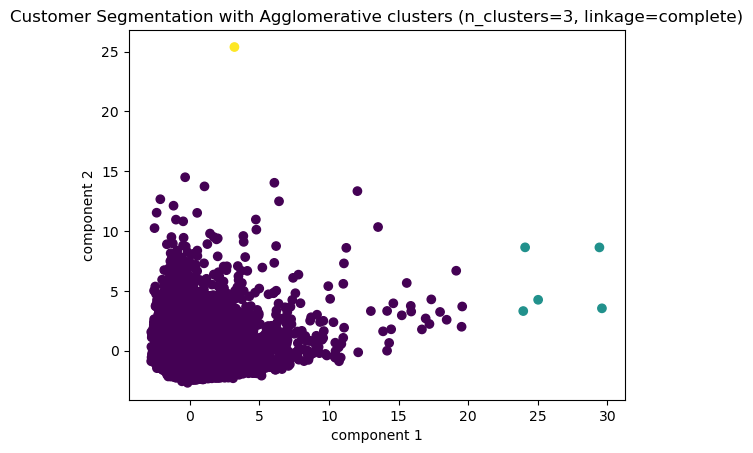

n_clusters=4, linkage=single   Agglomerative Clustering: 0.8714914550534195


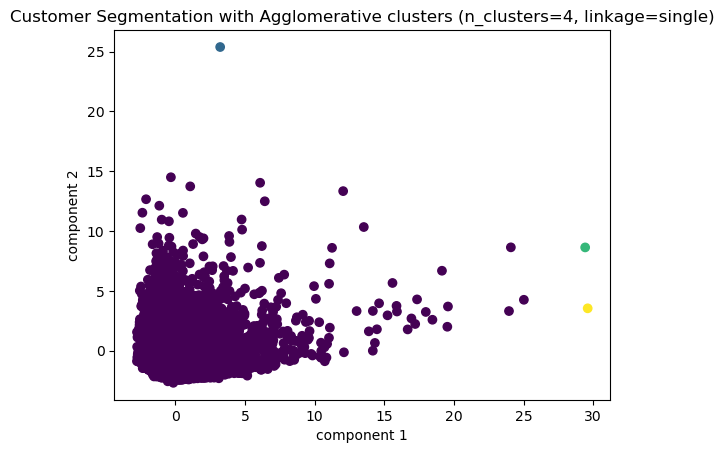

n_clusters=4, linkage=ward   Agglomerative Clustering: 0.38129954855712545


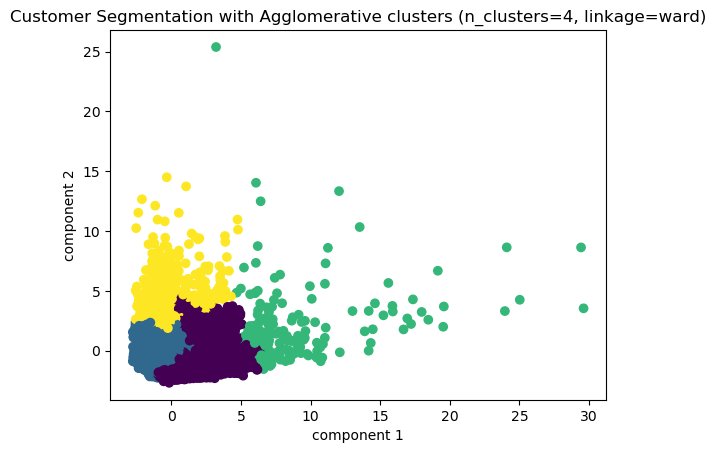

n_clusters=4, linkage=average   Agglomerative Clustering: 0.8068584504607084


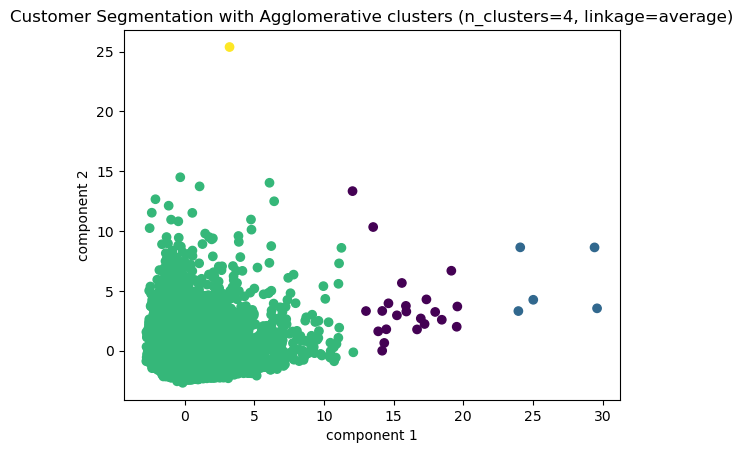

n_clusters=4, linkage=complete   Agglomerative Clustering: 0.6811901887559892


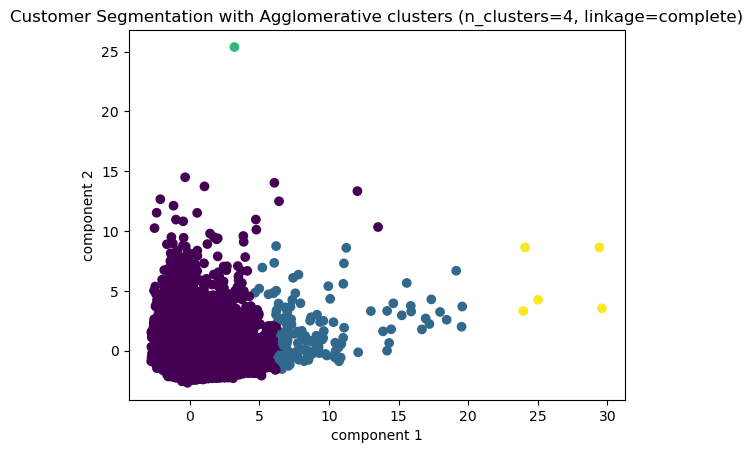

n_clusters=5, linkage=single   Agglomerative Clustering: 0.8660871239972211


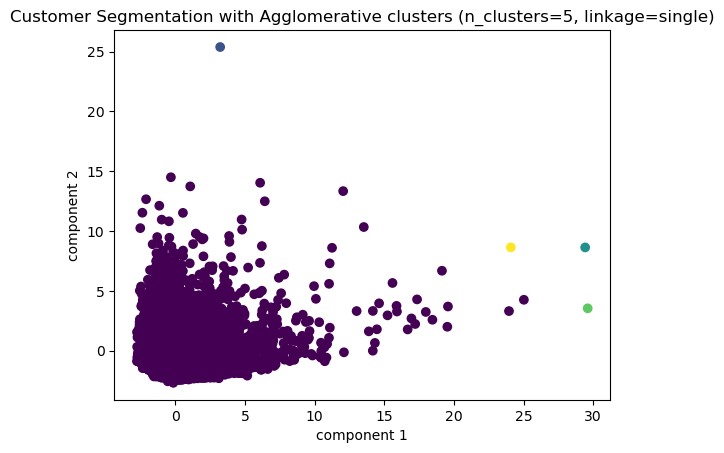

n_clusters=5, linkage=ward   Agglomerative Clustering: 0.3606714677079056


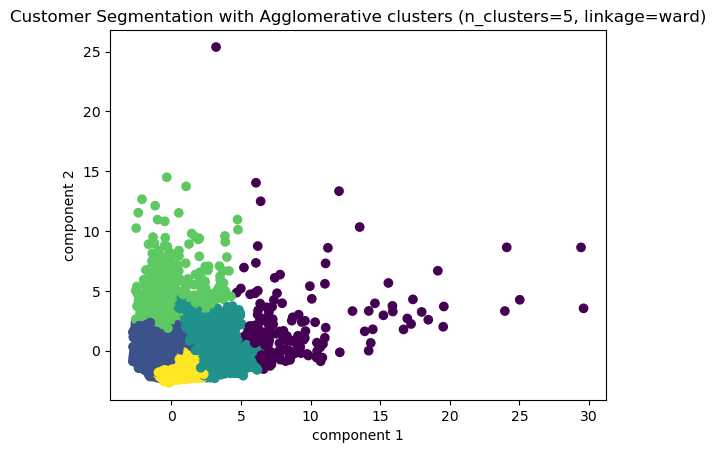

n_clusters=5, linkage=average   Agglomerative Clustering: 0.8023278062582475


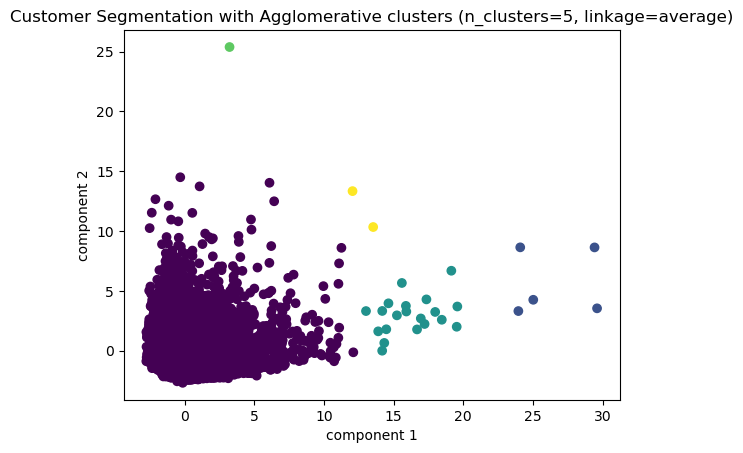

n_clusters=5, linkage=complete   Agglomerative Clustering: 0.6247620202642238


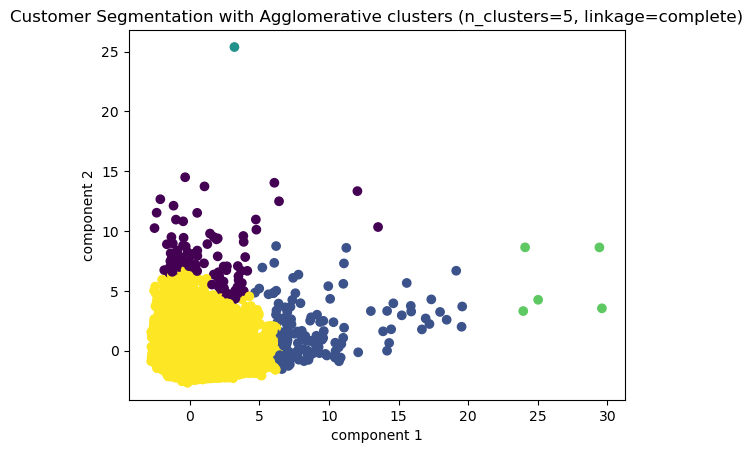

n_clusters=6, linkage=single   Agglomerative Clustering: 0.8632278551073872


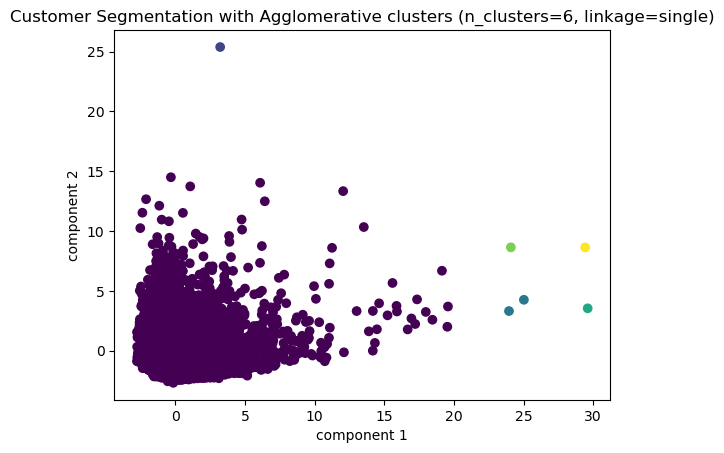

n_clusters=6, linkage=ward   Agglomerative Clustering: 0.36258552135429817


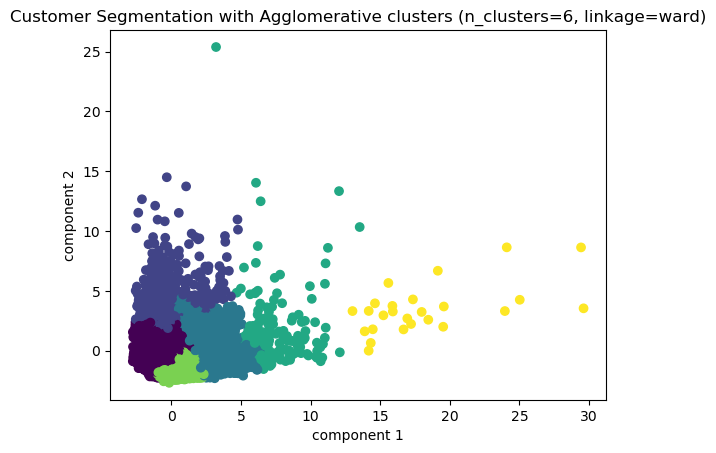

n_clusters=6, linkage=average   Agglomerative Clustering: 0.646101502384973


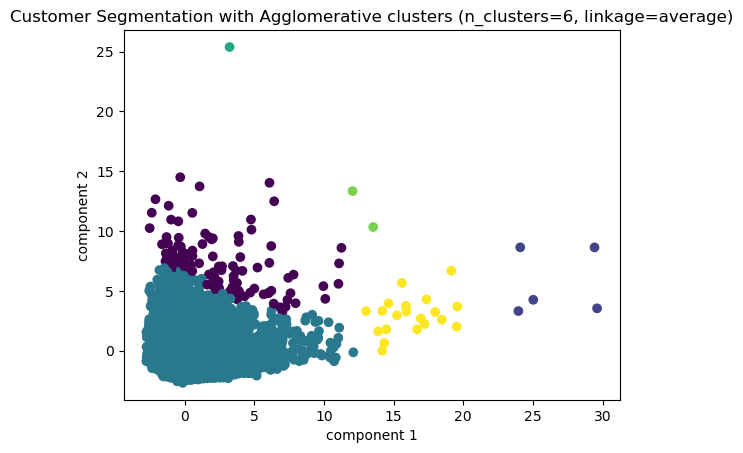

n_clusters=6, linkage=complete   Agglomerative Clustering: 0.6119824770392213


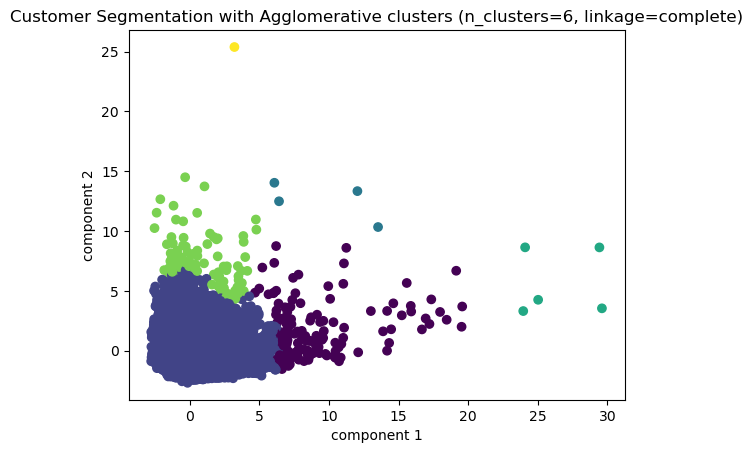

n_clusters=7, linkage=single   Agglomerative Clustering: 0.8176192529468731


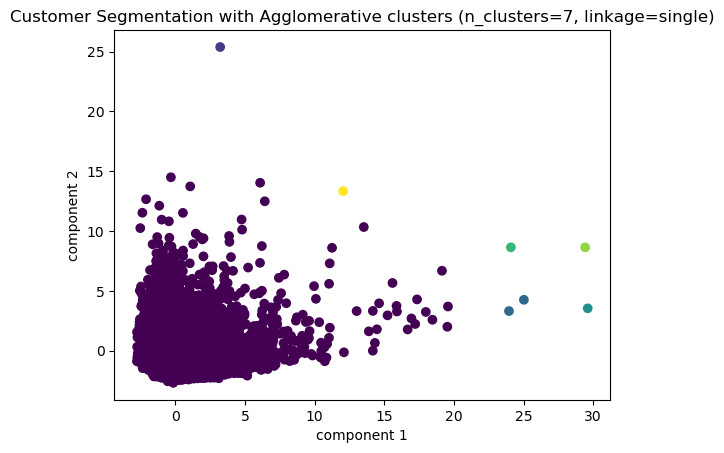

n_clusters=7, linkage=ward   Agglomerative Clustering: 0.3100908065829832


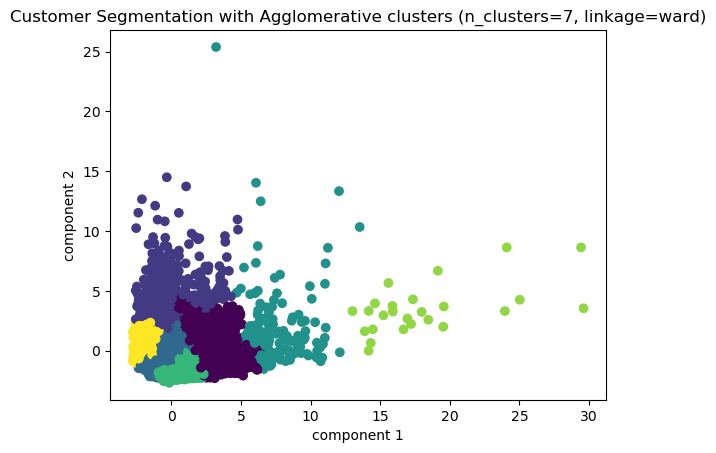

n_clusters=7, linkage=average   Agglomerative Clustering: 0.6170684089927188


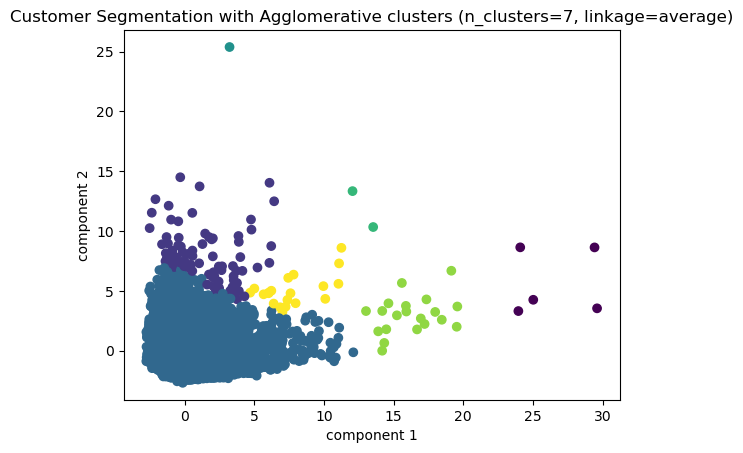

n_clusters=7, linkage=complete   Agglomerative Clustering: 0.5921934386694968


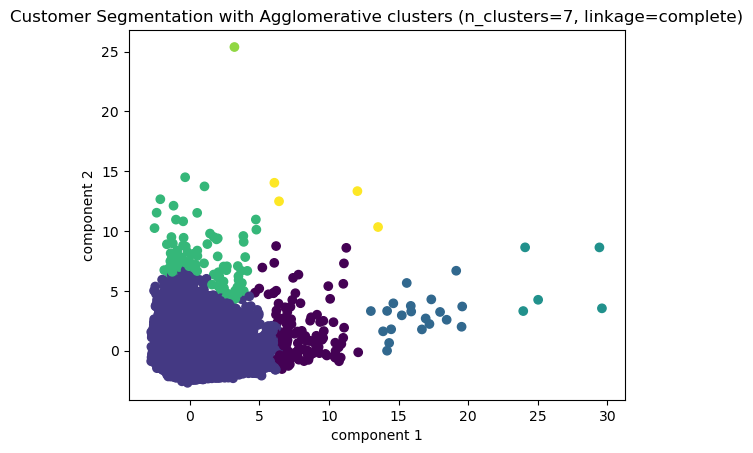

n_clusters=8, linkage=single   Agglomerative Clustering: 0.8167737181751579


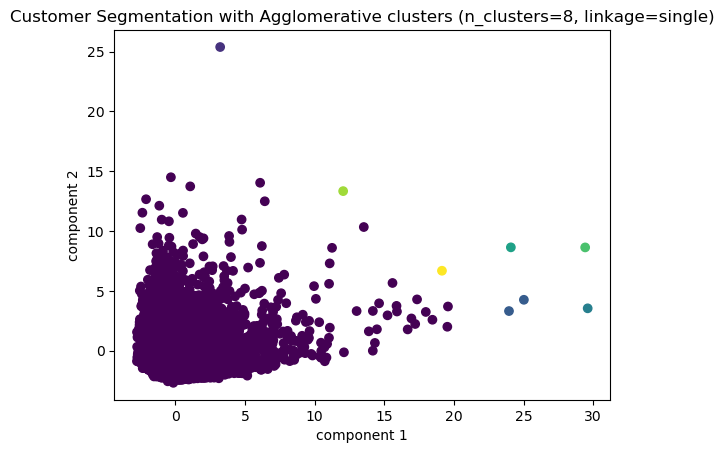

n_clusters=8, linkage=ward   Agglomerative Clustering: 0.31501033354873675


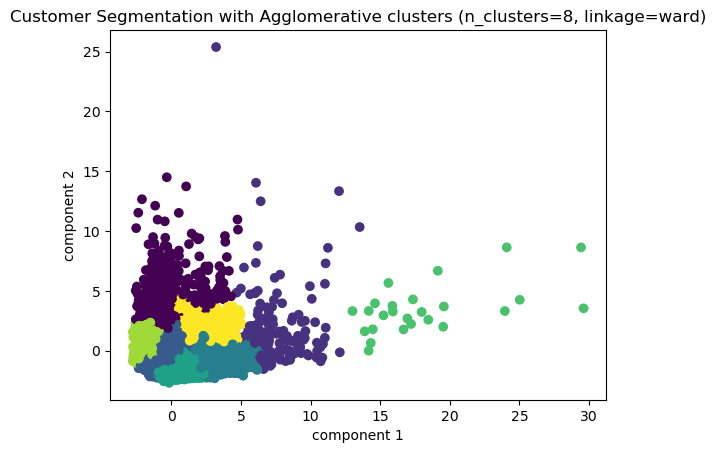

n_clusters=8, linkage=average   Agglomerative Clustering: 0.6168535959853301


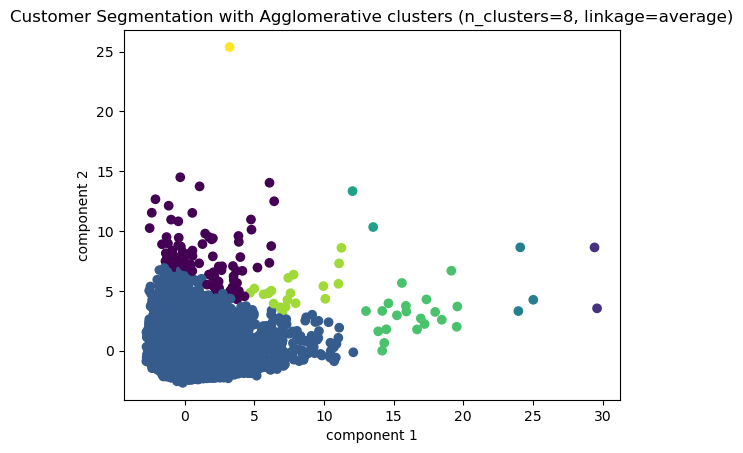

n_clusters=8, linkage=complete   Agglomerative Clustering: 0.5805347222215641


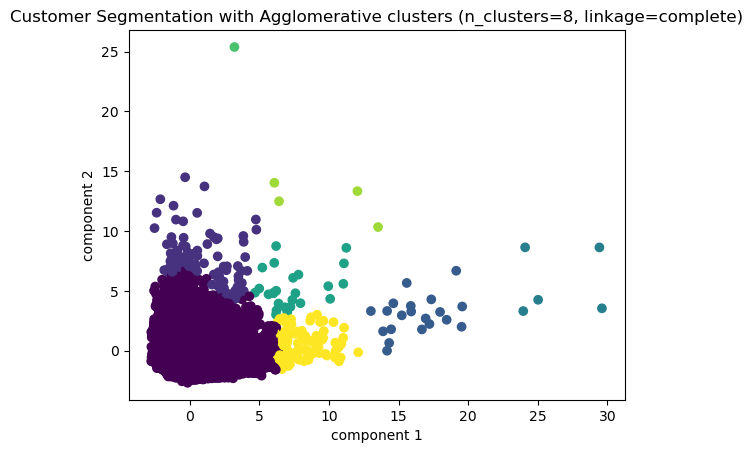

n_clusters=9, linkage=single   Agglomerative Clustering: 0.8067701179465733


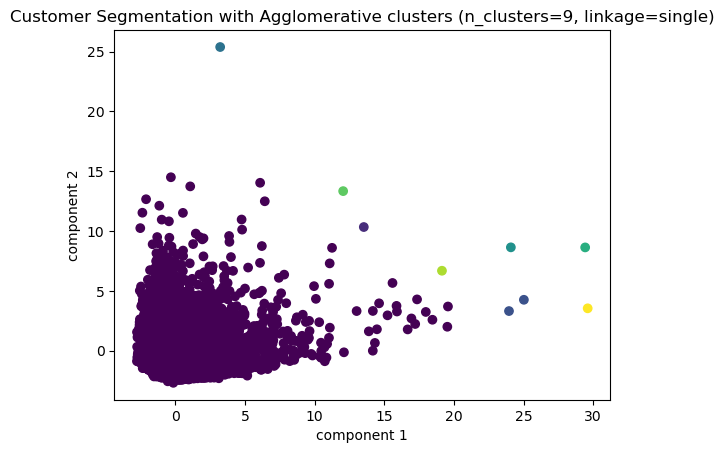

n_clusters=9, linkage=ward   Agglomerative Clustering: 0.3129757522613688


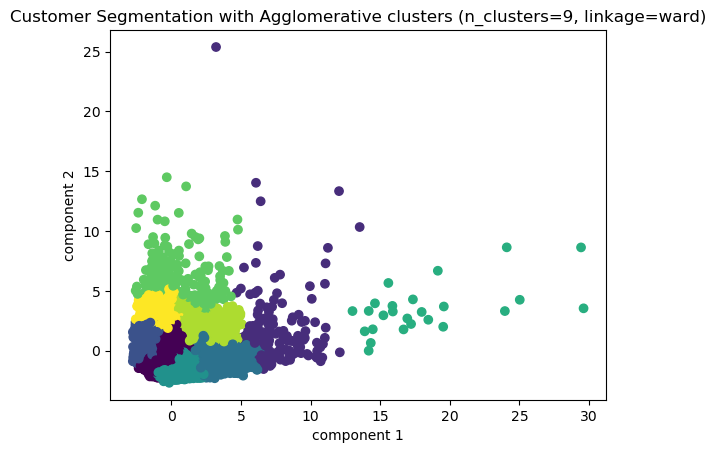

n_clusters=9, linkage=average   Agglomerative Clustering: 0.6021485822531096


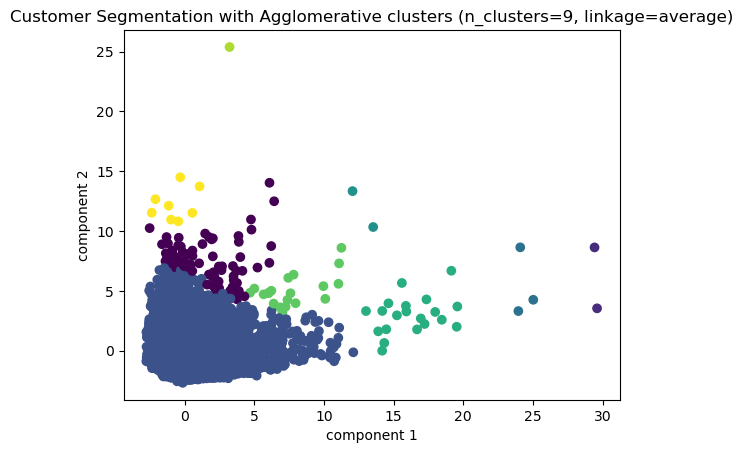

n_clusters=9, linkage=complete   Agglomerative Clustering: 0.37487250128948296


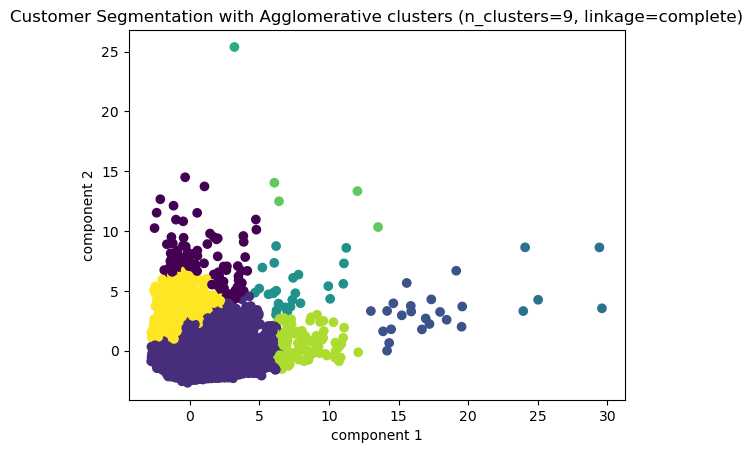

n_clusters=10, linkage=single   Agglomerative Clustering: 0.7643125817139251


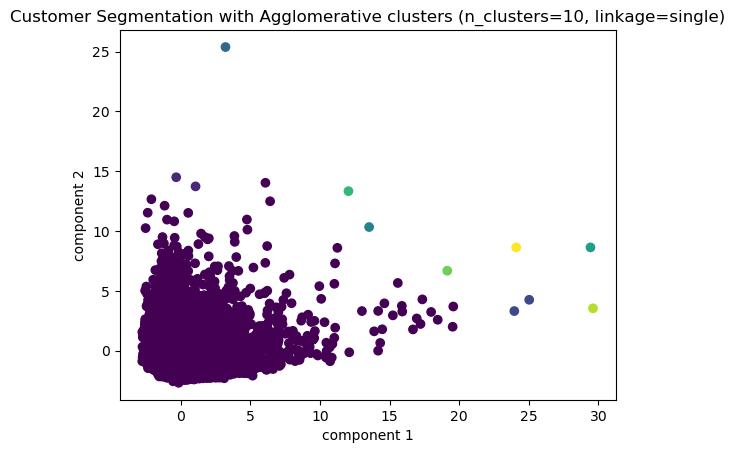

n_clusters=10, linkage=ward   Agglomerative Clustering: 0.3143232591571389


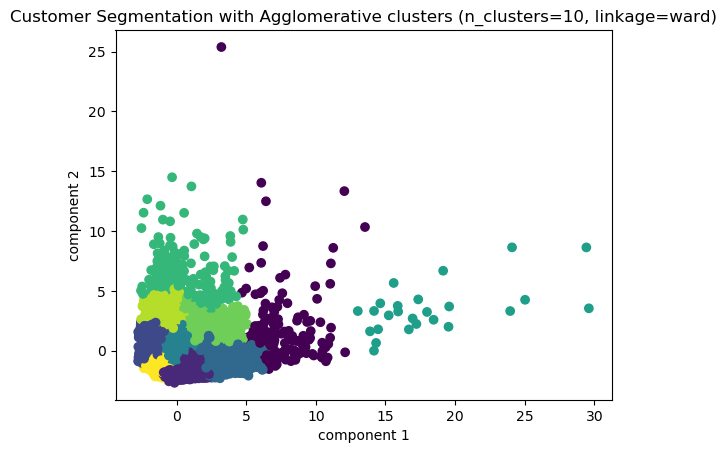

n_clusters=10, linkage=average   Agglomerative Clustering: 0.582341633615677


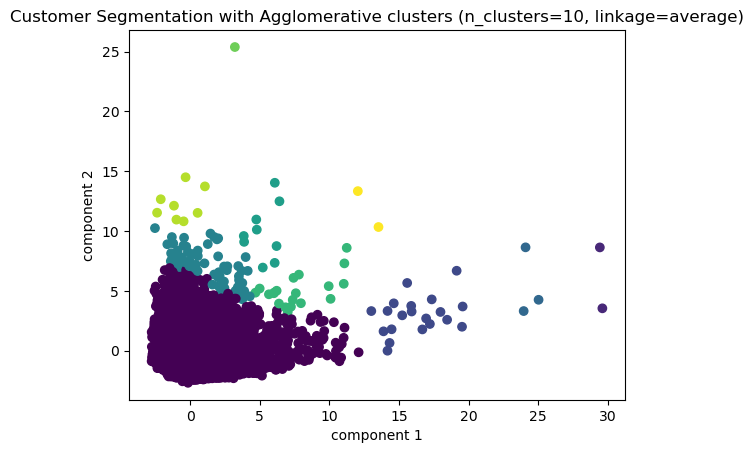

n_clusters=10, linkage=complete   Agglomerative Clustering: 0.37253140969822063


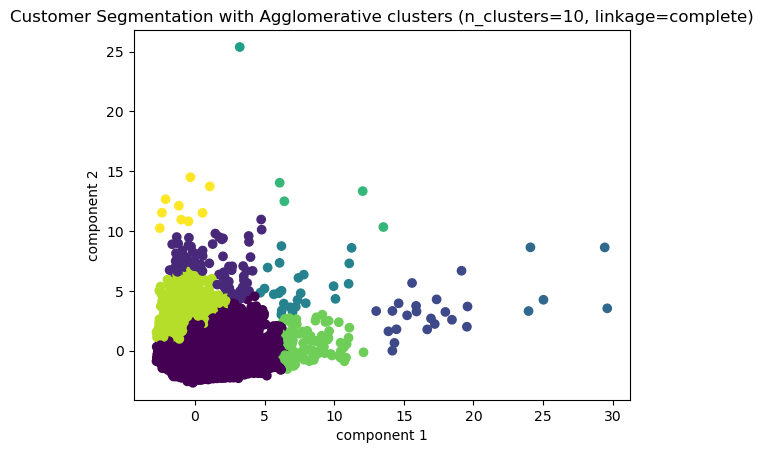

In [69]:
ac_list_pca = []

for i in range (2,11):
    for linkage_method in ['single', 'ward', 'average', 'complete']:
        ac = AgglomerativeClustering(n_clusters=i, linkage=linkage_method)
        ac_clusters = ac.fit_predict(data_pca2)
        sil_score = silhouette_score(data_pca2, ac_clusters)
        print(f"n_clusters={i}, linkage={linkage_method}   Agglomerative Clustering: {sil_score}")
        
        ac_list_pca.append((i, linkage_method, sil_score))

        plt.scatter(data_pca2.iloc[:,0],data_pca2.iloc[:,1], c = ac_clusters, cmap =None)
        plt.title(f"Customer Segmentation with Agglomerative clusters (n_clusters={i}, linkage={linkage_method})")
        plt.xlabel('component 1')
        plt.ylabel('component 2')
        plt.show()

df_ac_pca = pd.DataFrame(ac_list_pca, columns=['number_of_clusters', 'linkage_method', 'silhouette_score'])

In [70]:
df_ac_pca.sort_values('silhouette_score', ascending=False)

,number_of_clusters,linkage_method,silhouette_score
3,2,complete,0.880118
0,2,single,0.873673
2,2,average,0.873673
4,3,single,0.871791
8,4,single,0.871491
7,3,complete,0.869953
12,5,single,0.866087
16,6,single,0.863228
6,3,average,0.827789
20,7,single,0.817619


After comparing with the plots and the table above, the **ward** linkage method seems to have a better distribution of clusters. The ward methods with **4 clusters** have the highest silhouette score. 

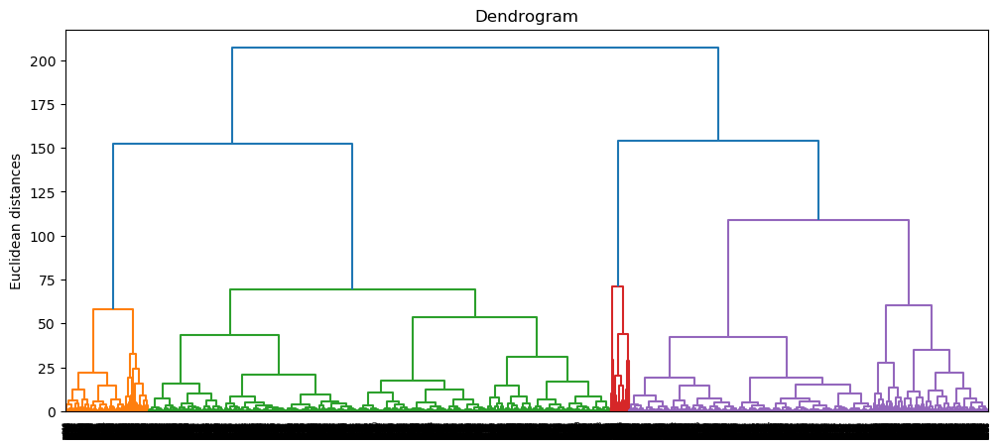

In [71]:
plt.figure(figsize=(12, 5))
dendrogram = sch.dendrogram(sch.linkage(data_pca2, method = 'ward'))
plt.title('Dendrogram')
plt.ylabel('Euclidean distances')
plt.show()

We can see that the Dendrogram of ward method from PCA generated a much clear relationship. 

#### PCA DBSCAN

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

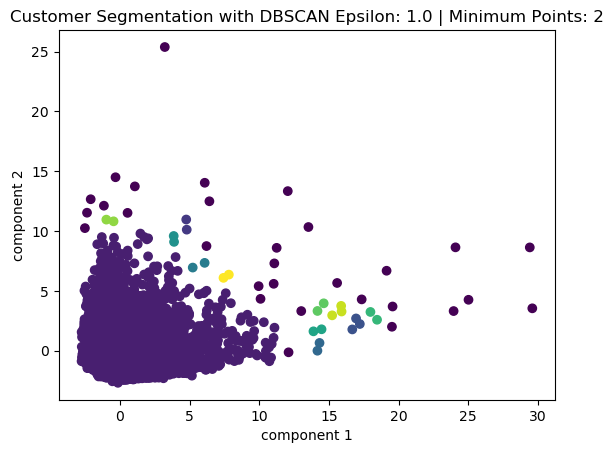

Silhouette Score:  0.642499625696301


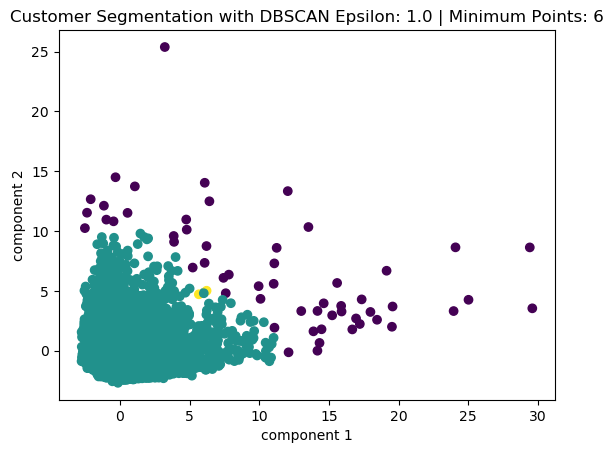

Silhouette Score:  0.5925208754872522


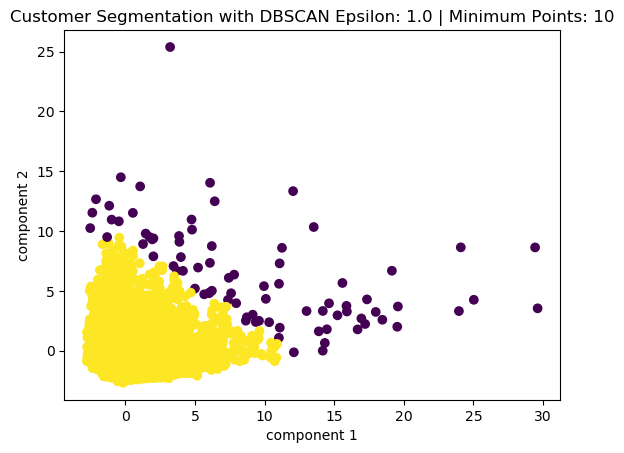

Silhouette Score:  0.765579627806045


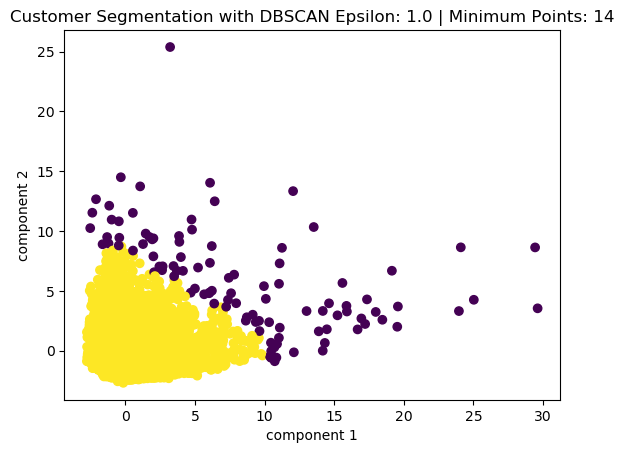

Silhouette Score:  0.750275015456107


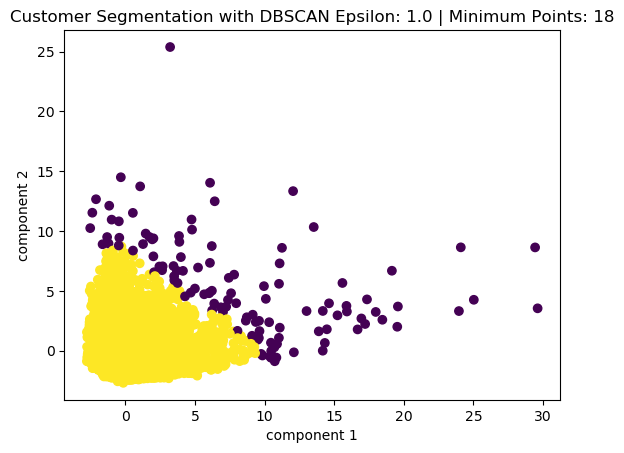

Silhouette Score:  0.7426116301831411


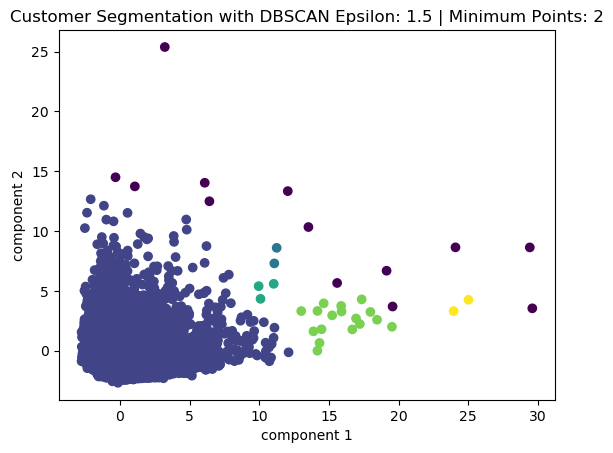

Silhouette Score:  0.7206871883099984


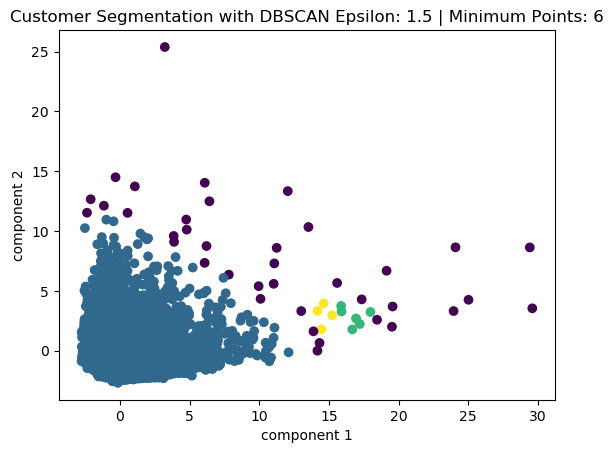

Silhouette Score:  0.781142604248167


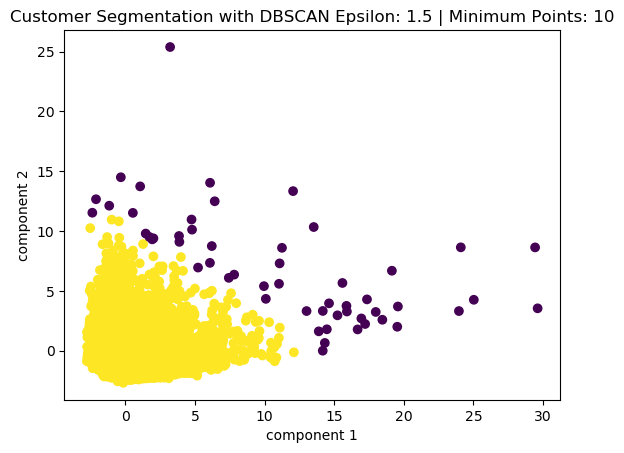

Silhouette Score:  0.7945355883556591


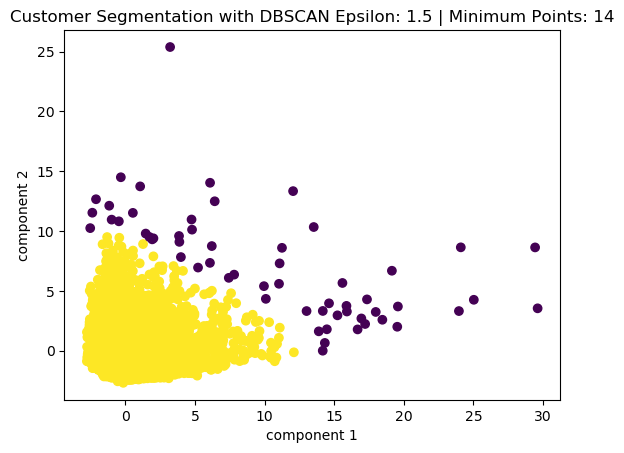

Silhouette Score:  0.7902202747746846


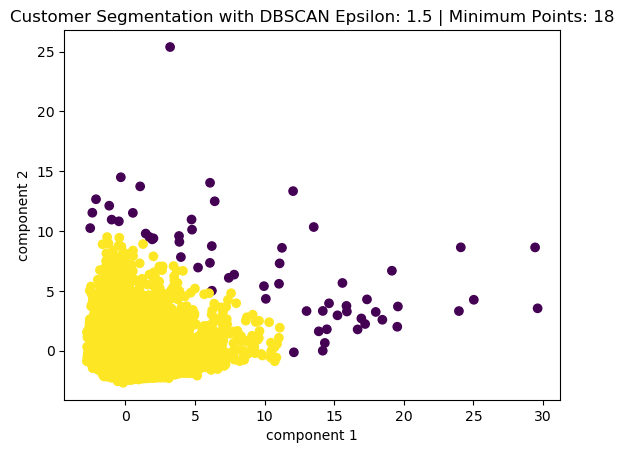

Silhouette Score:  0.788046736289255


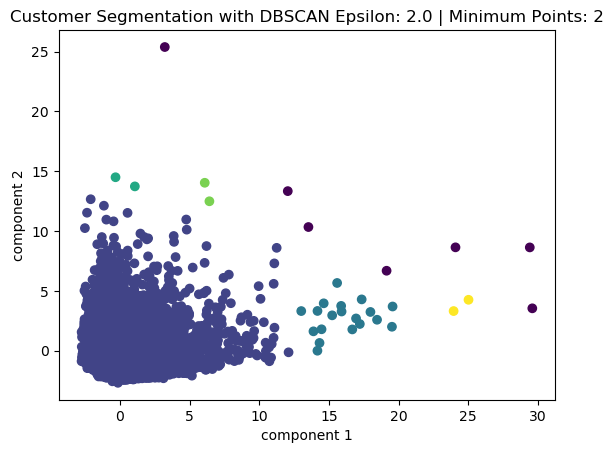

Silhouette Score:  0.7622827920138017


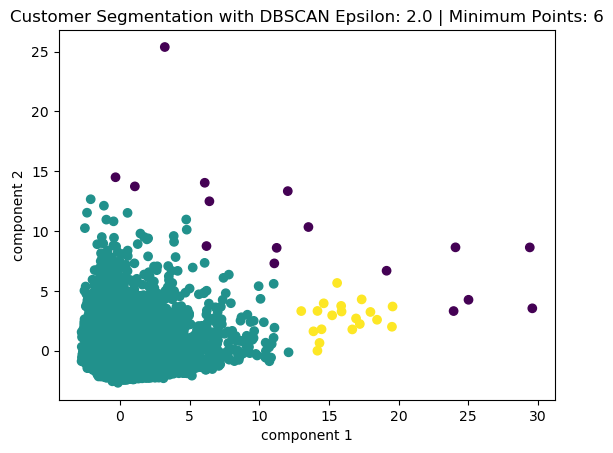

Silhouette Score:  0.8032524907791072


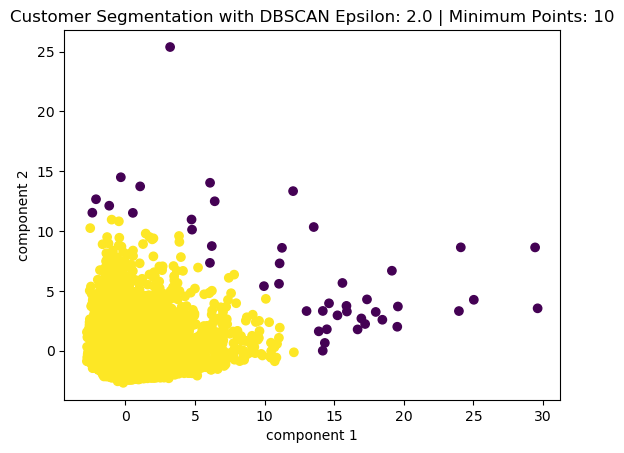

Silhouette Score:  0.809185587854294


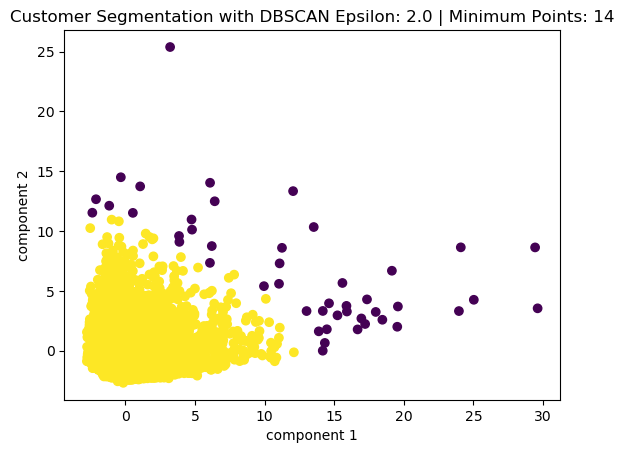

Silhouette Score:  0.8060666941194006


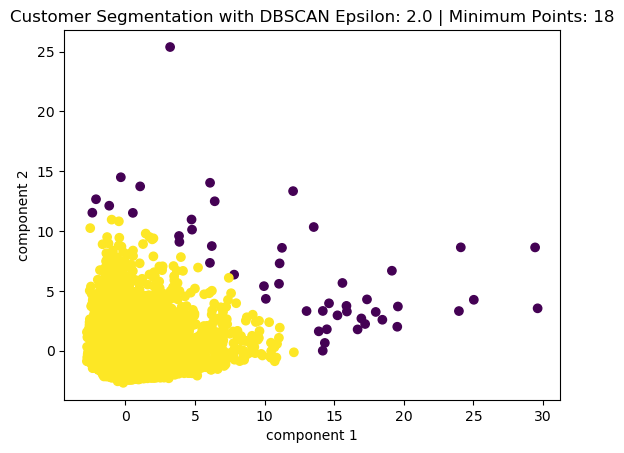

Silhouette Score:  0.803340681555949


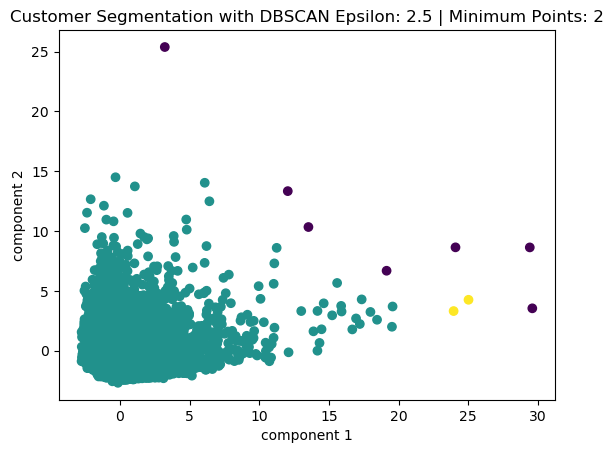

Silhouette Score:  0.8628676027107722


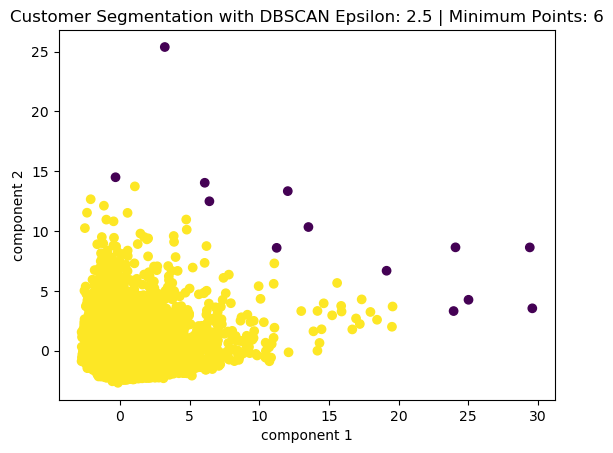

Silhouette Score:  0.8474518419210371


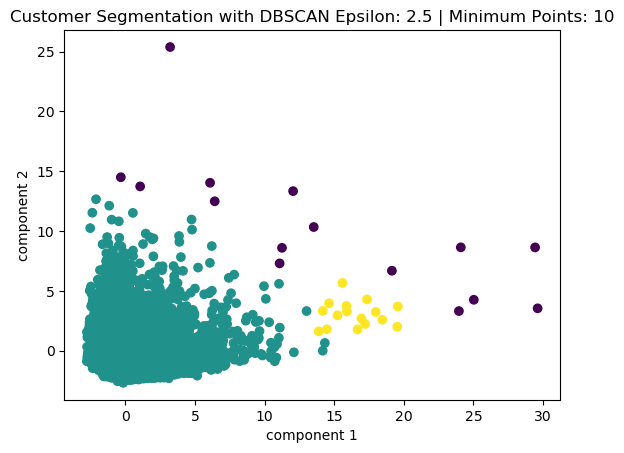

Silhouette Score:  0.8079078681176542


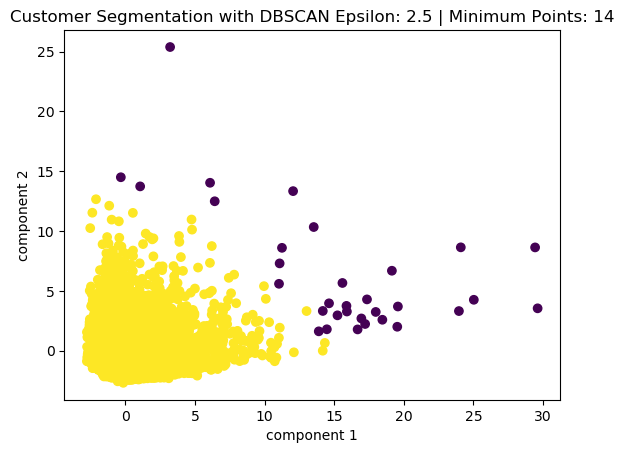

Silhouette Score:  0.8254894849343388


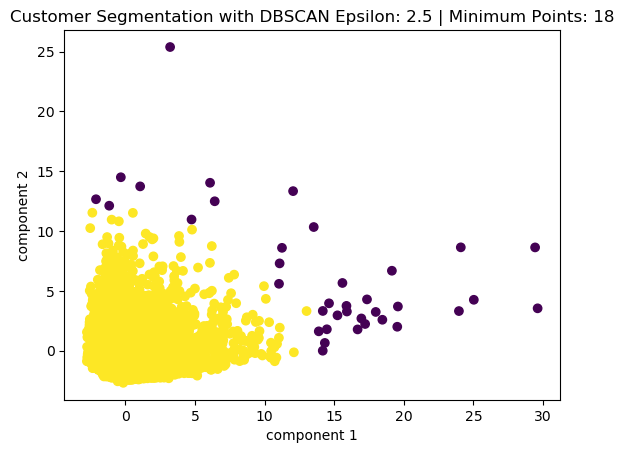

Silhouette Score:  0.8192426451642665


In [72]:
db_list_pca = []

#Evaluate DBSCAN hyperparameters and their effect on the silhouette score
for ep in np.arange(1, 3, 0.5):
    for min_sample in range(2, 20, 4):
        db = DBSCAN(eps=ep, min_samples = min_sample)
        db_clusters = db.fit_predict(data_pca2)
        sil_score = silhouette_score(data_pca2, db_clusters)
        db_list_pca.append((ep, min_sample, sil_score, len(set(db.labels_))))

        plt.scatter(data_pca2.iloc[:,0],data_pca2.iloc[:,1], c = db_clusters, cmap =None)
        plt.title('Customer Segmentation with DBSCAN Epsilon: ' + str(ep) + ' | Minimum Points: ' + str(min_sample))
        plt.xlabel('component 1')
        plt.ylabel('component 2')
        plt.show()

        print("Silhouette Score: ", sil_score)

In [73]:
df_db_pca = pd.DataFrame(db_list_pca, columns=['Epsilon', 'Minimum Sample', 'Silhouette Score', 'Number of clusters'])
df_db_pca

,Epsilon,Minimum Sample,Silhouette Score,Number of clusters
0,1.0,2,0.642500,13
1,1.0,6,0.592521,3
2,1.0,10,0.765580,2
3,1.0,14,0.750275,2
4,1.0,18,0.742612,2
5,1.5,2,0.720687,6
6,1.5,6,0.781143,4
7,1.5,10,0.794536,2
8,1.5,14,0.790220,2
9,1.5,18,0.788047,2


In [74]:
df_db_pca.sort_values(by=['Silhouette Score'], ascending=False).head()

,Epsilon,Minimum Sample,Silhouette Score,Number of clusters
15,2.5,2,0.862868,3
16,2.5,6,0.847452,2
18,2.5,14,0.825489,2
19,2.5,18,0.819243,2
12,2.0,10,0.809186,2


After comparing with the plots and the table above, the **eps = 2.5 and min_samples = 18** seem to generate a better performance with two clusters.

#### T-Distributed Stochastic Neighbor Embedding (TSNE)

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

**TSNE** is also an unsupervised non-linear dimensionality reduction technique. The **t-distribution** is used when dealing with a small sample size with an unknown population standard deviation. 

In [75]:
model_tsne = TSNE(n_components=2, verbose=1)

In [76]:
data_tsne = model_tsne.fit_transform(data)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 8949 samples in 0.042s...
[t-SNE] Computed neighbors for 8949 samples in 1.916s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8949
[t-SNE] Computed conditional probabilities for sample 2000 / 8949
[t-SNE] Computed conditional probabilities for sample 3000 / 8949
[t-SNE] Computed conditional probabilities for sample 4000 / 8949
[t-SNE] Computed conditional probabilities for sample 5000 / 8949
[t-SNE] Computed conditional probabilities for sample 6000 / 8949
[t-SNE] Computed conditional probabilities for sample 7000 / 8949
[t-SNE] Computed conditional probabilities for sample 8000 / 8949
[t-SNE] Computed conditional probabilities for sample 8949 / 8949
[t-SNE] Mean sigma: 0.427252
[t-SNE] KL divergence after 250 iterations with early exaggeration: 83.966179
[t-SNE] KL divergence after 1000 iterations: 1.505604


Let's check what it looks like with a k-means clustering of n_clusters =8.

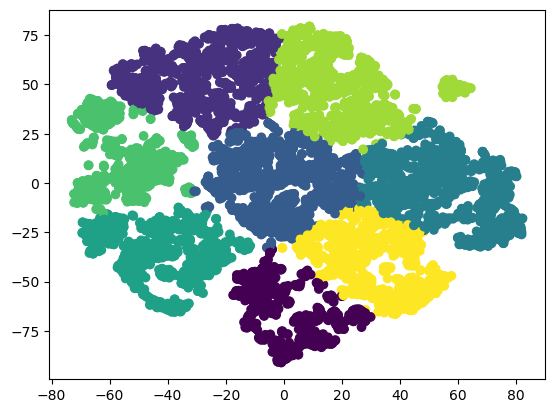

In [77]:
data_tsne = pd.DataFrame(data_tsne)

plt.scatter(data_tsne.iloc[:,0],data_tsne.iloc[:,1],
            c = KMeans(n_clusters=8).fit_predict(data_tsne), cmap =None) 
plt.show()

Looks like TSNE has a better performance on scaling the data into two dimensions. 

[t-SNE] Computing 4 nearest neighbors...
[t-SNE] Indexed 8949 samples in 0.040s...
[t-SNE] Computed neighbors for 8949 samples in 0.841s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8949
[t-SNE] Computed conditional probabilities for sample 2000 / 8949
[t-SNE] Computed conditional probabilities for sample 3000 / 8949
[t-SNE] Computed conditional probabilities for sample 4000 / 8949
[t-SNE] Computed conditional probabilities for sample 5000 / 8949
[t-SNE] Computed conditional probabilities for sample 6000 / 8949
[t-SNE] Computed conditional probabilities for sample 7000 / 8949
[t-SNE] Computed conditional probabilities for sample 8000 / 8949
[t-SNE] Computed conditional probabilities for sample 8949 / 8949
[t-SNE] Mean sigma: 0.031649
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.881966
[t-SNE] KL divergence after 1000 iterations: 1.832245
[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 8949 samples in 0.037s...
[t-SNE] Computed neig

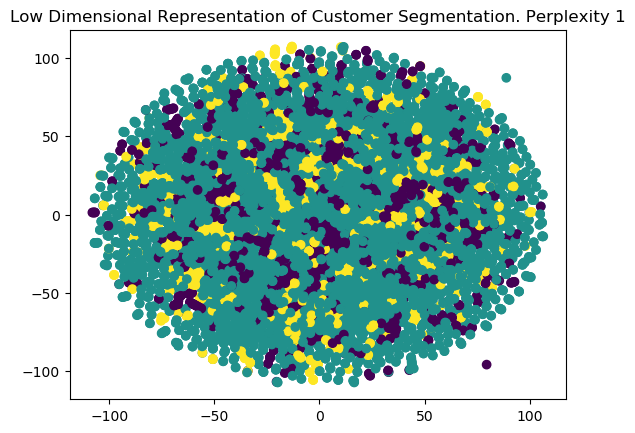

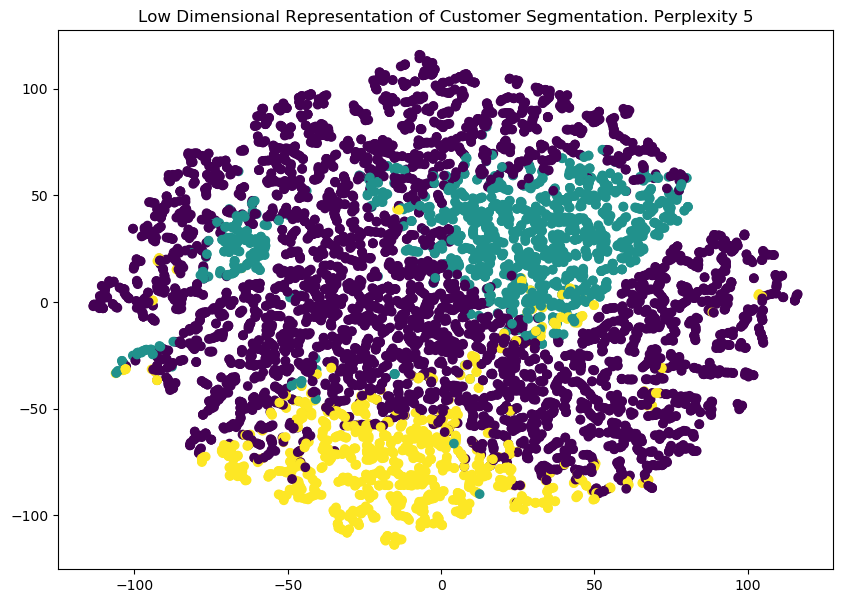

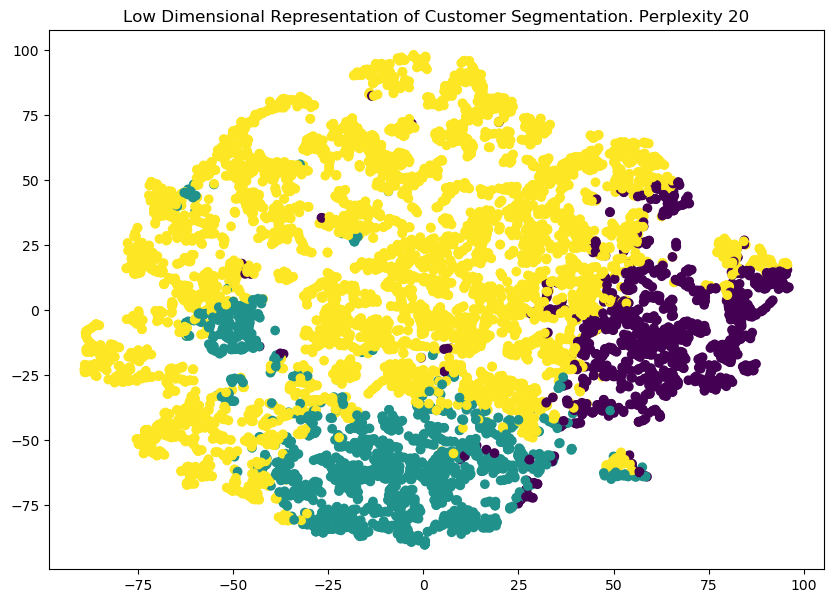

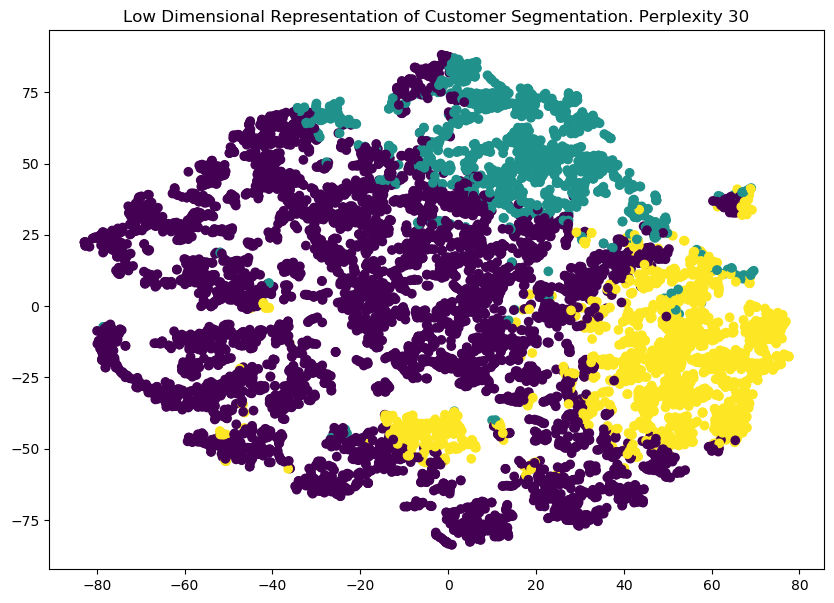

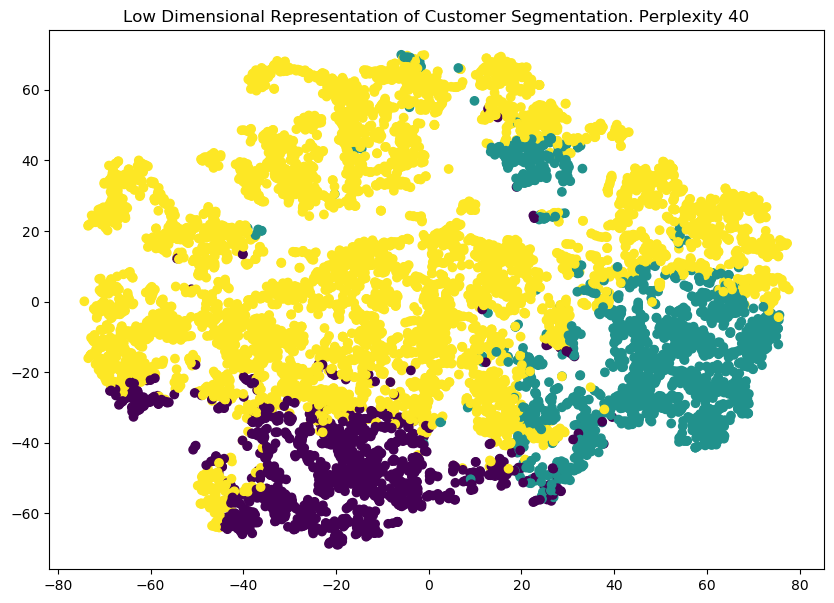

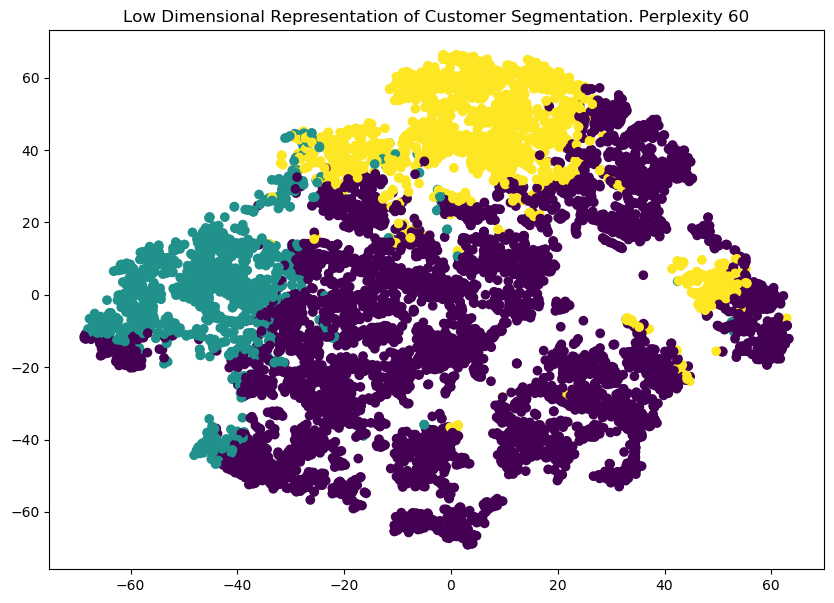

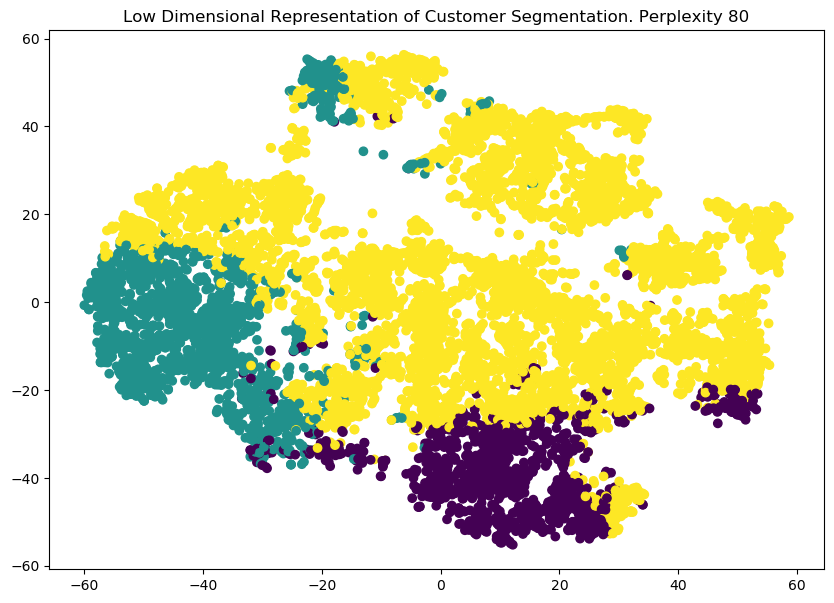

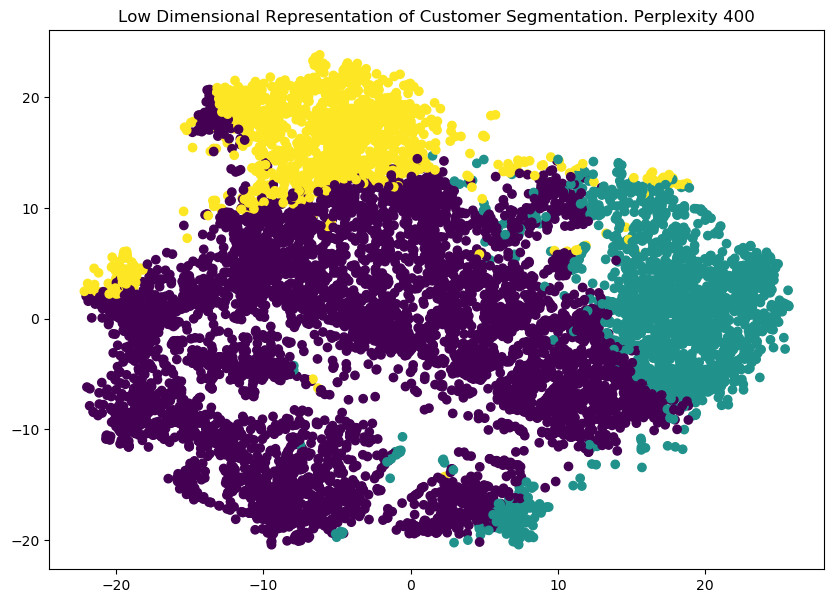

<Figure size 1000x700 with 0 Axes>

In [79]:
perplexity_values = [1, 5, 20, 30, 40, 60, 80, 400]
for perp in perplexity_values:
    model_tsne = TSNE(verbose=1, perplexity=perp)
    data_tsne = model_tsne.fit_transform(data)
    
    data_tsne = pd.DataFrame(data_tsne)
    
    plt.title(f'Low Dimensional Representation of Customer Segmentation. Perplexity {perp}');
    plt.scatter(data_tsne.iloc[:,0],data_tsne.iloc[:,1], c = KMeans(3).fit_predict(data_pca2), cmap =None) 
    plt.figure(figsize=(10, 7))
    
    
plt.show()

From the above plots, most of the data points are at the center of the plot when the perplexity value is equal to 1. The plot is hard to identify any patterns and clusters when the perplexity is equal to 1. When the perplexity value increase, the relationship of clusters is getting clear. However, the perplexity value of 400 is seems to be too high. 

Let's check how it perform with a k-means clustering of n_clusters =8:

[t-SNE] Computing 4 nearest neighbors...
[t-SNE] Indexed 8949 samples in 0.031s...
[t-SNE] Computed neighbors for 8949 samples in 0.771s...
[t-SNE] Computed conditional probabilities for sample 1000 / 8949
[t-SNE] Computed conditional probabilities for sample 2000 / 8949
[t-SNE] Computed conditional probabilities for sample 3000 / 8949
[t-SNE] Computed conditional probabilities for sample 4000 / 8949
[t-SNE] Computed conditional probabilities for sample 5000 / 8949
[t-SNE] Computed conditional probabilities for sample 6000 / 8949
[t-SNE] Computed conditional probabilities for sample 7000 / 8949
[t-SNE] Computed conditional probabilities for sample 8000 / 8949
[t-SNE] Computed conditional probabilities for sample 8949 / 8949
[t-SNE] Mean sigma: 0.031649
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.866287
[t-SNE] KL divergence after 1000 iterations: 1.833596
[t-SNE] Computing 16 nearest neighbors...
[t-SNE] Indexed 8949 samples in 0.029s...
[t-SNE] Computed neig

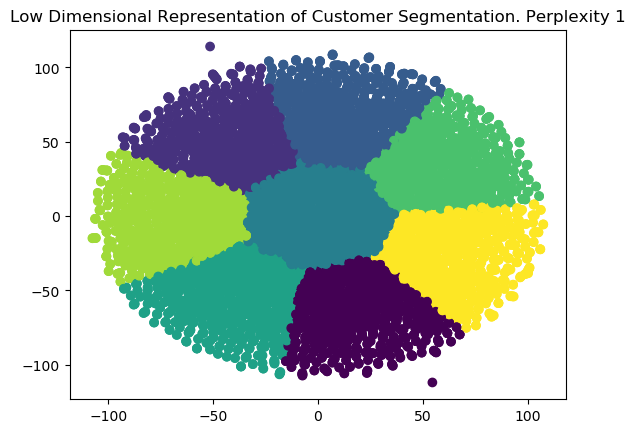

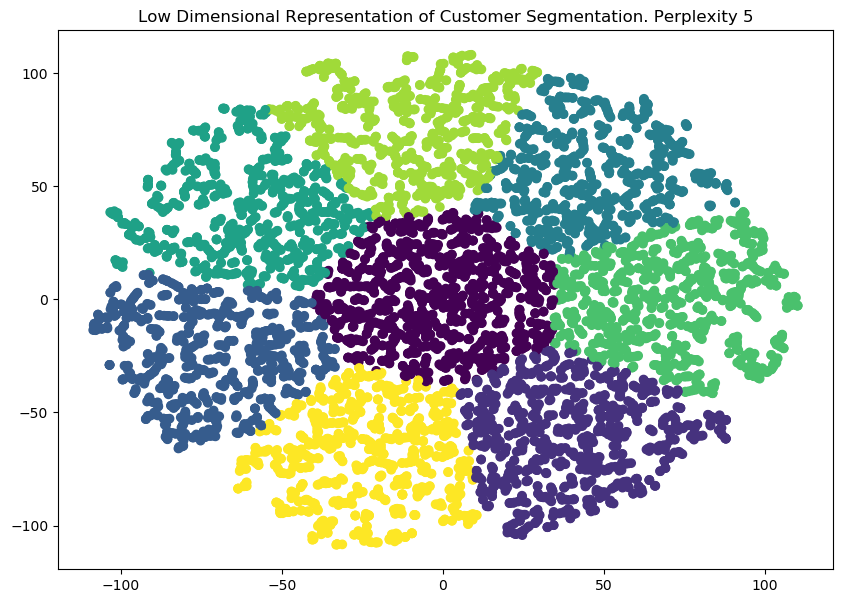

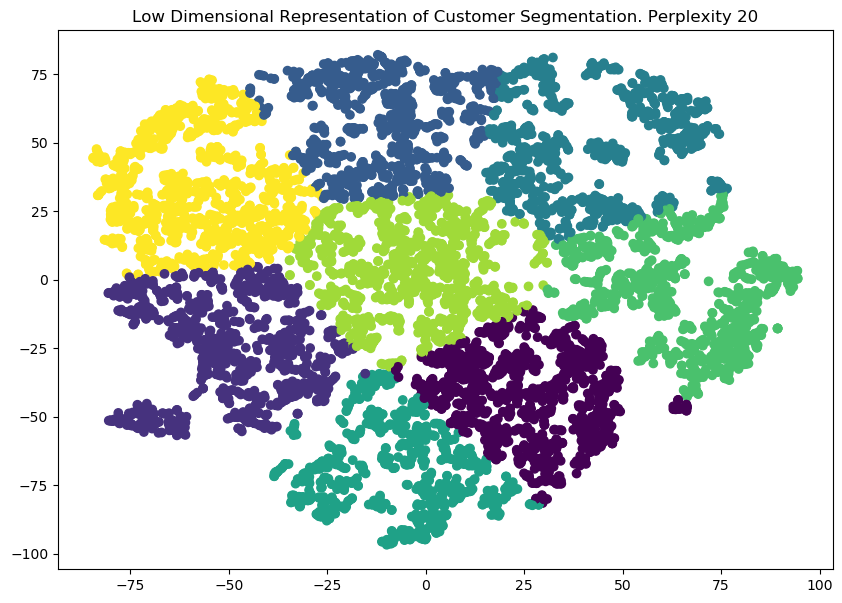

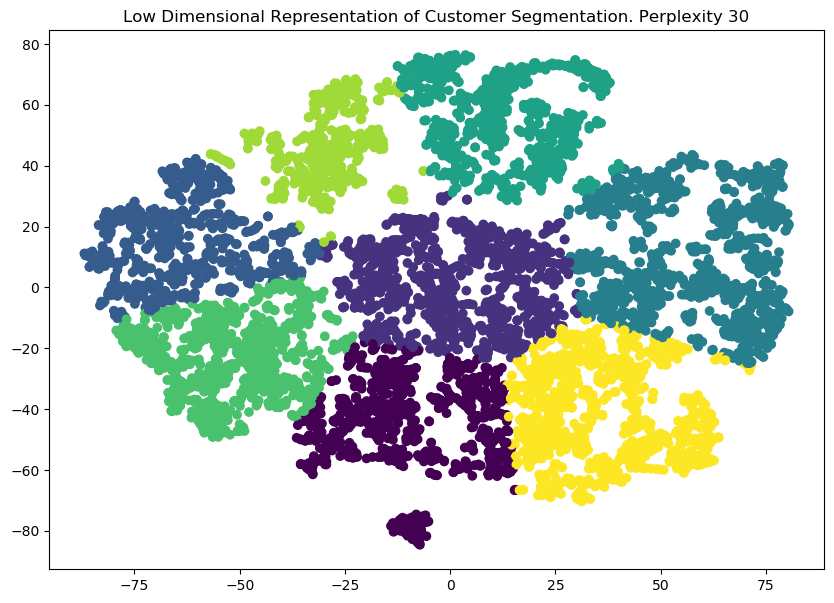

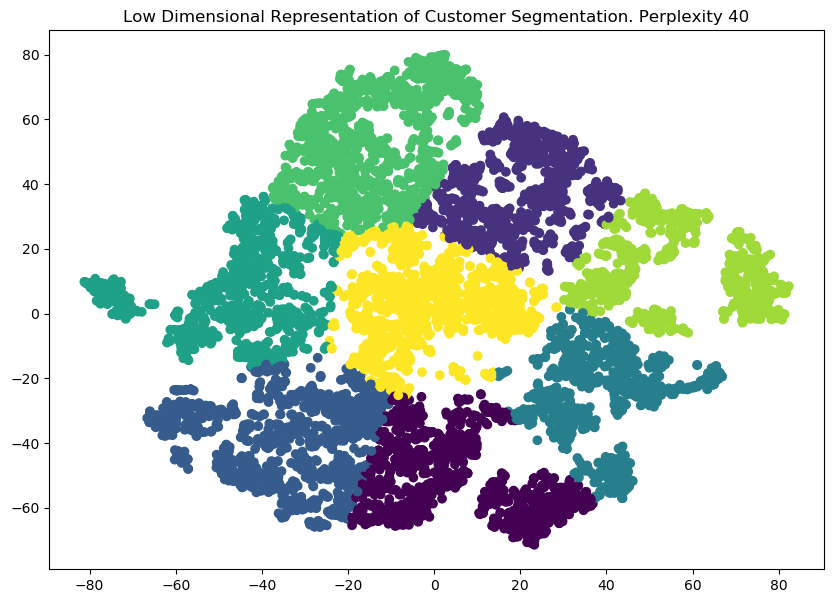

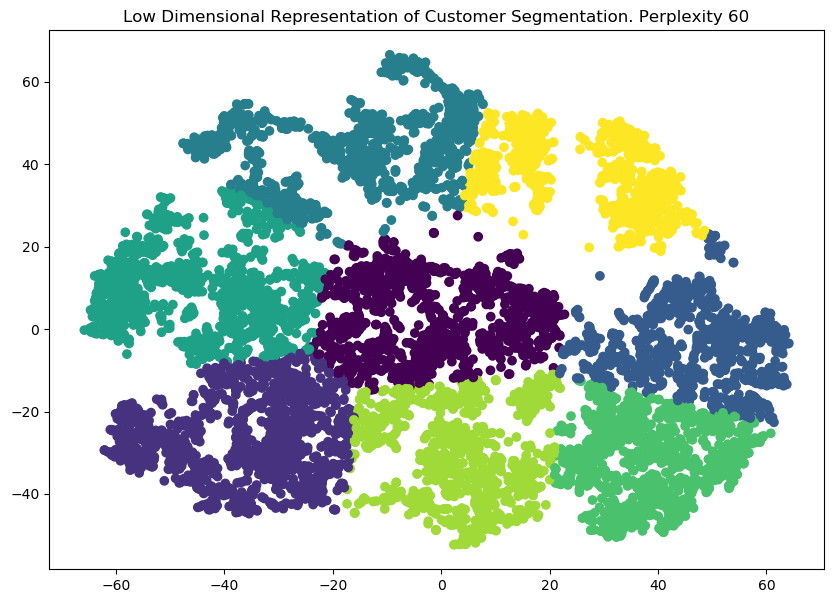

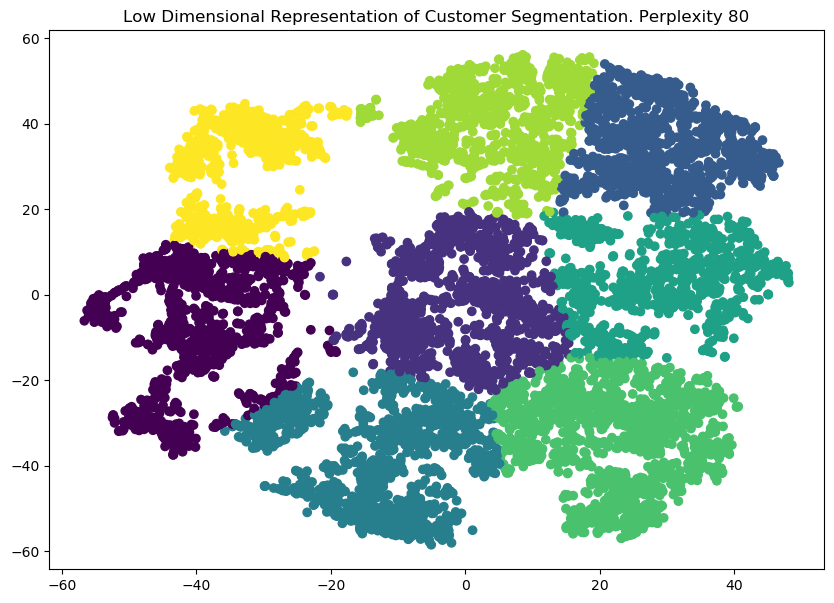

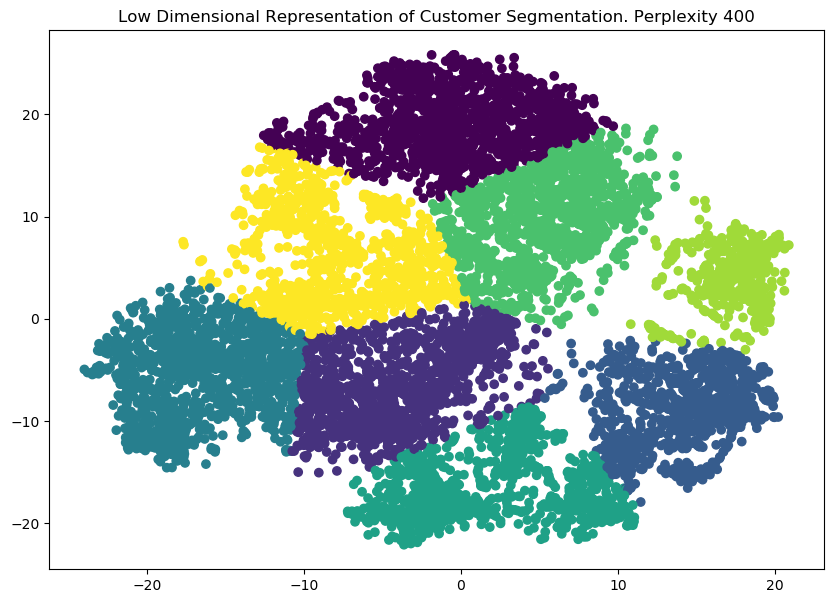

<Figure size 1000x700 with 0 Axes>

In [80]:
perplexity_values = [1, 5, 20, 30, 40, 60, 80, 400]
for perp in perplexity_values:
    model_tsne = TSNE(verbose=1, perplexity=perp)
    data_tsne = model_tsne.fit_transform(data)
    
    data_tsne = pd.DataFrame(data_tsne)
    
    plt.title(f'Low Dimensional Representation of Customer Segmentation. Perplexity {perp}');
    plt.scatter(data_tsne.iloc[:,0],data_tsne.iloc[:,1], c = KMeans(n_clusters=8).fit_predict(data_tsne), cmap =None) 
    plt.figure(figsize=(10, 7))
    
    
plt.show()

From the above plots, most of the data points are at the center of the plot when the perplexity value is equal to 1. The data points are still too close to the middle of the plot when the perplexity value is equal to 5. The plots of 20 to 60 seem to generate a clear relationship. Therefore, we choose the default perplexity value of 30 for the TSNE model. 

#### TSNE K-means

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

k=2 K-Means Clustering: 0.4067707061767578


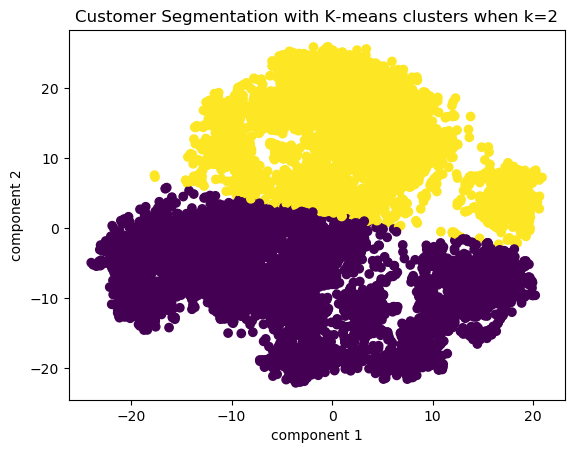

k=3 K-Means Clustering: 0.4468262791633606


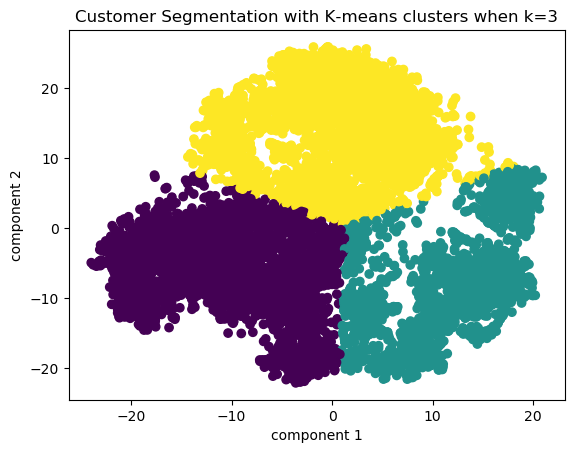

k=4 K-Means Clustering: 0.43460649251937866


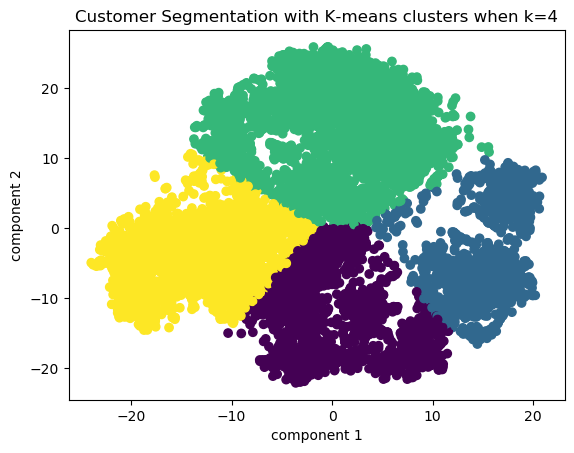

k=5 K-Means Clustering: 0.4032849967479706


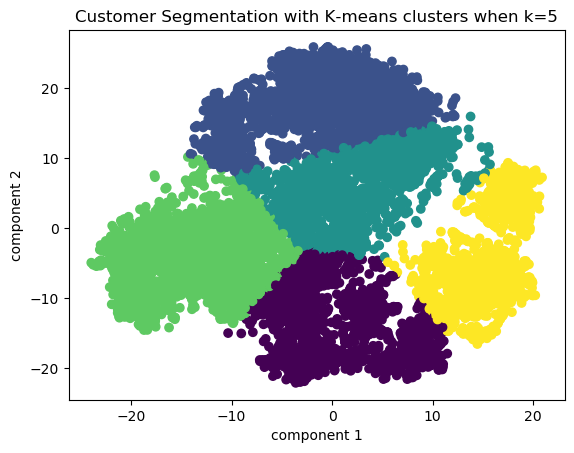

k=6 K-Means Clustering: 0.4076898694038391


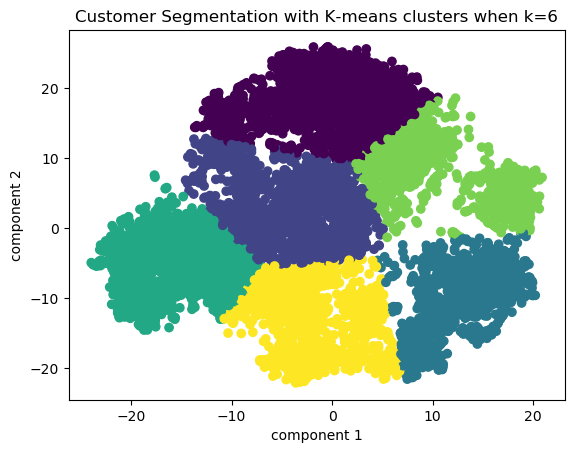

k=7 K-Means Clustering: 0.41257354617118835


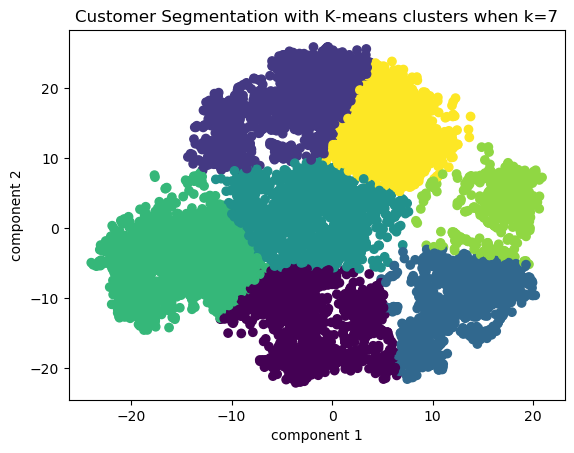

k=8 K-Means Clustering: 0.4125075042247772


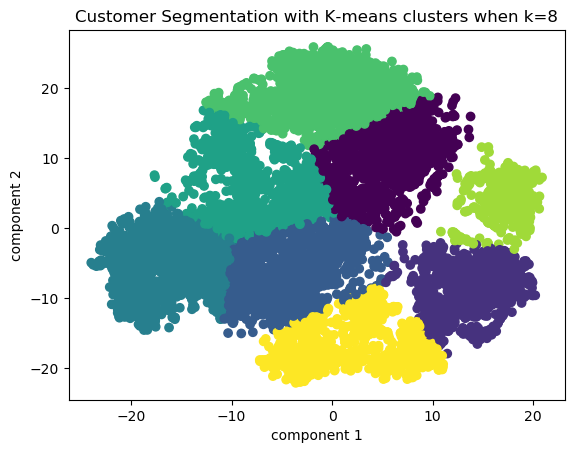

k=9 K-Means Clustering: 0.41203945875167847


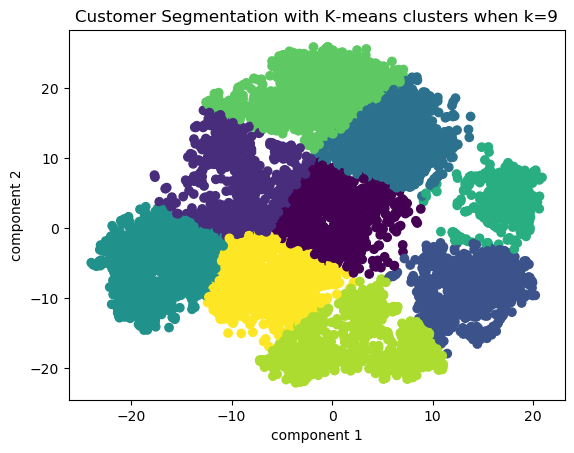

k=10 K-Means Clustering: 0.4134407043457031


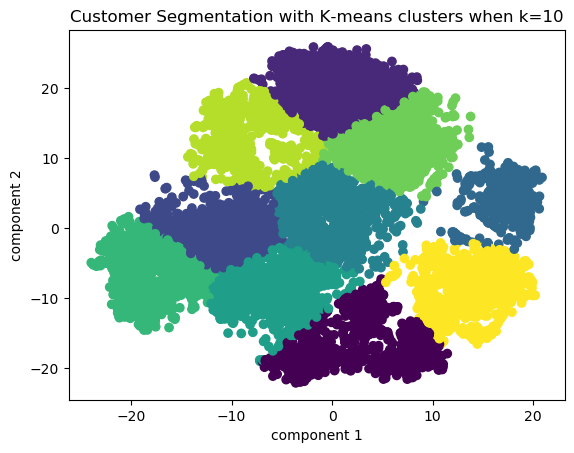

In [81]:
km_list_tsne = []
for i in range (2,11):
    km = KMeans(i)
    km_clusters = km.fit_predict(data_tsne)
    sil_score = silhouette_score(data_tsne, km_clusters)
    print(f"k={i} K-Means Clustering: {sil_score}")
    
    km_list_tsne.append((i, sil_score))
    
    plt.scatter(data_tsne.iloc[:,0],data_tsne.iloc[:,1], c = km_clusters, cmap =None)
    plt.title(f"Customer Segmentation with K-means clusters when k={i}")
    plt.xlabel('component 1')
    plt.ylabel('component 2')
    plt.show()

df_km_tsne = pd.DataFrame(km_list_tsne, columns=['k', 'silhouette_score'])

In [82]:
df_km_tsne.sort_values('silhouette_score', ascending=False)

,k,silhouette_score
1,3,0.446826
2,4,0.434606
8,10,0.413441
5,7,0.412574
6,8,0.412508
7,9,0.412039
4,6,0.407690
0,2,0.406771
3,5,0.403285


The k-means clustering with tsne scaled data seems to have the best performance when **k is equal to 3**. However, compared with pca scaled data with k-means, the silhouette_score is a little bit lower. 

#### TSNE Hierarchical Clustering

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

n_clusters=2, linkage=single   Agglomerative Clustering: 0.06704951077699661


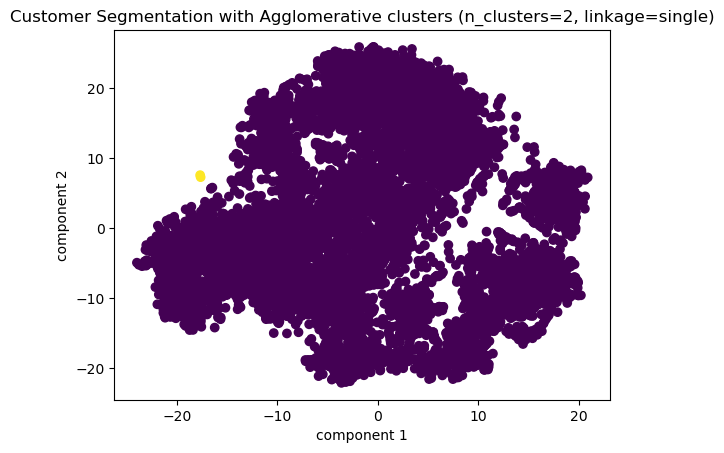

n_clusters=2, linkage=ward   Agglomerative Clustering: 0.3696958124637604


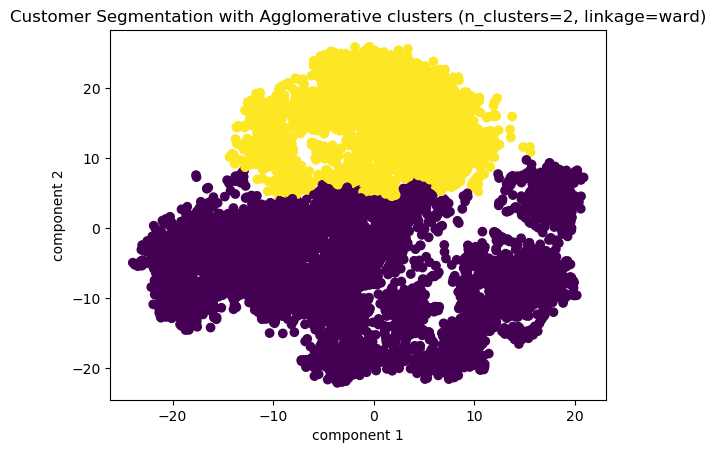

n_clusters=2, linkage=average   Agglomerative Clustering: 0.3784180283546448


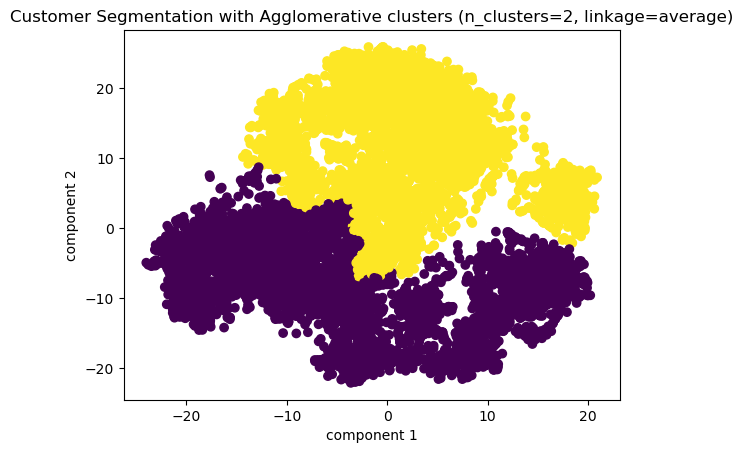

n_clusters=2, linkage=complete   Agglomerative Clustering: 0.40311089158058167


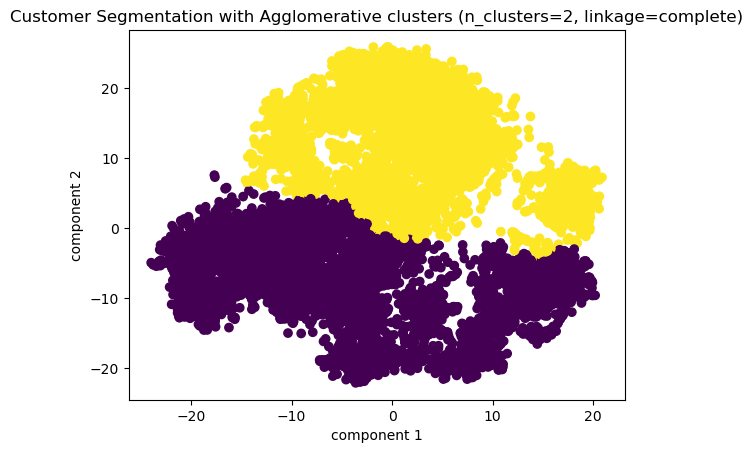

n_clusters=3, linkage=single   Agglomerative Clustering: -0.1539221554994583


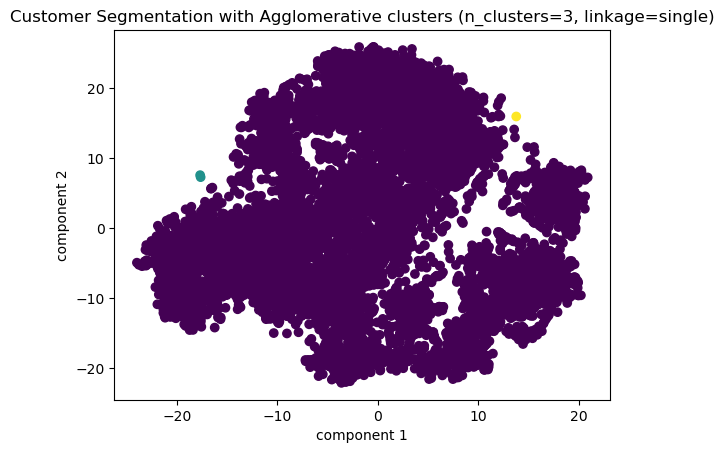

n_clusters=3, linkage=ward   Agglomerative Clustering: 0.42572563886642456


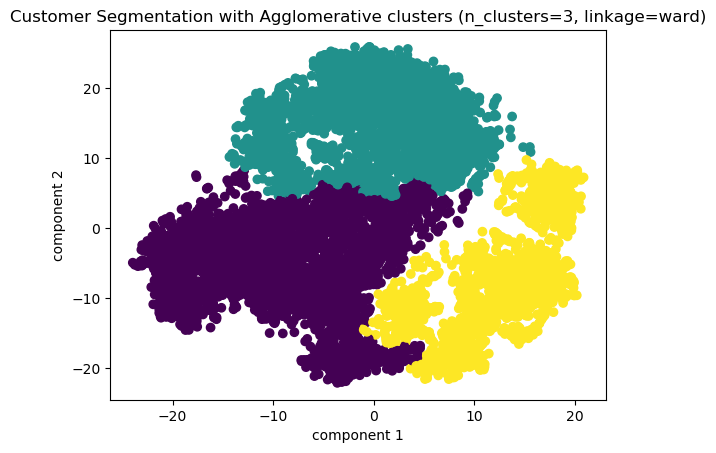

n_clusters=3, linkage=average   Agglomerative Clustering: 0.42108476161956787


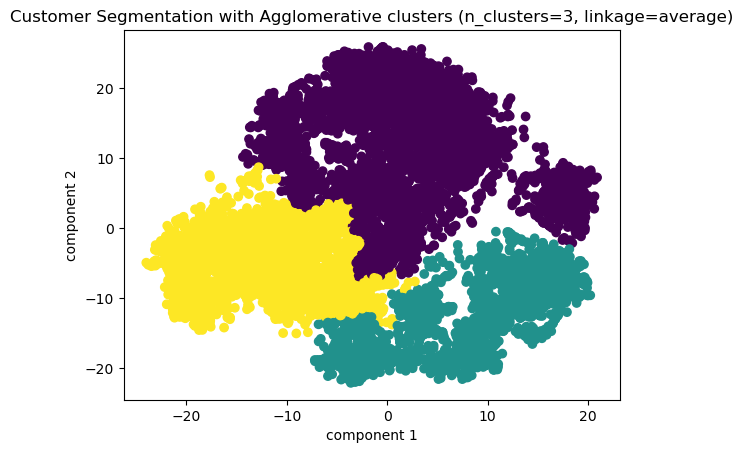

n_clusters=3, linkage=complete   Agglomerative Clustering: 0.4141015410423279


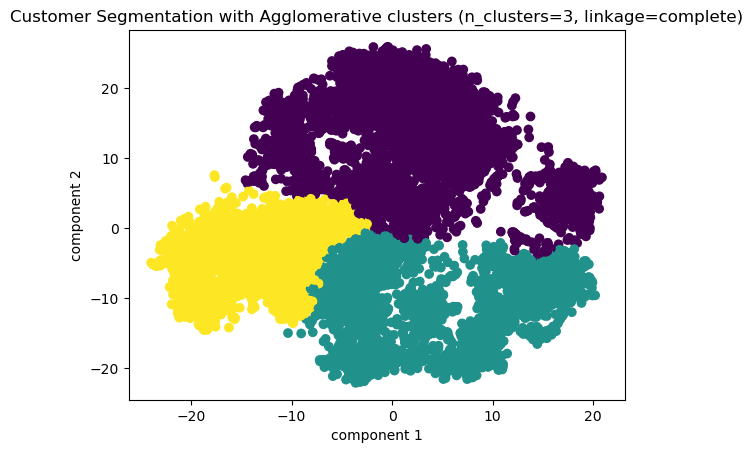

n_clusters=4, linkage=single   Agglomerative Clustering: -0.3698209524154663


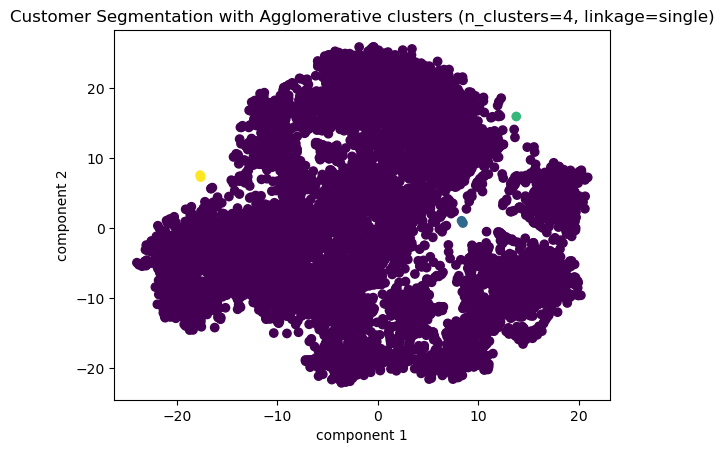

n_clusters=4, linkage=ward   Agglomerative Clustering: 0.38199636340141296


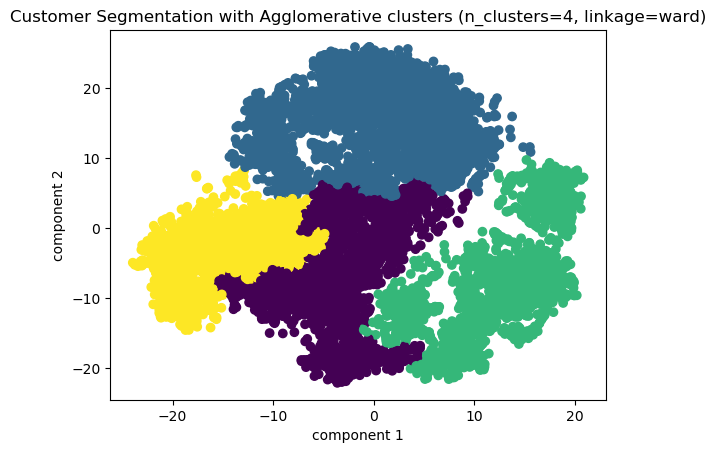

n_clusters=4, linkage=average   Agglomerative Clustering: 0.3599488139152527


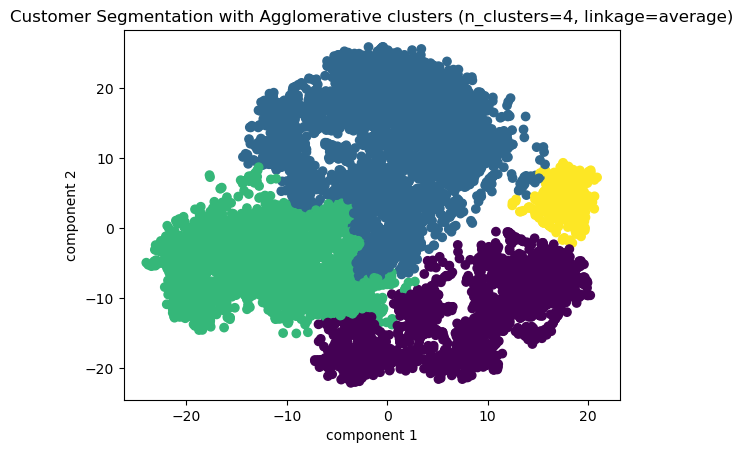

n_clusters=4, linkage=complete   Agglomerative Clustering: 0.37650686502456665


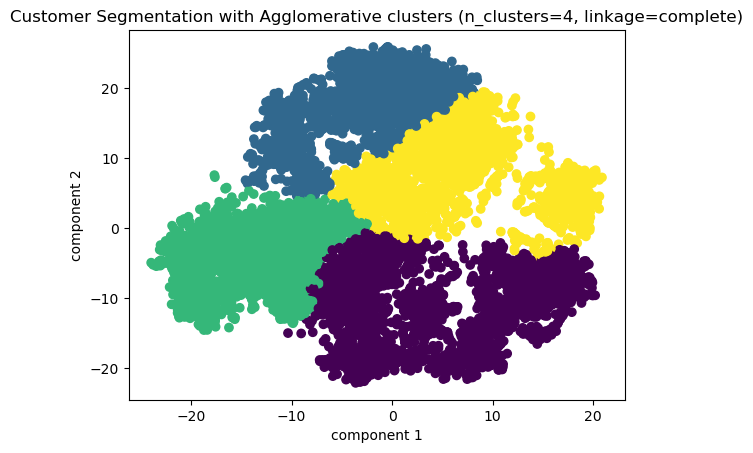

n_clusters=5, linkage=single   Agglomerative Clustering: -0.3893791139125824


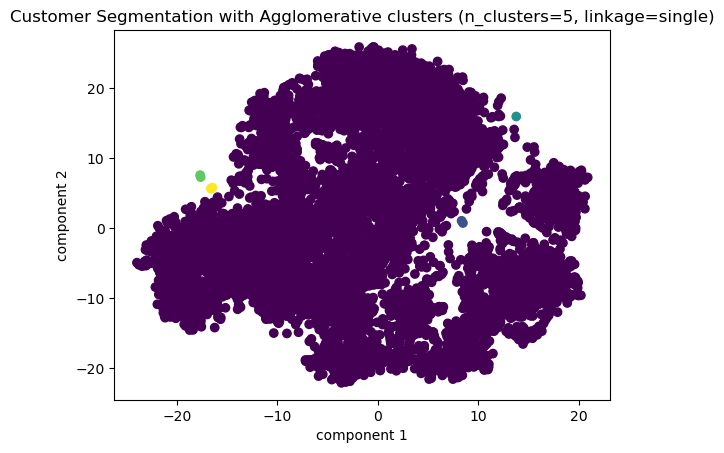

n_clusters=5, linkage=ward   Agglomerative Clustering: 0.3474059998989105


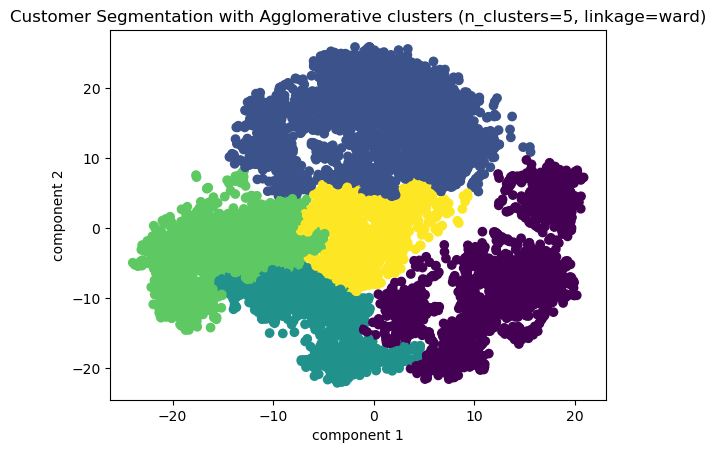

n_clusters=5, linkage=average   Agglomerative Clustering: 0.3440847098827362


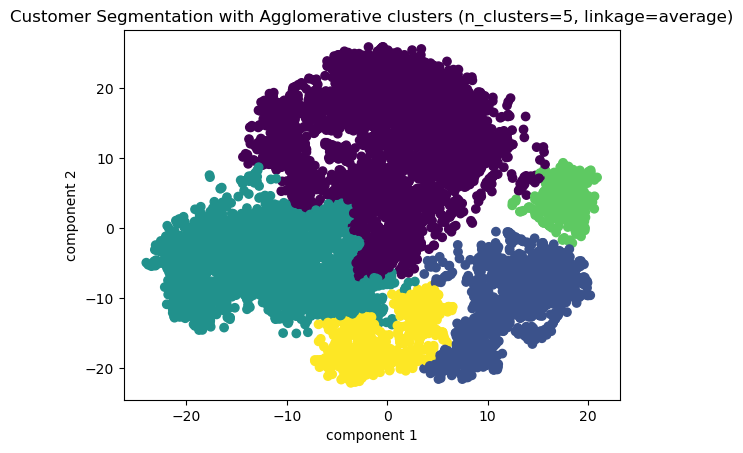

n_clusters=5, linkage=complete   Agglomerative Clustering: 0.37016379833221436


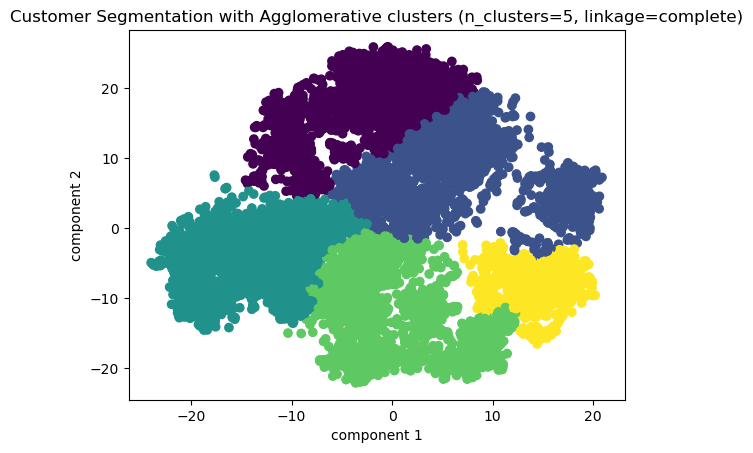

n_clusters=6, linkage=single   Agglomerative Clustering: -0.45555752515792847


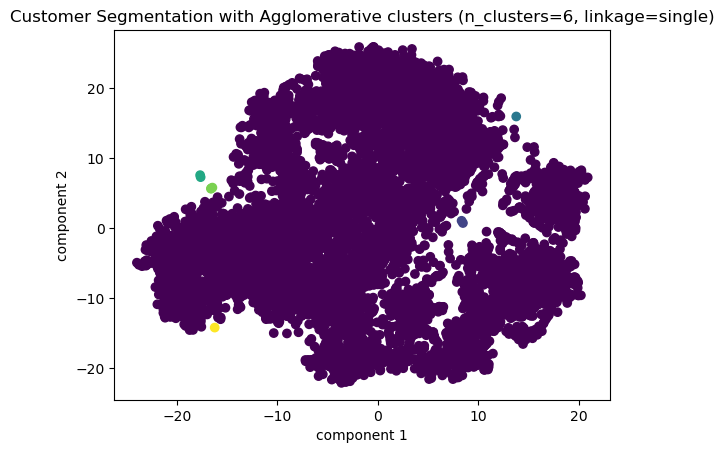

n_clusters=6, linkage=ward   Agglomerative Clustering: 0.362177312374115


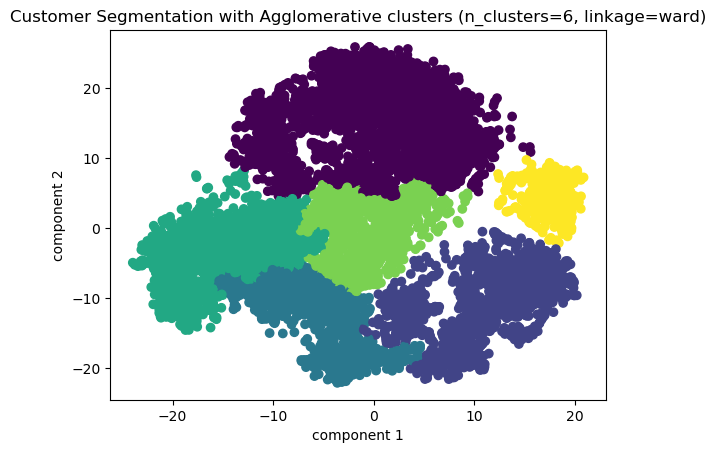

n_clusters=6, linkage=average   Agglomerative Clustering: 0.35542333126068115


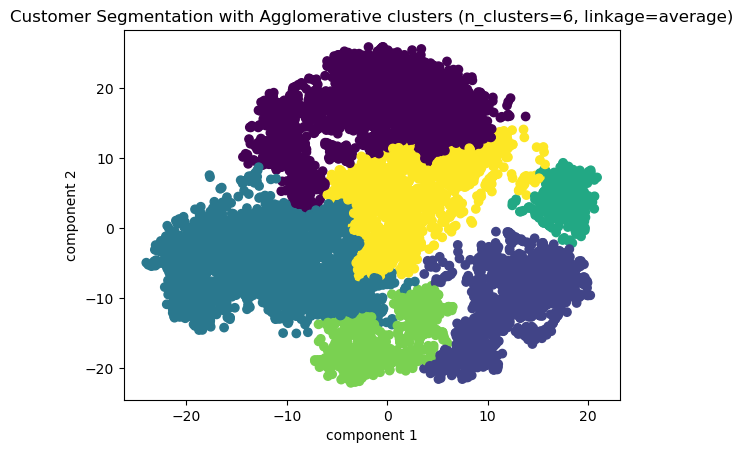

n_clusters=6, linkage=complete   Agglomerative Clustering: 0.34130820631980896


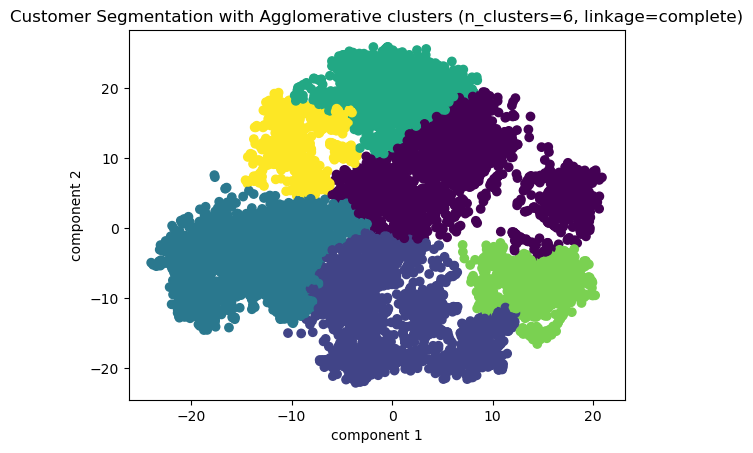

n_clusters=7, linkage=single   Agglomerative Clustering: -0.4936814308166504


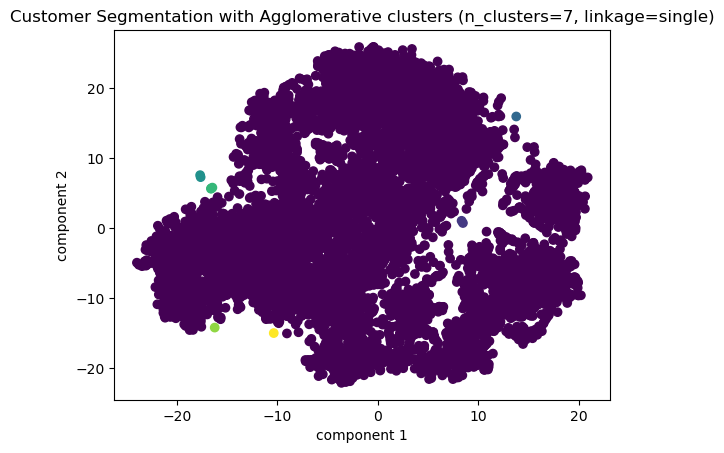

n_clusters=7, linkage=ward   Agglomerative Clustering: 0.3497436046600342


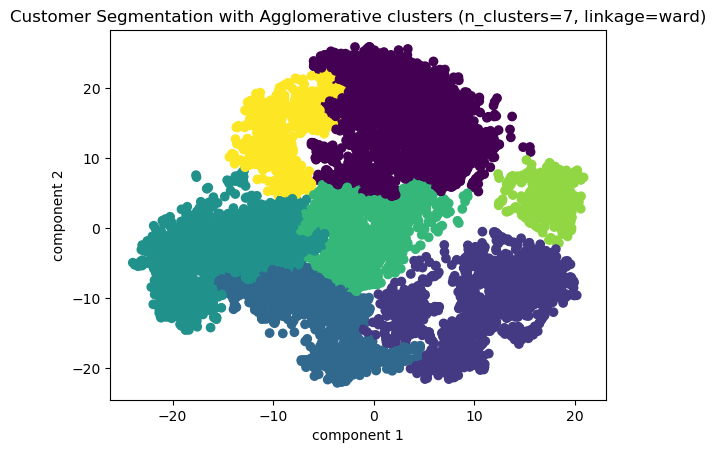

n_clusters=7, linkage=average   Agglomerative Clustering: 0.3562188744544983


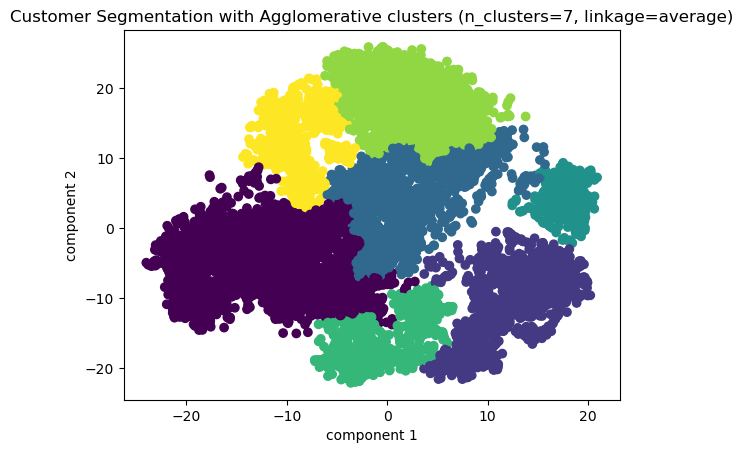

n_clusters=7, linkage=complete   Agglomerative Clustering: 0.3771764934062958


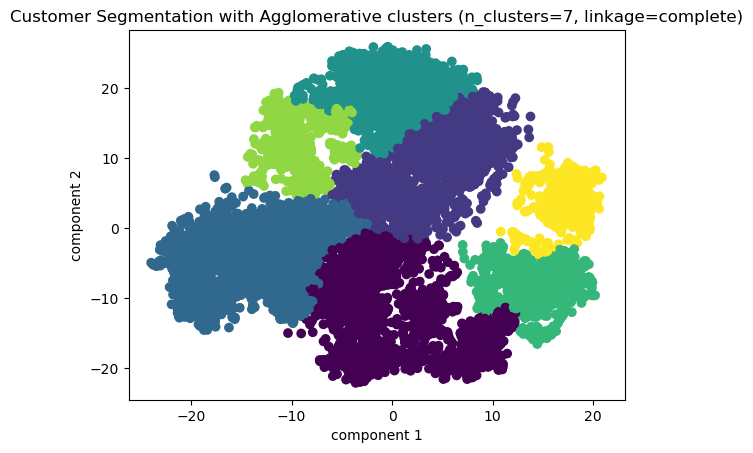

n_clusters=8, linkage=single   Agglomerative Clustering: -0.5054686069488525


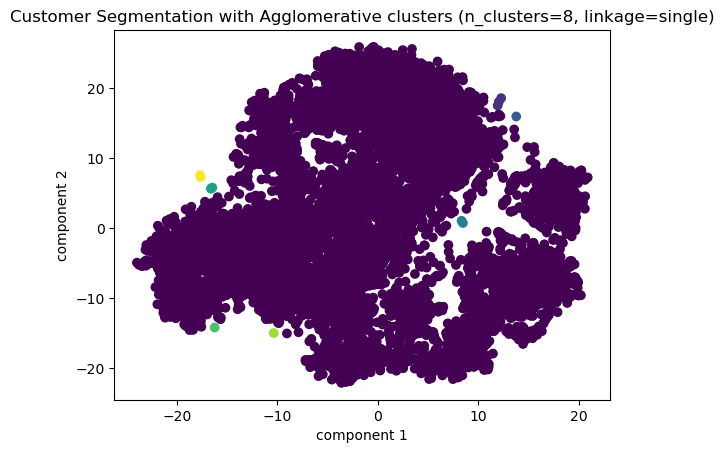

n_clusters=8, linkage=ward   Agglomerative Clustering: 0.35989323258399963


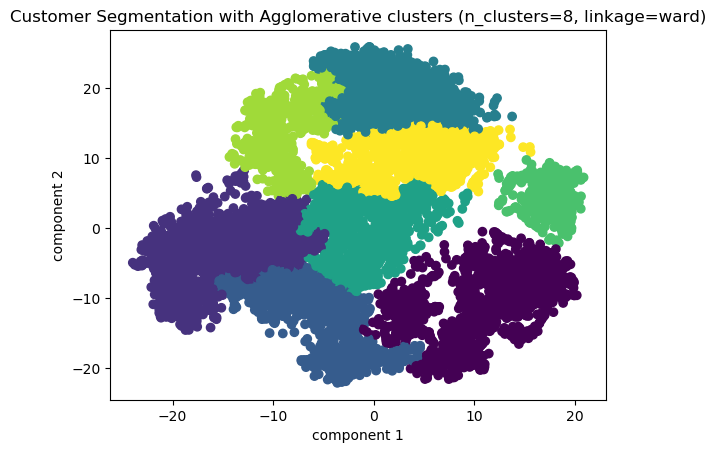

n_clusters=8, linkage=average   Agglomerative Clustering: 0.34580090641975403


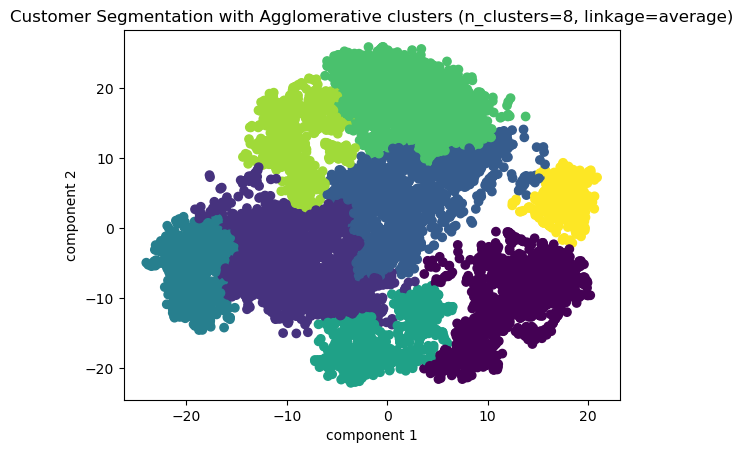

n_clusters=8, linkage=complete   Agglomerative Clustering: 0.36205610632896423


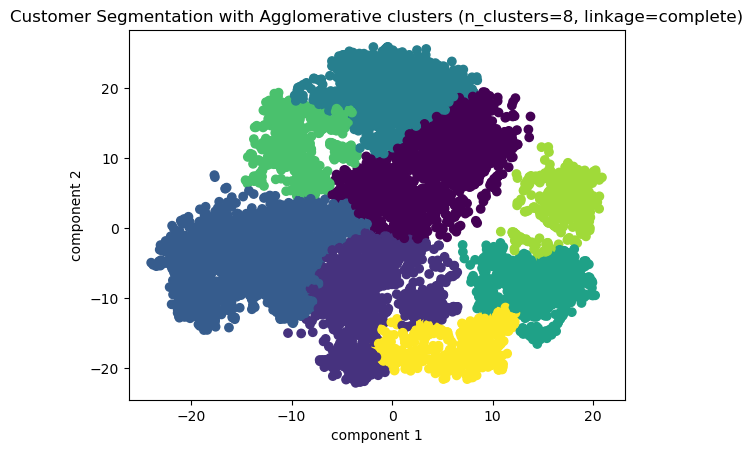

n_clusters=9, linkage=single   Agglomerative Clustering: -0.511385440826416


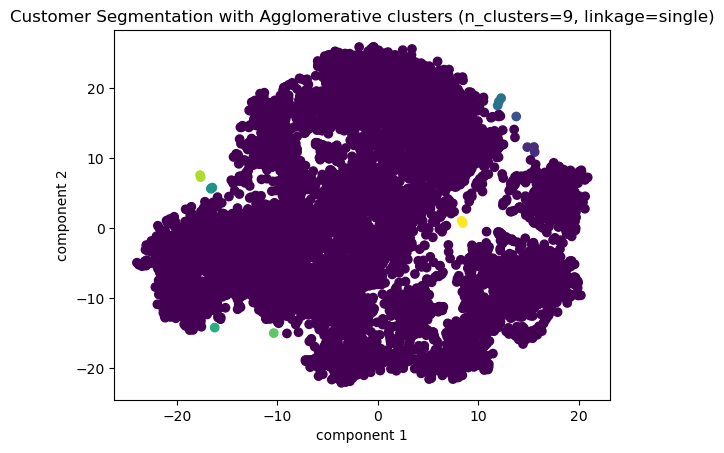

n_clusters=9, linkage=ward   Agglomerative Clustering: 0.36603590846061707


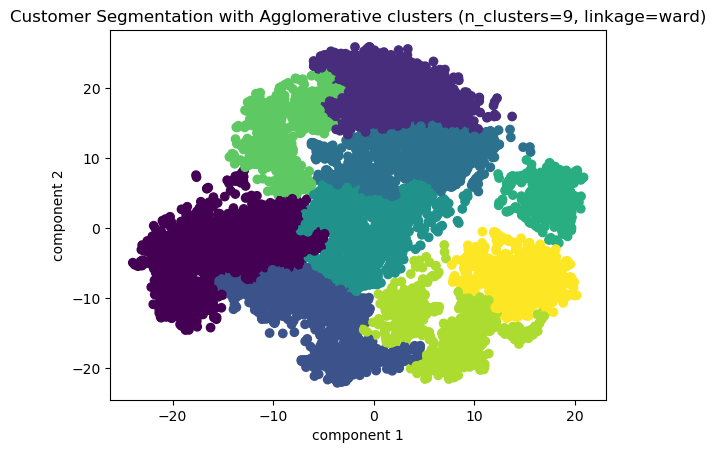

n_clusters=9, linkage=average   Agglomerative Clustering: 0.3526369333267212


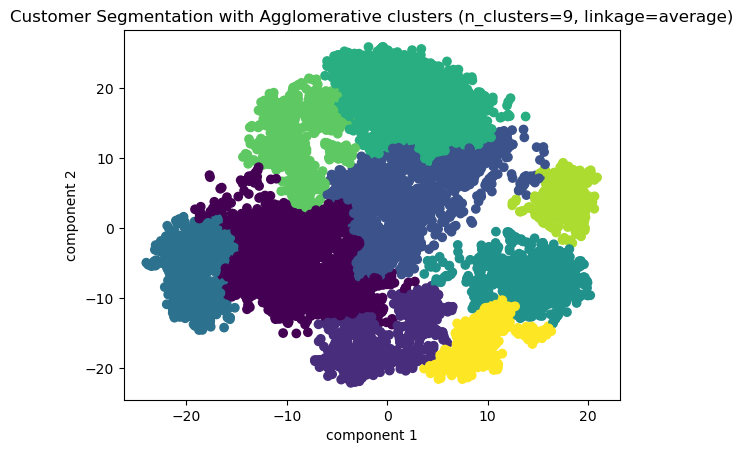

n_clusters=9, linkage=complete   Agglomerative Clustering: 0.36377862095832825


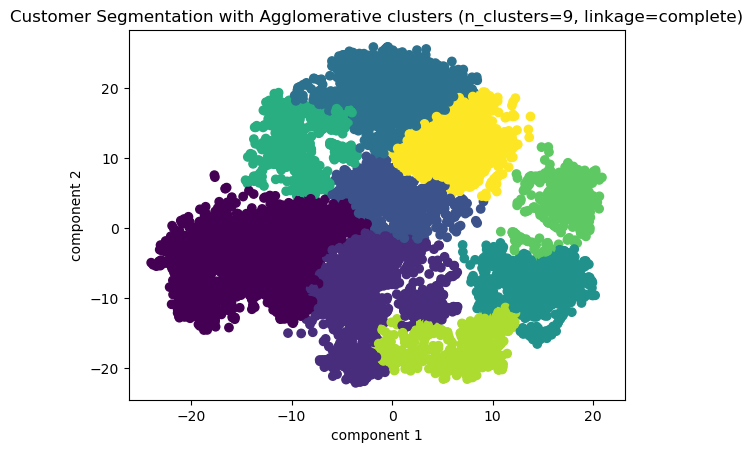

n_clusters=10, linkage=single   Agglomerative Clustering: -0.5562132000923157


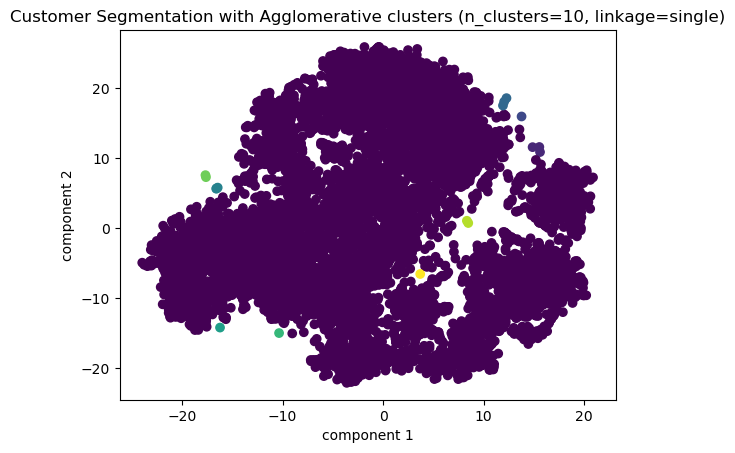

n_clusters=10, linkage=ward   Agglomerative Clustering: 0.357479453086853


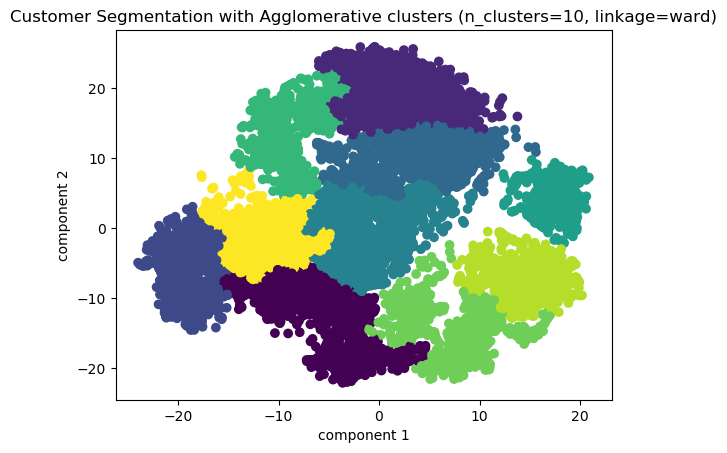

n_clusters=10, linkage=average   Agglomerative Clustering: 0.35839247703552246


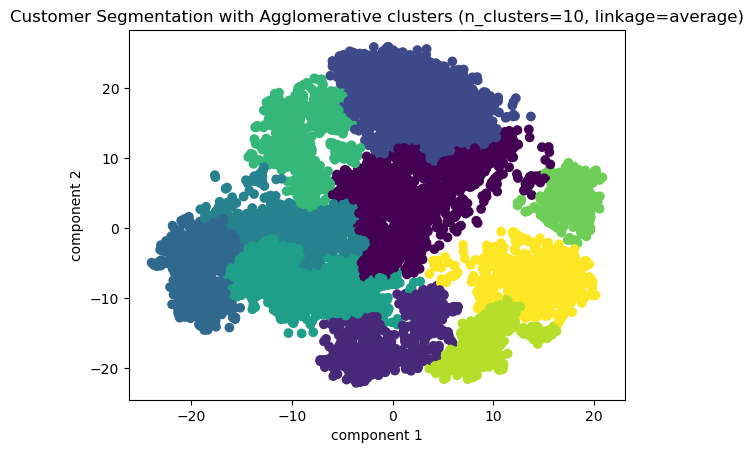

n_clusters=10, linkage=complete   Agglomerative Clustering: 0.3551463484764099


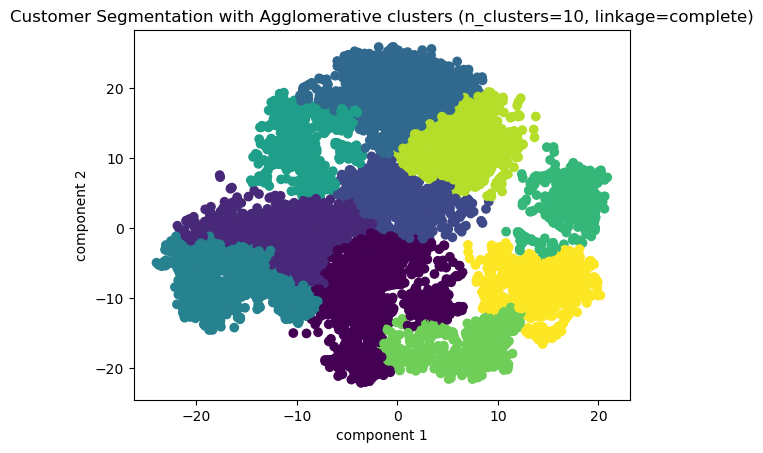

In [83]:
ac_list_tsne = []

for i in range (2,11):
    for linkage_method in ['single', 'ward', 'average', 'complete']:
        ac = AgglomerativeClustering(n_clusters=i, linkage=linkage_method)
        ac_clusters = ac.fit_predict(data_tsne)
        sil_score = silhouette_score(data_tsne, ac_clusters)
        print(f"n_clusters={i}, linkage={linkage_method}   Agglomerative Clustering: {sil_score}")
        
        ac_list_tsne.append((i, linkage_method, sil_score))

        plt.scatter(data_tsne.iloc[:,0],data_tsne.iloc[:,1], c = ac_clusters, cmap =None)
        plt.title(f"Customer Segmentation with Agglomerative clusters (n_clusters={i}, linkage={linkage_method})")
        plt.xlabel('component 1')
        plt.ylabel('component 2')
        plt.show()

df_ac_tsne = pd.DataFrame(ac_list_tsne, columns=['number_of_clusters', 'linkage_method', 'silhouette_score'])

In [84]:
df_ac_tsne.sort_values('silhouette_score', ascending=False).head()

,number_of_clusters,linkage_method,silhouette_score
5,3,ward,0.425726
6,3,average,0.421085
7,3,complete,0.414102
3,2,complete,0.403111
9,4,ward,0.381996


After comparing with the top five silhouette_score and the above plots, the linkage_method of **ward** with number_of_clusters of **3** has the best performance. The score is a better than the PCA method.

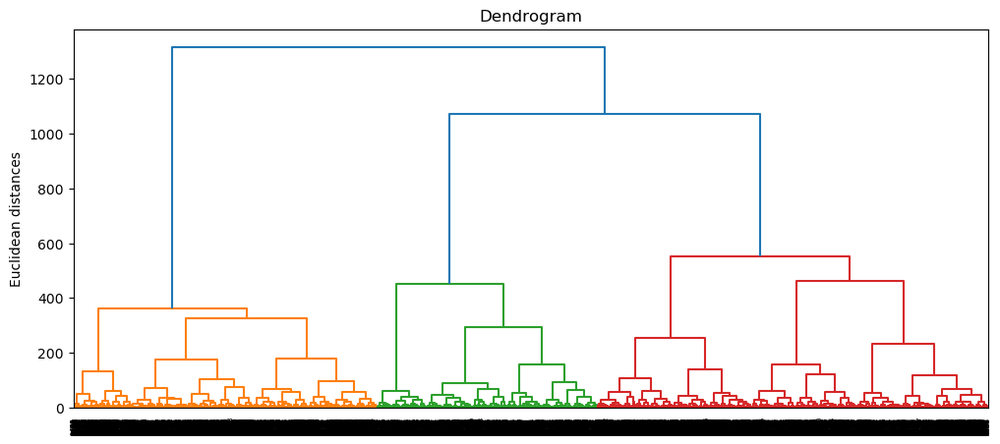

In [118]:
plt.figure(figsize=(12, 5))
dendrogram = sch.dendrogram(sch.linkage(data_tsne, method = 'ward'))
plt.title('Dendrogram')
plt.ylabel('Euclidean distances')
plt.show()

We can see that the Dendrogram of ward method from TSNE generated a clear relationship.

#### TSNE DBSCAN

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

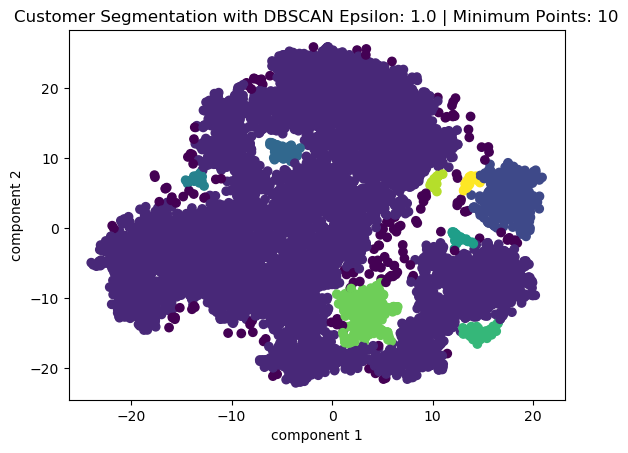

Silhouette Score:  -0.42703268


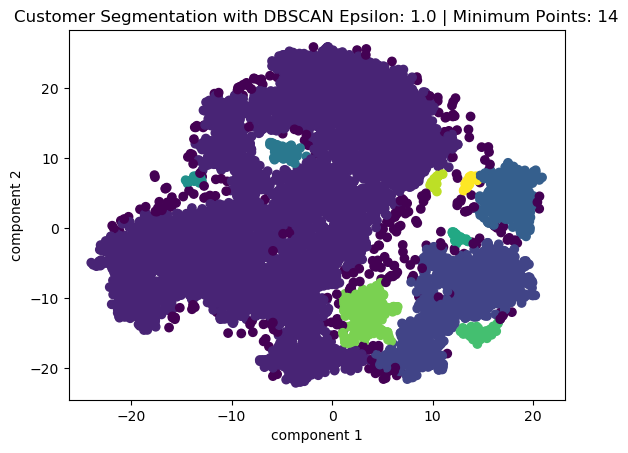

Silhouette Score:  -0.32993916


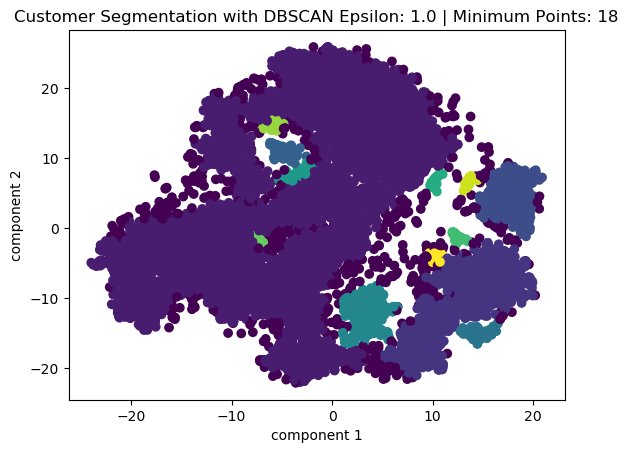

Silhouette Score:  -0.40936393


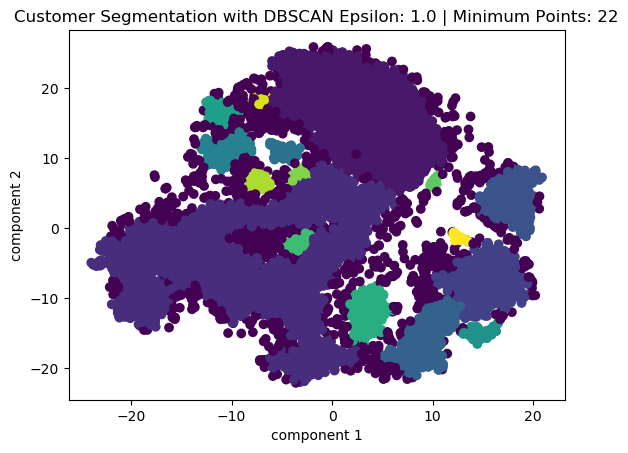

Silhouette Score:  -0.123597905


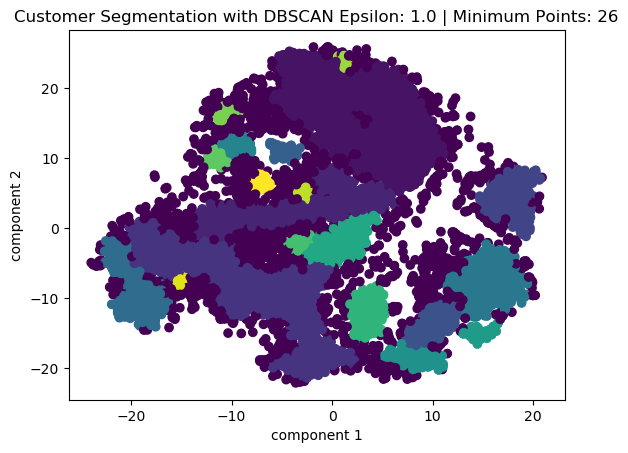

Silhouette Score:  -0.08758138


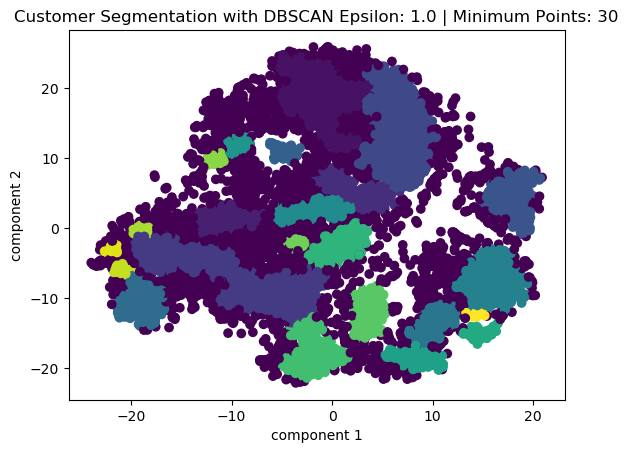

Silhouette Score:  0.032062296


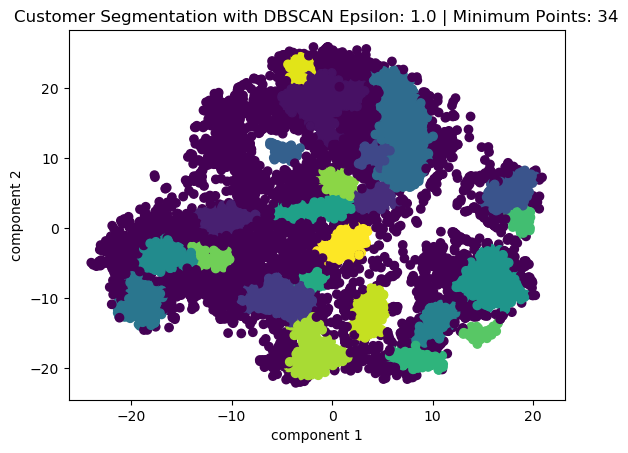

Silhouette Score:  -0.032074798


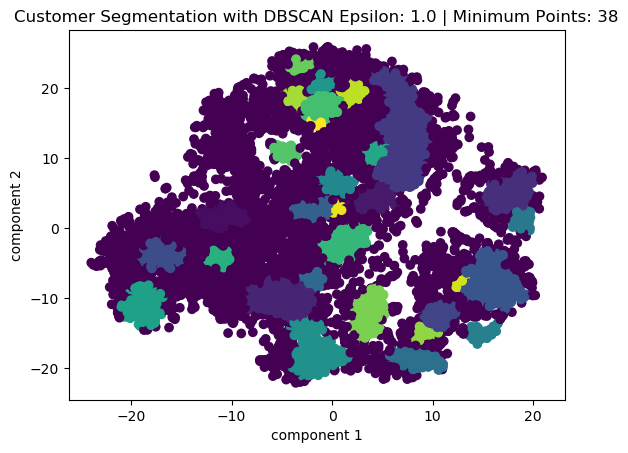

Silhouette Score:  -0.14196473


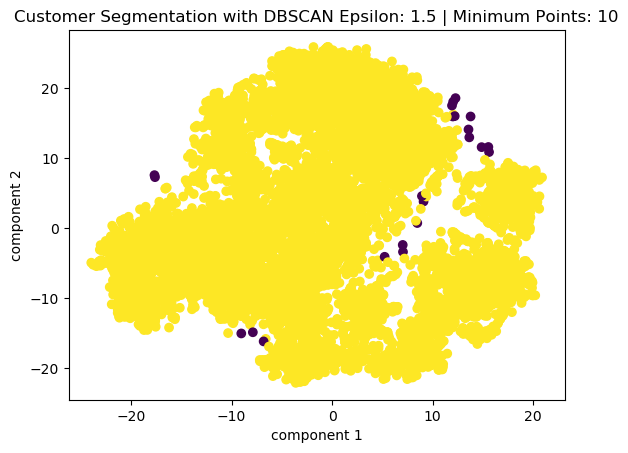

Silhouette Score:  0.03737406


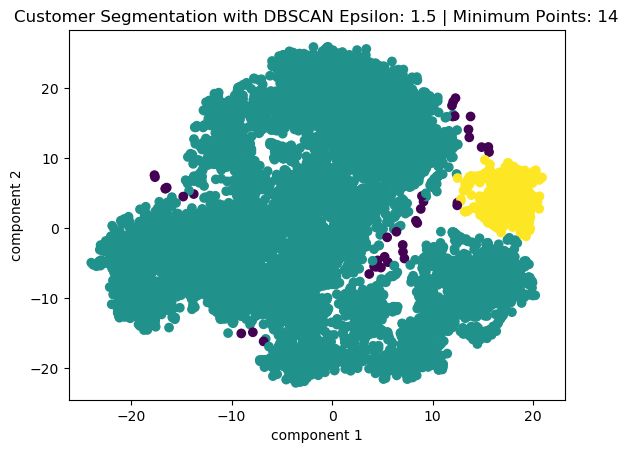

Silhouette Score:  -0.010809418


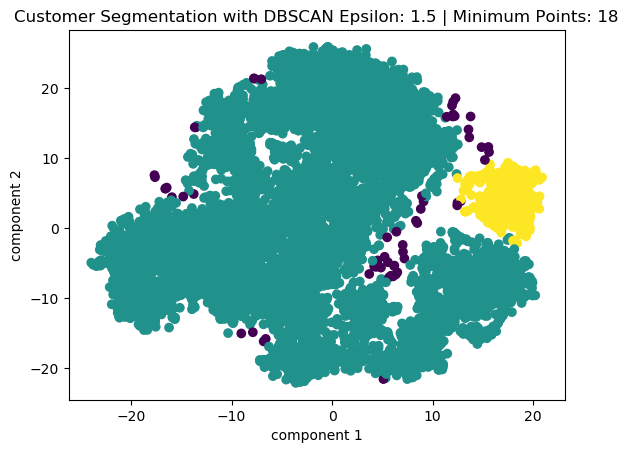

Silhouette Score:  -0.0060092383


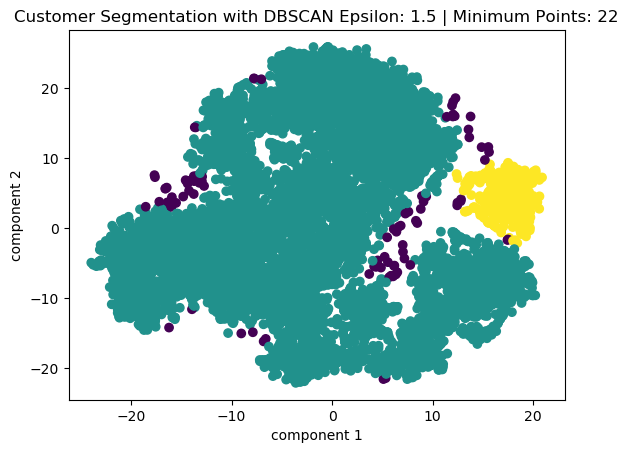

Silhouette Score:  -0.03272851


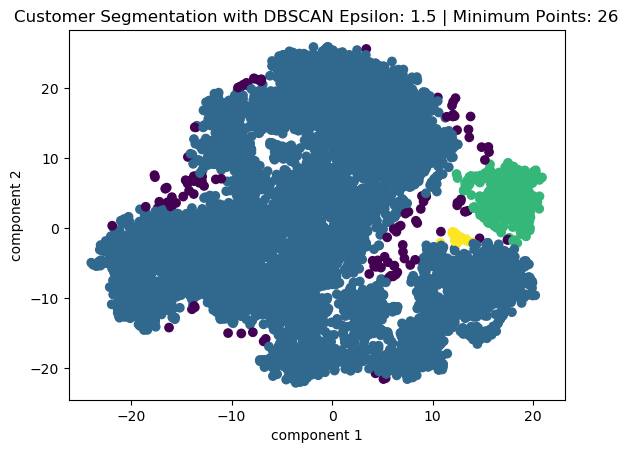

Silhouette Score:  -0.11420548


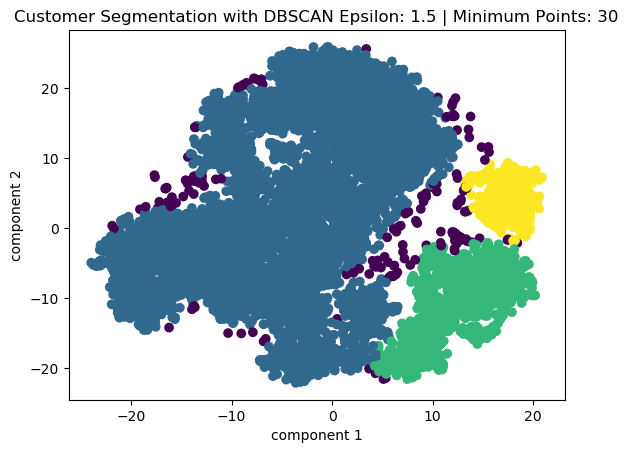

Silhouette Score:  0.11205335


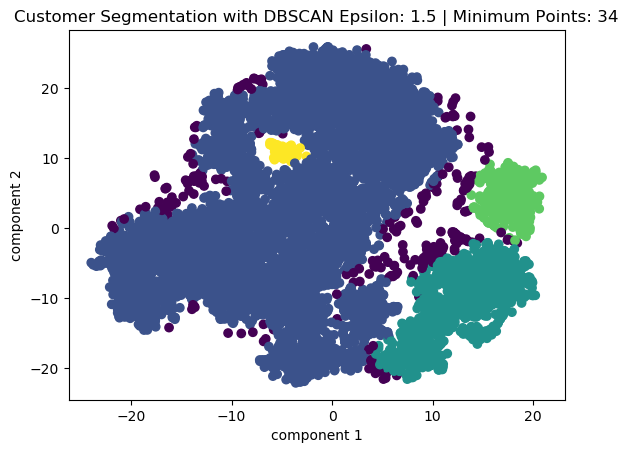

Silhouette Score:  -0.084032446


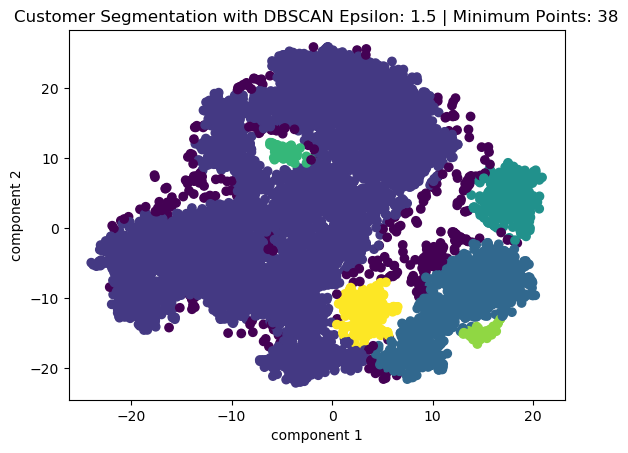

Silhouette Score:  -0.20862171


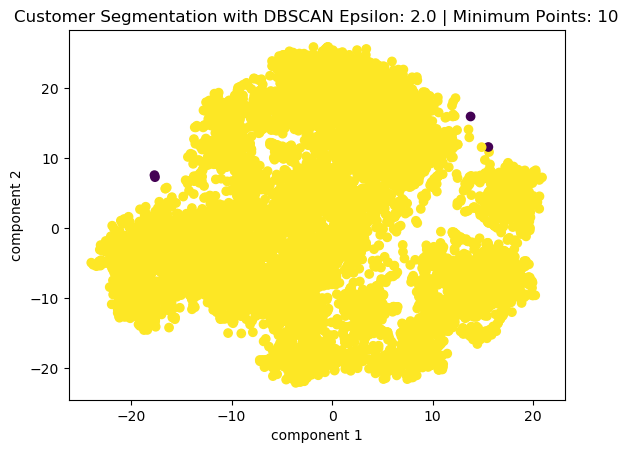

Silhouette Score:  0.10873683


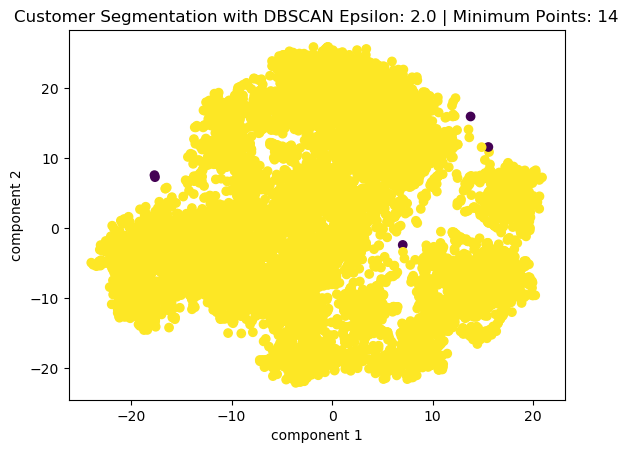

Silhouette Score:  0.06580043


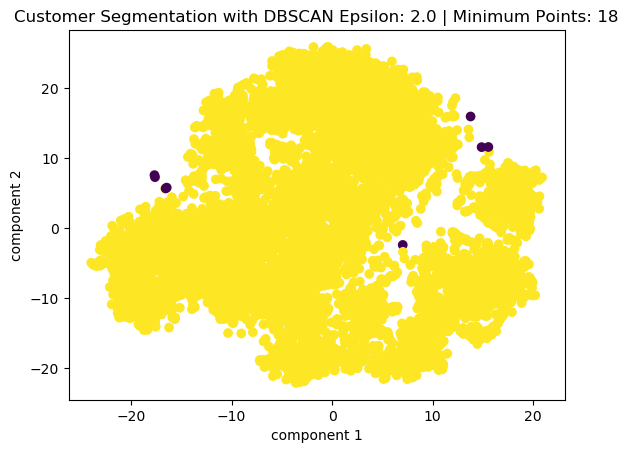

Silhouette Score:  0.06714135


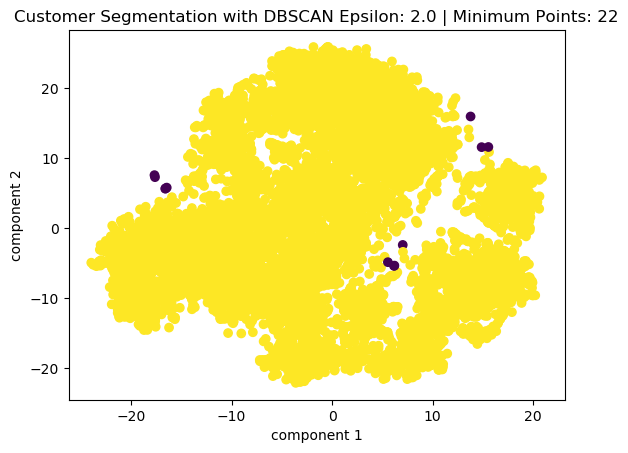

Silhouette Score:  0.018478423


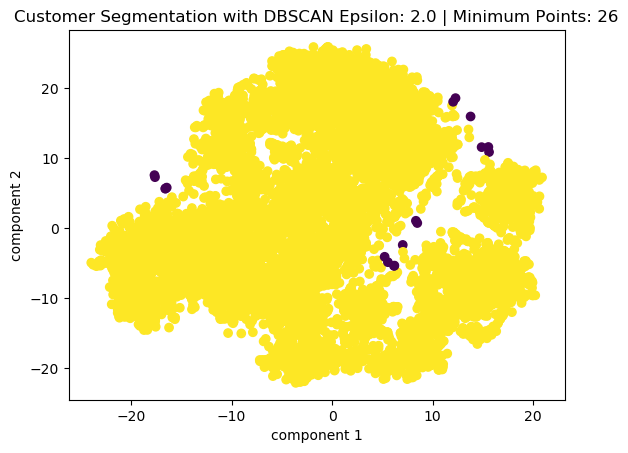

Silhouette Score:  0.008669822


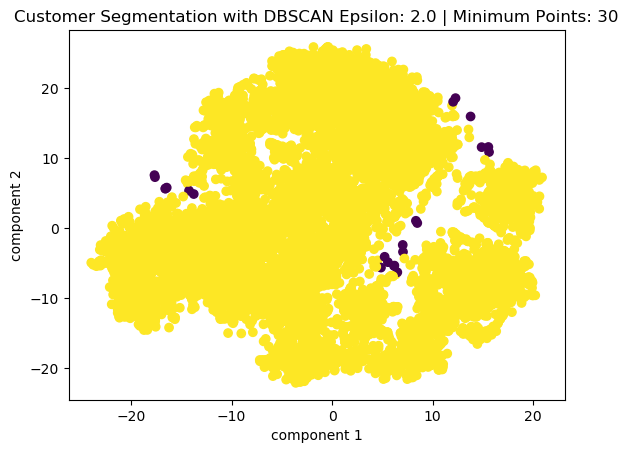

Silhouette Score:  -0.01404849


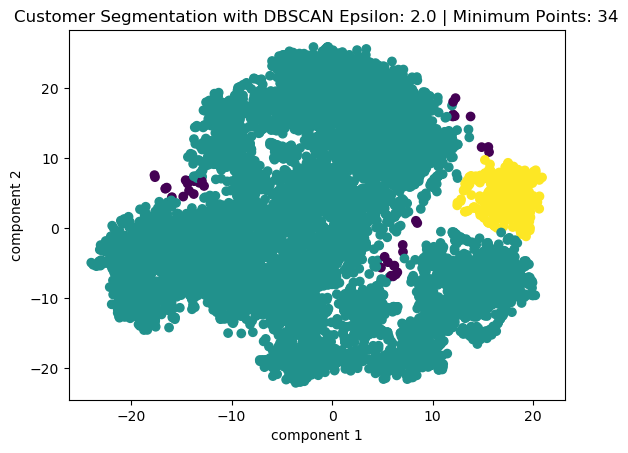

Silhouette Score:  -0.040791847


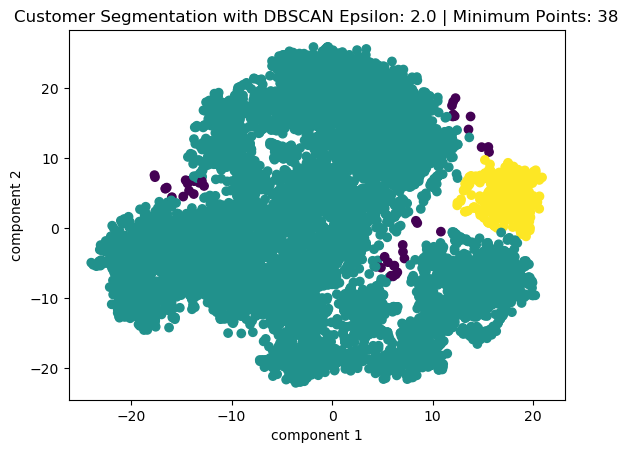

Silhouette Score:  -0.032392904


In [86]:
db_list_tsne = []

#Evaluate DBSCAN hyperparameters and their effect on the silhouette score
for ep in np.arange(1.0, 2.5, 0.5):
    for min_sample in range(10, 40, 4):
        db = DBSCAN(eps=ep, min_samples = min_sample)
        db_clusters = db.fit_predict(data_tsne)
        sil_score = silhouette_score(data_tsne, db_clusters)
        db_list_tsne.append((ep, min_sample, sil_score, len(set(db.labels_))))

        plt.scatter(data_tsne.iloc[:,0],data_tsne.iloc[:,1], c = db_clusters, cmap =None)
        plt.title('Customer Segmentation with DBSCAN Epsilon: ' + str(ep) + ' | Minimum Points: ' + str(min_sample))
        plt.xlabel('component 1')
        plt.ylabel('component 2')
        plt.show()

        print("Silhouette Score: ", sil_score)

df_db_tsne = pd.DataFrame(db_list_tsne, columns=['Epsilon', 'Minimum Sample', 'Silhouette Score', 'Number of clusters'])

In [87]:
df_db_tsne.sort_values(by=['Silhouette Score'], ascending=False).head()

,Epsilon,Minimum Sample,Silhouette Score,Number of clusters
13,1.5,30,0.112053,4
16,2.0,10,0.108737,2
18,2.0,18,0.067141,2
17,2.0,14,0.065800,2
8,1.5,10,0.037374,2


From the above table, we can see that the silhouette scores are low with tsne. 

### Discussion

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)

Let's create a summary table with the best silhouette_score from each method.

|Model | # of clusters | linkage_method | eps | min_samples | silhouette_score |
|-----: | :-: |:-: |:-: |:-: |:-: |
| kmean | 3	| - | - | - | 0.2505 |
| ac | 2 | complete| - | -| 0.7865 |
| dbscan | 2 | - | 2.5 | 10 | 0.5541 | 
| km_pca_2 | 2 | - | - | - | 0.4648 | 
| <strong>km_pca_3</strong> | <strong>3</strong> | <strong>-</strong> | <strong>-</strong> | <strong>-</strong> | <strong>0.4523</strong> | 
| ac_pca | 4 | ward | - | - | 0.3813 | 
| dbscan_pca | 2 | - | 2.5	 | 18 | 0.8192 | 
| km_tsne | 3 | - | - | - | 0.4468 | 
| ac_tsne | 3 | ward | - | - | 0.4257 | 
| dbscan_tsne | 4 | - | 1.5	 | 30 | 0.1121 | 

From the table above, the silhouette score is highest when the number of clusters is equal to two. However, after comparing with the plots that we generated before, 3 clusters can help us get better insights from the data. Moreover, most methods with 3 clusters are able to generate a desired silhouette_score. Since the model **km_pca_3** has the highest silhouette_score, it is chosen to be the best model from the above analysis. The silhouette score of 0.4523 is desirable. 

Let's visualize the detail performance of the model **km_pca_3**.

In [88]:
km_pca_3

array([0, 2, 0, ..., 0, 0, 0])

The clusters are labelled as 0, 1, and 2. 

In [89]:
print(f"k=3 K-Means Clustering: {silhouette_score(data_pca2, km_pca_3)}")

k=3 K-Means Clustering: 0.45231837920227425


Using PCA to visualization pca scaled data with k-means of n_clusters=3.

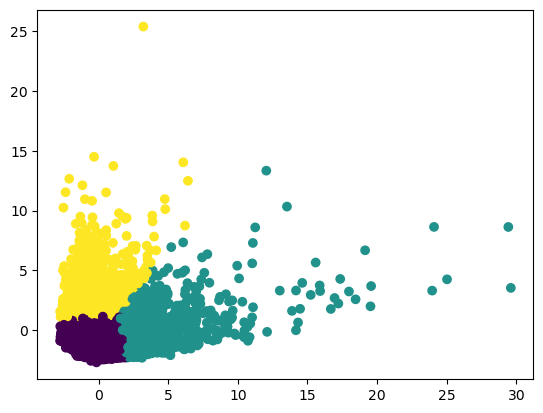

In [119]:
plt.scatter(data_pca2.iloc[:,0],data_pca2.iloc[:,1], c = km_pca_3, cmap =None) 
plt.show()

Using TSNE to visualization pca scaled data with k-means of n_clusters=3:

k=3 K-Means Clustering: 0.45231837920227425


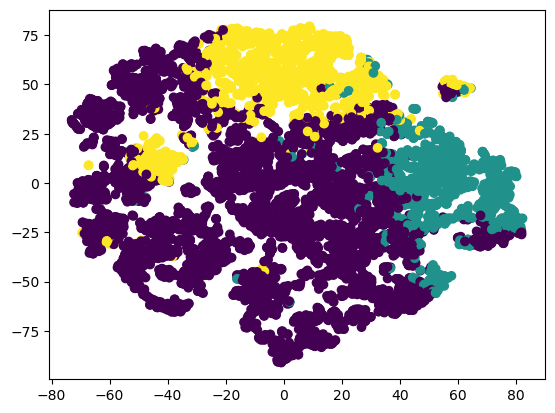

In [78]:
km_pca_3 = KMeans(3).fit_predict(data_pca2)
print(f"k=3 K-Means Clustering: {silhouette_score(data_pca2, km_pca_3)}")
#labels_km_pca_3 = km_pca_3.labels_
plt.scatter(data_tsne.iloc[:,0],data_tsne.iloc[:,1], c = km_pca_3, cmap =None) 
plt.show()

Create a new dataframe to combine clusters with the original data.

In [90]:
df_km_pca_3 = pd.concat([df.reset_index(drop=True), pd.DataFrame({'cluster':km_pca_3}).reset_index(drop=True)], axis=1)

In [91]:
df_km_pca_3

,BALANCE,BALANCE_FREQUENCY,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,PURCHASES_FREQUENCY,ONEOFF_PURCHASES_FREQUENCY,PURCHASES_INSTALLMENTS_FREQUENCY,CASH_ADVANCE_FREQUENCY,CASH_ADVANCE_TRX,PURCHASES_TRX,CREDIT_LIMIT,PAYMENTS,MINIMUM_PAYMENTS,PRC_FULL_PAYMENT,TENURE,cluster
0,40.900749,0.818182,95.40,0.00,95.40,0.000000,0.166667,0.000000,0.083333,0.000000,0,2,1000.0,201.802084,139.509787,0.000000,12,0
1,3202.467416,0.909091,0.00,0.00,0.00,6442.945483,0.000000,0.000000,0.000000,0.250000,4,0,7000.0,4103.032597,1072.340217,0.222222,12,2
2,2495.148862,1.000000,773.17,773.17,0.00,0.000000,1.000000,1.000000,0.000000,0.000000,0,12,7500.0,622.066742,627.284787,0.000000,12,0
3,1666.670542,0.636364,1499.00,1499.00,0.00,205.788017,0.083333,0.083333,0.000000,0.083333,1,1,7500.0,0.000000,864.304943,0.000000,12,0
4,817.714335,1.000000,16.00,16.00,0.00,0.000000,0.083333,0.083333,0.000000,0.000000,0,1,1200.0,678.334763,244.791237,0.000000,12,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8944,28.493517,1.000000,291.12,0.00,291.12,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,325.594462,48.886365,0.500000,6,0
8945,19.183215,1.000000,300.00,0.00,300.00,0.000000,1.000000,0.000000,0.833333,0.000000,0,6,1000.0,275.861322,864.304943,0.000000,6,0
8946,23.398673,0.833333,144.40,0.00,144.40,0.000000,0.833333,0.000000,0.666667,0.000000,0,5,1000.0,81.270775,82.418369,0.250000,6,0
8947,13.457564,0.833333,0.00,0.00,0.00,36.558778,0.000000,0.000000,0.000000,0.166667,2,0,500.0,52.549959,55.755628,0.250000,6,0


Use countplot to count number of data within that cluster.

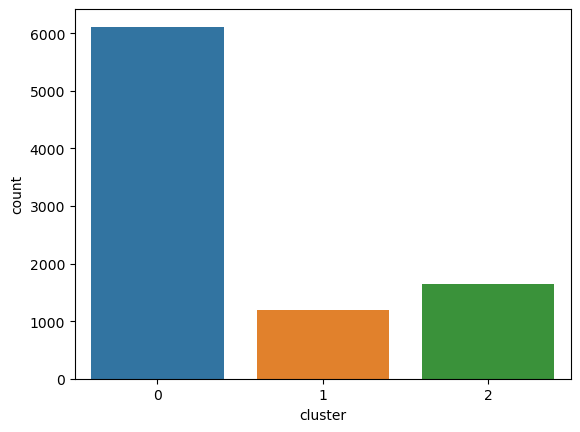

In [92]:
sns.countplot(x='cluster', data=df_km_pca_3)

There are larger amounts of custome are in cluster 0. 

Let's create some plots to see the distribution of different features for each cluster.

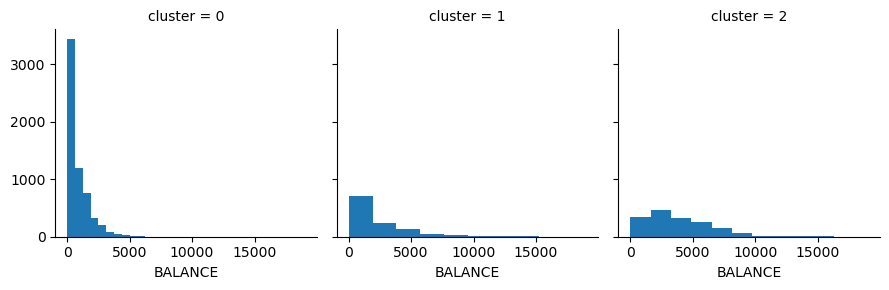

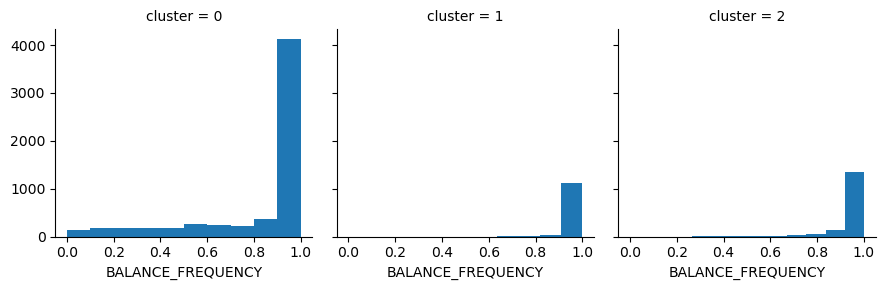

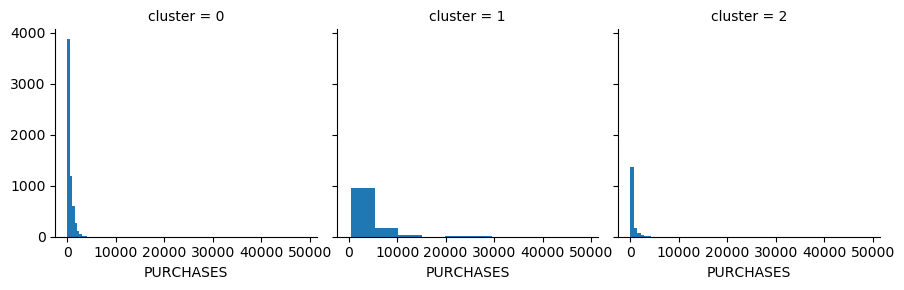

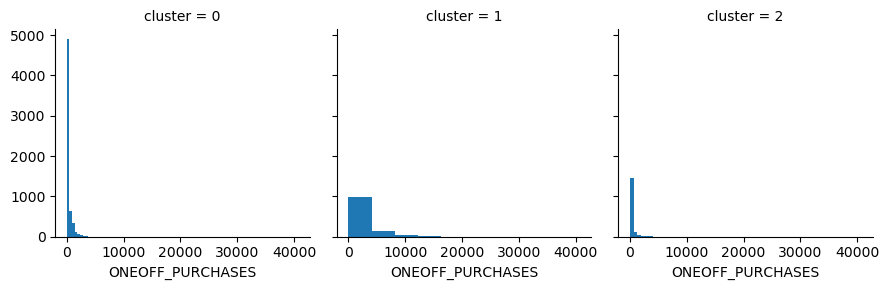

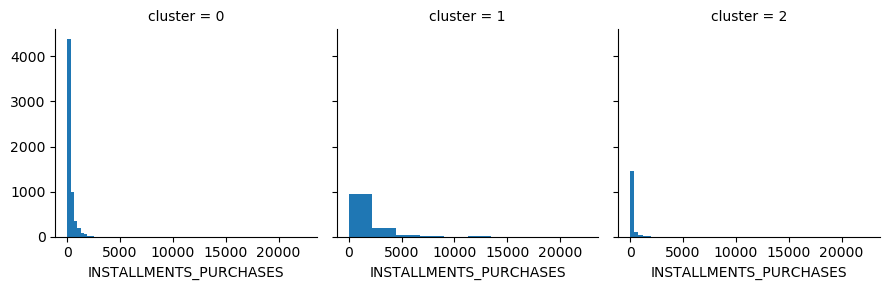

...

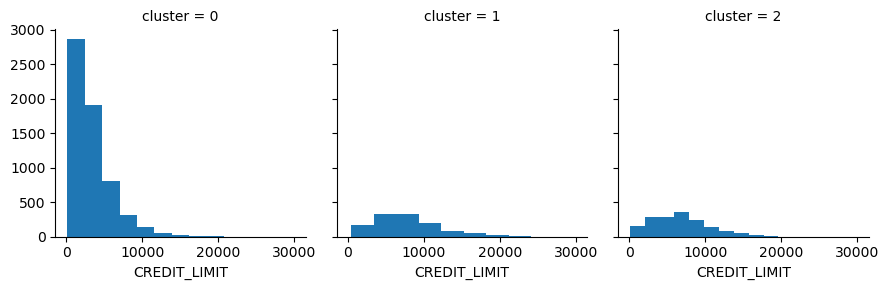

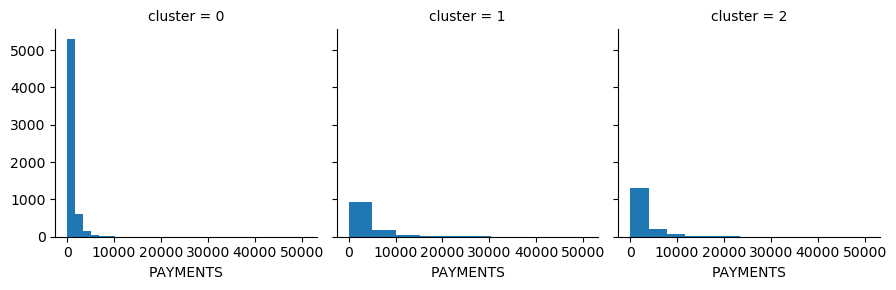

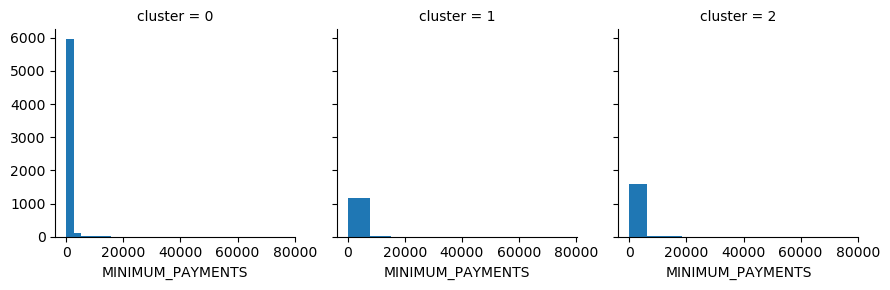

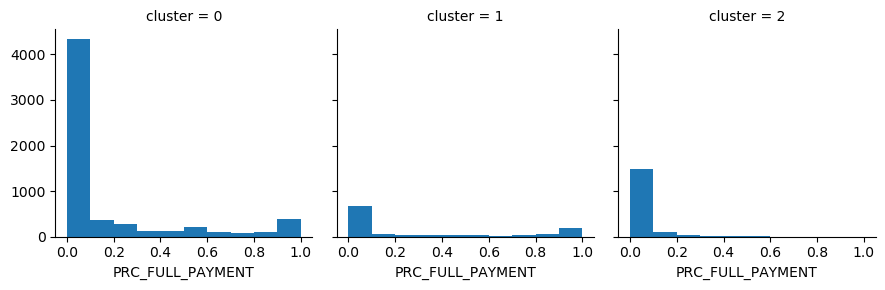

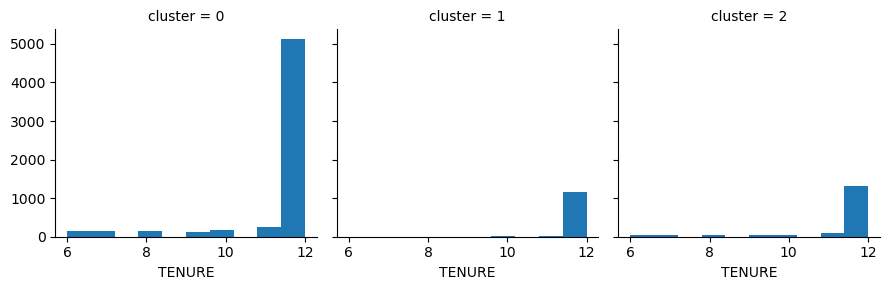

In [93]:
for c in df_km_pca_3.drop(['cluster'],axis=1):
    grid= sns.FacetGrid(df_km_pca_3, col='cluster')
    grid= grid.map(plt.hist, c)
plt.show()

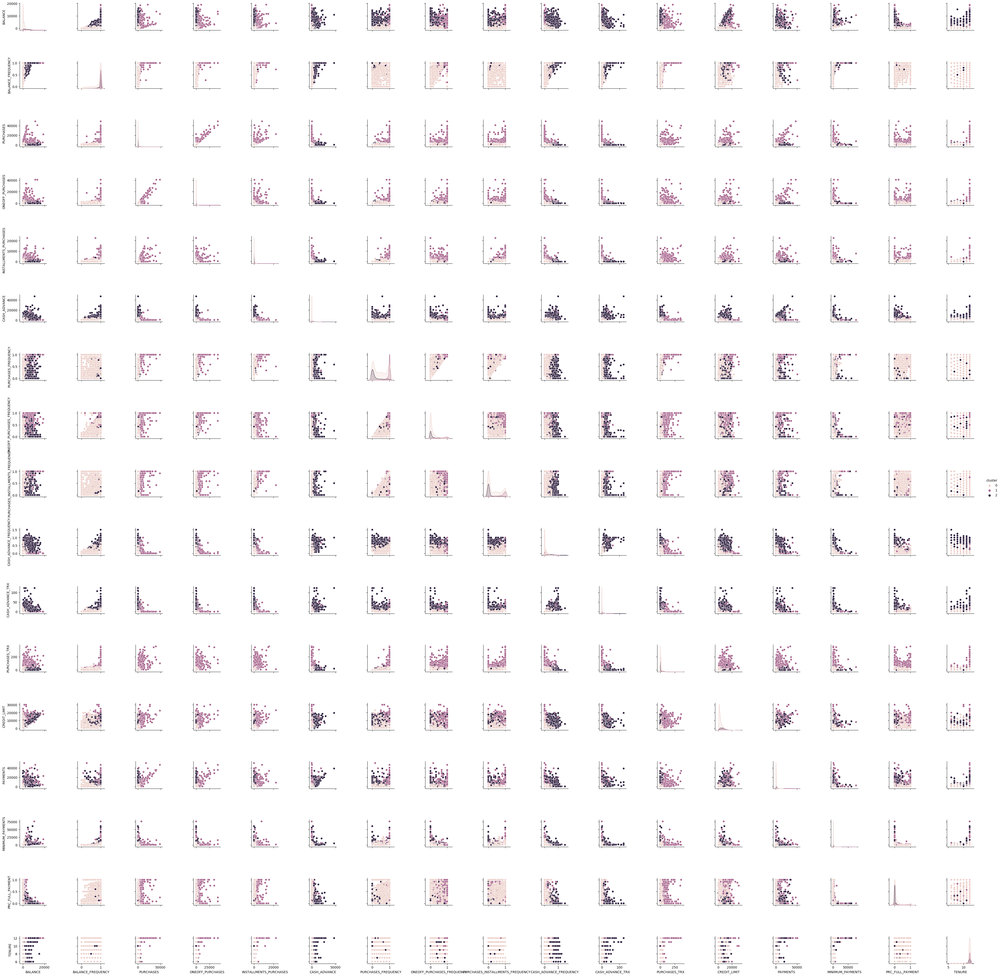

In [94]:
sns.pairplot(df_km_pca_3, hue="cluster")

Create plots focus on the important features.

In [102]:
df_km_pca_3_tmp = df_km_pca_3[['BALANCE', 'PURCHASES', 'ONEOFF_PURCHASES', 'INSTALLMENTS_PURCHASES', 'CASH_ADVANCE', 'CREDIT_LIMIT', 'PAYMENTS', 'cluster']]
df_km_pca_3_tmp.head()

,BALANCE,PURCHASES,ONEOFF_PURCHASES,INSTALLMENTS_PURCHASES,CASH_ADVANCE,CREDIT_LIMIT,PAYMENTS,cluster
0,40.900749,95.40,0.00,95.4,0.000000,1000.0,201.802084,0
1,3202.467416,0.00,0.00,0.0,6442.945483,7000.0,4103.032597,2
2,2495.148862,773.17,773.17,0.0,0.000000,7500.0,622.066742,0
3,1666.670542,1499.00,1499.00,0.0,205.788017,7500.0,0.000000,0
4,817.714335,16.00,16.00,0.0,0.000000,1200.0,678.334763,0


In [103]:
df_km_pca_3_tmp2 = pd.melt(df_km_pca_3_tmp, id_vars='cluster', var_name="value_name", value_name="value")
df_km_pca_3_tmp2.head()

,cluster,value_name,value
0,0,BALANCE,40.900749
1,2,BALANCE,3202.467416
2,0,BALANCE,2495.148862
3,0,BALANCE,1666.670542
4,0,BALANCE,817.714335


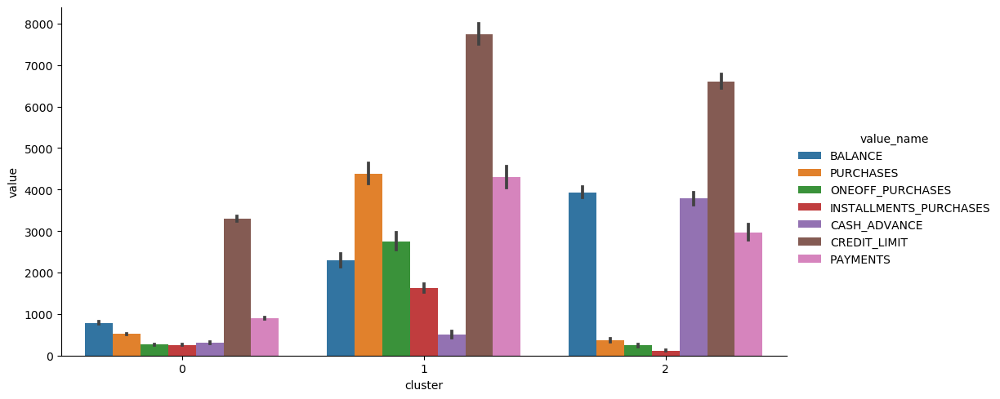

In [108]:
sns.catplot(data=df_km_pca_3_tmp2, x="cluster", y="value", hue="value_name", kind='bar', height=5, aspect=2)

Let's create a summary table for these three customer group:

|Cluster | Balance | Purchases | Oneoff_purchases | Installments Purchases | Cash Advance | Credit_limit | Payments | Insurance Product Recommendation |
|:-----: | :-: |:-: |:-: |:-: |:-: |:-: |:-: | :-: |
| Cluster 0 | low	| low | low | low | low | low | low | <strong> Saving Plan</strong> |
| Cluster 1 | medium | high| high | high | low | high | high | <strong> Wealth Management </strong> |
| Cluster 2 | high | low | low | low | high | high | high | <strong> Loan </strong> |

**Recommendation:**<br>

**Cluster 0:** Customers who have low balances, low credit limits, and low purchases. These customers could be low-income and don't likely spend too much on purchasing goods. We should offer a **saving plan** for them. <br>
**Cluster 1:** Customers who have high credit limits, high purchases, low cash advance, and high payments. These customers could be medium and high-income customers who are able to pay for their credit cards on time. They don't use cash advance too often; therefore, we should offer a **wealth management plan** for this group of customers. <br>
**Cluster 2:** Customers who have a high balance, low purchase, high cash advance, high credit limit, and high payments. Customers who use cash advance a lot is more likely to need a loan. Therefore, we should  offer a **loan plan** for this group of customers

### Conclusion

The study explored a range of different clustering algorithms such as k-means, hierarchical clustering, and DBSCAN. Standardization is useful for unsupervised models that require distance metrics. Different hyperparameters are evaluated with the silhouette score. The silhouette score is a metric that helps evaluate the performance of unsupervised learning methods. PCA and TSNE are methods used for dimensionality reduction and visualization in the project. After comparing with the silhouette score and visualized plots, '3' is the optimal number of clusters for the dataset. The PCA scaled data that used the k-means method with a k value of three is the optimal choice. 

Based on the above analysis, customers can be divided into three groups. The first group of customers are low-incomers and small spenders; therefore, a saving plan is recommended for this group. The second group of customers are able to pay for credit cards on time and don't like to use cash advance so the company should offer a wealth management plan for this group. The last group of customers who use cash advance a lot are more likely to accept a loan plan from the insurance company. 

[Return to top](#Final-Project:-Applied-Unsupervised-Learning)